In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# 1. Importing Important Libraries

In [1]:
import torch
from torch.utils.data import Dataset,DataLoader
from torch import nn

#!pip install -q piq
import piq

import torchvision
from torchvision import transforms
from torchvision.utils import make_grid

import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
from tqdm import tqdm

torch.__version__

'2.6.0+cu124'

# 2. Custom Dataset

In [2]:
root_dir = Path('/kaggle/input/insat-downsampled-spatial-resolution-16-km/downsampled_june_tir1_all_data_factor_4.npy')
root_dir.exists()

True

In [3]:
imgs = np.load(root_dir)

In [4]:
imgs.min()

179.85948

In [5]:
l = [img for img in imgs]
type(l)

list

In [6]:
imgs.shape

(100, 404, 434)

In [ ]:
class DatasetAutoencoder(Dataset):
    def __init__(self, root_dir : Path, transform = None):
        assert root_dir.exists(), 'Invalid Data Location Passed'
        self.root_dir = root_dir
        self.transform = transform
        data_batched = np.load(root_dir) # 100 x 404 x 434
        self.data = [torch.tensor(frame).unsqueeze(dim = 0) for frame in data_batched]
    def __getitem__(self,index):
        frame = self.data[index]
        if self.transform:
            frame = self.transform(frame)
        
        return frame
    def __len__(self):
        return len(self.data)

In [8]:
DatasetAutoencoder(root_dir).data[0].shape

torch.Size([1, 404, 434])

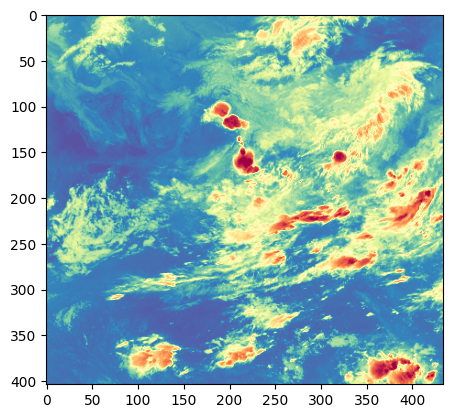

In [9]:
data = DatasetAutoencoder(root_dir).data[0]
plt.imshow(data.permute(1,2,0), cmap = 'Spectral')
plt.show()

# 3. Defining Transforms and DataLoader

In [10]:
x_max = 333.50464
x_min = 179.85948

normalize = transforms.Lambda(
    lambda x: ((x - x_min) / (x_max - x_min)) * 2 - 1
)


In [11]:
x_max,x_min

(333.50464, 179.85948)

In [12]:
transform = transforms.Compose(
    [
        # transforms.ToTensor()
        #transforms.Resize((512,512)), #affects spatial resolution
        #normalize,
        normalize,
        transforms.Pad(padding = (39,54,39,54),fill = 0, padding_mode = 'constant' ), # 404 x 434 -> 512 x 512
        # transforms.Normalize(std = 0.5, mean = 0.5)
       
    ]
)

root_dir = Path('/kaggle/input/insat-downsampled-spatial-resolution-16-km/downsampled_june_tir1_all_data_factor_4.npy')
assert root_dir.exists(), 'Invalid Path'

data = DatasetAutoencoder(root_dir,transform)

loader = DataLoader(
    dataset = data,
    batch_size = 8,
    shuffle = True,
    num_workers = 0,
)

len(loader)

13

In [13]:
for i in data:
    print(i.min(),i.max())
    break

tensor(-1.) tensor(0.5694)


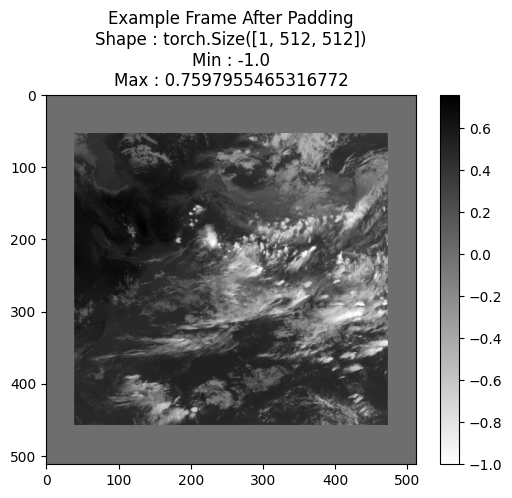

In [14]:
plt.imshow(data[25].permute(1,2,0), cmap = 'binary')

plt.title(f'Example Frame After Padding\nShape : {data[25].shape}\nMin : {data[25].min()}\nMax : {data[25].max()}')
plt.colorbar()
plt.show()

# 4. Visualization

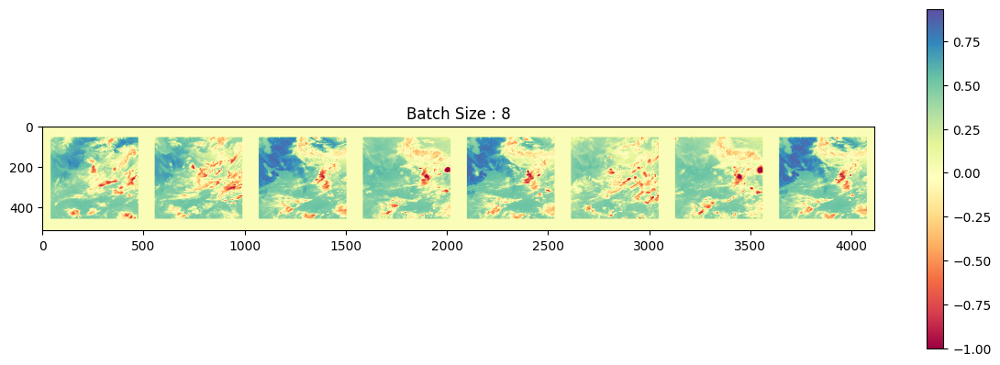

In [15]:
x = next(iter(loader))
plt.figure(figsize = (12,4))
plt.imshow(make_grid(x)[0], cmap = "Spectral")

plt.tight_layout()
plt.colorbar()
plt.title(f'Batch Size : {len(x)}')
plt.show()

# 5. Model Building
<p style="font-size:21px;">
    1. There must be a fine balance between latent space dimension and reconstruction quality
    <br>
    2. We have inputs that are normalized between -1 1 and follows a shape of 1 x 512 x 512
</p>

In [27]:
def train(model_class, 
          loader, 
          logs_store : Path = 'logs_store.csv',
          metrics = ['MAE','PSNR', 'SSIM'],
          loss_fns = [(nn.MSELoss(),1)], 
          h_params = { 'EPOCHS' : 10,'lr' : 0.001,'weight_decay' : 1e-4},
          save_loc = 'model_autoencoder.pth'):
    
    """Simple training function that handles visualization and can be used for multiple model classes"""
    
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    metric_df = pd.DataFrame(columns = metrics)
    print(f'🟩 Using {device}')
    EPOCHS = h_params['EPOCHS']
    model = model_class().to(device)
    
    optimizer = torch.optim.Adam(
        params = model.parameters(),
        lr = h_params['lr'],
        weight_decay = h_params['weight_decay'],
    )

    for epoch in range(EPOCHS):
        loss_tot = 0
        model.train()
        for X in tqdm(loader, desc = f'{epoch}/{EPOCHS}'):
            X = X.to(device)
            y_pred = model(X)[0]
            net_loss = sum([loss_fn[0](y_pred,X)*loss_fn[1] for loss_fn in loss_fns])
            optimizer.zero_grad()
            net_loss.backward()
            optimizer.step()
            loss_tot += net_loss.item()
        print(f'Epoch : {epoch}\nLoss : {loss_tot/len(loader)}')
        model.eval()
        
        mae_tot, psnr_tot, ssim_tot = 0, 0, 0

        with torch.no_grad():
            for X in loader:
                X = X.to(device)
                y_pred = model(X)[0]

                # Convert [-1,1] → [0,1] for PSNR & SSIM
                y_pred_n = (y_pred + 1) / 2
                X_n = (X + 1) / 2

                mae_tot += torch.mean(torch.abs(y_pred - X)).item()
                psnr_tot += piq.psnr(y_pred_n, X_n, data_range=1.0).item()
                ssim_tot += piq.ssim(y_pred_n, X_n, data_range=1.0).item()

        mae_avg = mae_tot / len(loader)
        psnr_avg = psnr_tot / len(loader)
        ssim_avg = ssim_tot / len(loader)
        
        metric_df.loc[len(metric_df)] = [mae_avg, psnr_avg, ssim_avg]
        print(f"✅ Epoch {epoch} Metrics → MAE: {mae_avg:.6f}, PSNR: {psnr_avg:.4f}, SSIM: {ssim_avg:.4f}\n")
        visualization(model, loader, loss_fns, 3)

        torch.save(model.state_dict(), save_loc)

    metric_df.to_csv(logs_store,index = False)
    print(metric_df)
    return model, metric_df


def visualization(model, loader, loss_fns, n_samples=8):
    model.eval()
    device = next(model.parameters()).device
    
    loss_names = " + ".join([lf[0].__class__.__name__ for lf in loss_fns])
    
    fig, axs = plt.subplots(n_samples, 2, figsize=(12, n_samples * 2))
    axs = axs if n_samples > 1 else [axs]
    
    shown = 0
    with torch.no_grad():
        for X in loader:
            X = X.to(device)  # X shape: (B, C, H, W)
            output = model(X)
            y_pred = output[0]
            for i in range(X.size(0)):
                if shown >= n_samples:
                    break
                    
                orig = X[i].detach().cpu().numpy()
                recon = y_pred[i].detach().cpu().numpy()
                
                # Convert (C, H, W) -> (H, W) for grayscale
                if orig.ndim == 3 and orig.shape[0] == 1:
                    orig = orig[0]
                if recon.ndim == 3 and recon.shape[0] == 1:
                    recon = recon[0]
                
                # Original image
                axs[shown][0].imshow(orig, cmap="Spectral")  # Changed to Spectral to match your data
                axs[shown][0].set_title("Original")
                axs[shown][0].axis("off")
                
                # Reconstructed image
                axs[shown][1].imshow(recon, cmap="Spectral")  # Changed to Spectral to match your data
                axs[shown][1].set_title(f"Reconstructed\n({loss_names})")
                axs[shown][1].axis("off")
                
                shown += 1
                
            if shown >= n_samples:
                break
    
    plt.tight_layout()
    plt.show()


def plot_metrics(metric_df):
    epochs = metric_df.index + 1

    plt.figure(figsize=(15, 4))

    # ---- MAE ----
    plt.subplot(1, 3, 1)
    plt.plot(epochs, metric_df['MAE'], color='red', marker='o', linewidth=1.5)
    plt.title('MAE vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('MAE')
    plt.grid(True, alpha=0.3)

    # ---- PSNR ----
    plt.subplot(1, 3, 2)
    plt.plot(epochs, metric_df['PSNR'], color='blue', marker='o', linewidth=1.5)
    plt.title('PSNR vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('PSNR (dB)')
    plt.grid(True, alpha=0.3)

    # ---- SSIM ----
    plt.subplot(1, 3, 3)
    plt.plot(epochs, metric_df['SSIM'], color='green', marker='o', linewidth=1.5)
    plt.title('SSIM vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('SSIM')
    plt.ylim(0, 1.0)  # SSIM always in [0,1]
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()


In [28]:
class EncoderBlock(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size = 3, padding = 1, stride = 2), # 64 x 256 x 256
            nn.ReLU(),

            nn.Conv2d(64, 128, kernel_size = 3, padding = 1, stride = 2), # 128 x 128 x 128
            nn.ReLU(),
        )
    def forward(self,x):
        return self.encoder(x)

class DecoderBlock(nn.Module):
    def __init__(self, latent_ch : int = 4):
        super().__init__()
        self.decoder = nn.Sequential(
                nn.ConvTranspose2d(latent_ch, 128, kernel_size=3, stride=2, padding=1, output_padding=1),  # 128 x 128 x 128
                nn.ReLU(),
        
                nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),   # 64 x 256 x 256
                nn.ReLU(),
        
                nn.ConvTranspose2d(64, 1, kernel_size=3, stride=2, padding=1, output_padding=1),     # 1 x 512 x 512
                nn.Tanh())
    def forward(self, z):
        return self.decoder(z)

## 5.1 Convolutional Autoencoder With Latent Channels

In [29]:
class ConvAE(nn.Module):
    def __init__(self, latent_ch : int = 4):
        super().__init__()
        self.encoder = nn.Sequential(
            EncoderBlock(),
            nn.Conv2d(128, latent_ch, kernel_size = 3, padding = 1, stride = 2)
        )
        self.decoder = DecoderBlock(latent_ch)
    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z),x

In [30]:
# Sanity Check
recon, z = ConvAE()(torch.randn(1,512,512))
recon.shape,z.shape

(torch.Size([1, 512, 512]), torch.Size([1, 512, 512]))

🟩 Using cuda


0/60: 100%|██████████| 13/13 [00:00<00:00, 14.05it/s]


Epoch : 0
Loss : 0.09411662587752709
✅ Epoch 0 Metrics → MAE: 0.123867, PSNR: 21.0164, SSIM: 0.5338



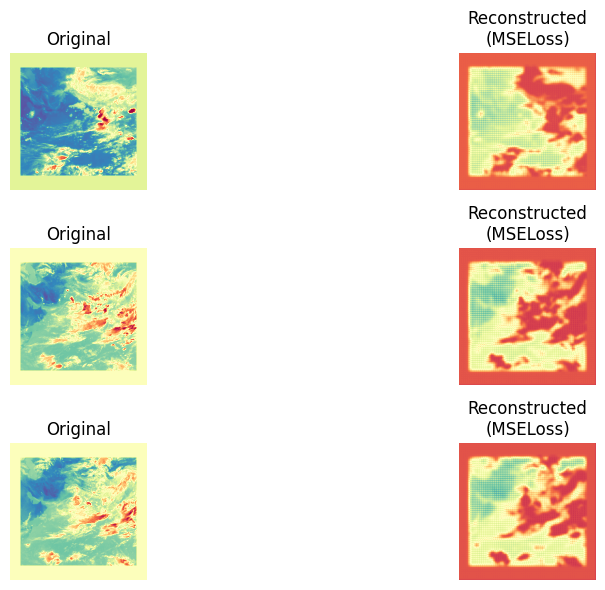

1/60: 100%|██████████| 13/13 [00:00<00:00, 15.33it/s]


Epoch : 1
Loss : 0.023976342752575874
✅ Epoch 1 Metrics → MAE: 0.089902, PSNR: 23.7795, SSIM: 0.6772



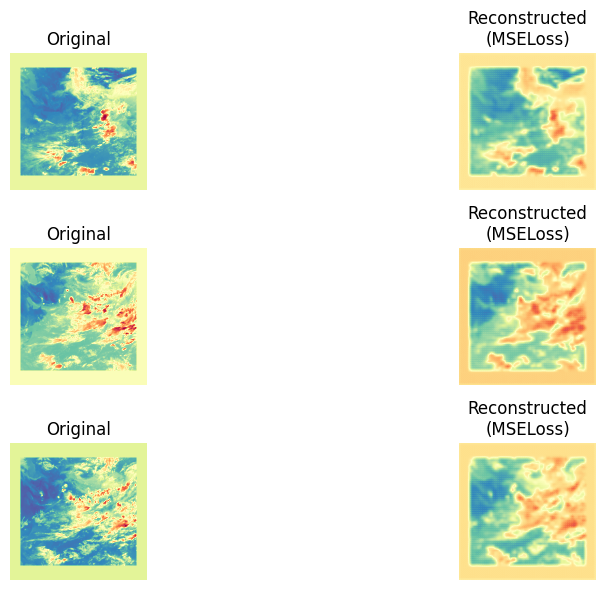

2/60: 100%|██████████| 13/13 [00:00<00:00, 15.05it/s]


Epoch : 2
Loss : 0.013232216525536317
✅ Epoch 2 Metrics → MAE: 0.071624, PSNR: 25.3925, SSIM: 0.7297



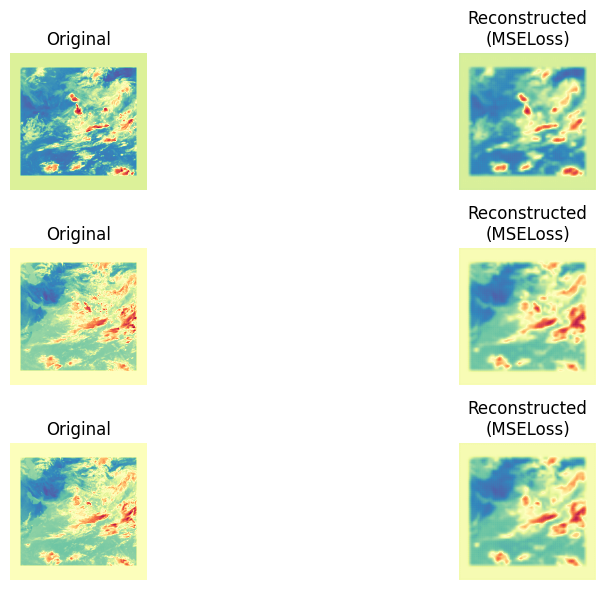

3/60: 100%|██████████| 13/13 [00:00<00:00, 15.21it/s]


Epoch : 3
Loss : 0.01105542115580577
✅ Epoch 3 Metrics → MAE: 0.060500, PSNR: 25.9581, SSIM: 0.7455



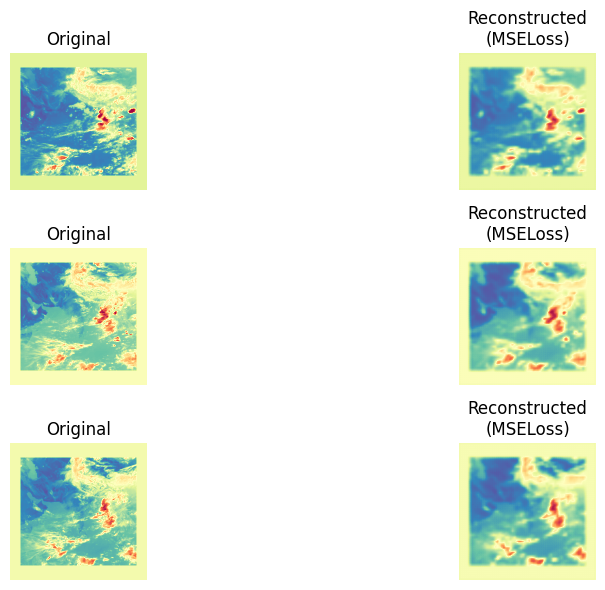

4/60: 100%|██████████| 13/13 [00:00<00:00, 14.99it/s]


Epoch : 4
Loss : 0.009764643600926949
✅ Epoch 4 Metrics → MAE: 0.055464, PSNR: 26.5357, SSIM: 0.7680



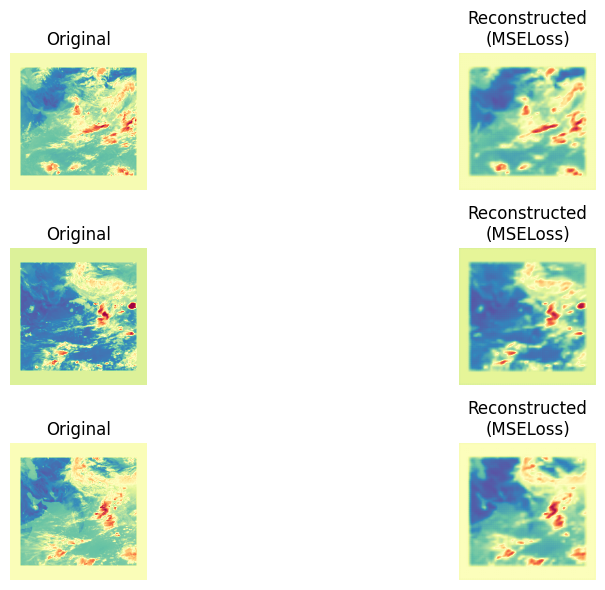

5/60: 100%|██████████| 13/13 [00:00<00:00, 15.20it/s]


Epoch : 5
Loss : 0.008569197478489233
✅ Epoch 5 Metrics → MAE: 0.052063, PSNR: 26.9964, SSIM: 0.7969



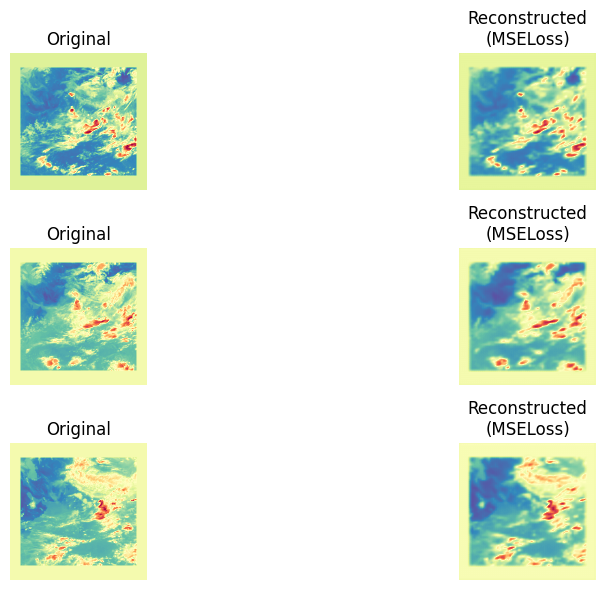

6/60: 100%|██████████| 13/13 [00:00<00:00, 15.05it/s]


Epoch : 6
Loss : 0.007760229305579112
✅ Epoch 6 Metrics → MAE: 0.048184, PSNR: 27.4637, SSIM: 0.8224



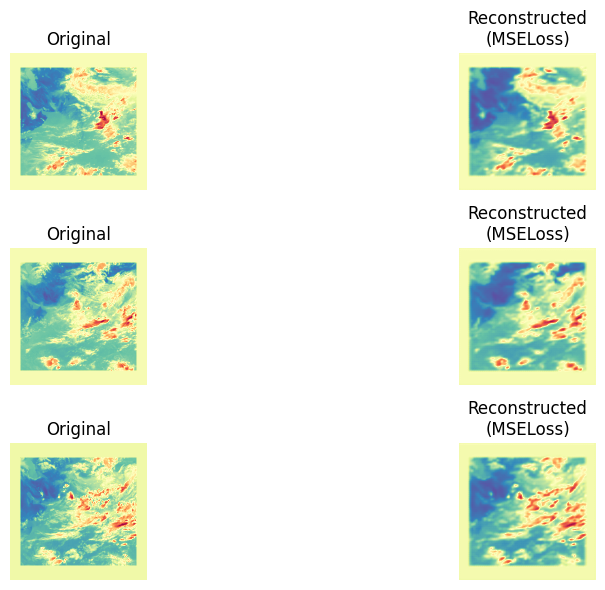

7/60: 100%|██████████| 13/13 [00:00<00:00, 15.00it/s]


Epoch : 7
Loss : 0.007131086877332284
✅ Epoch 7 Metrics → MAE: 0.046982, PSNR: 27.7978, SSIM: 0.8410



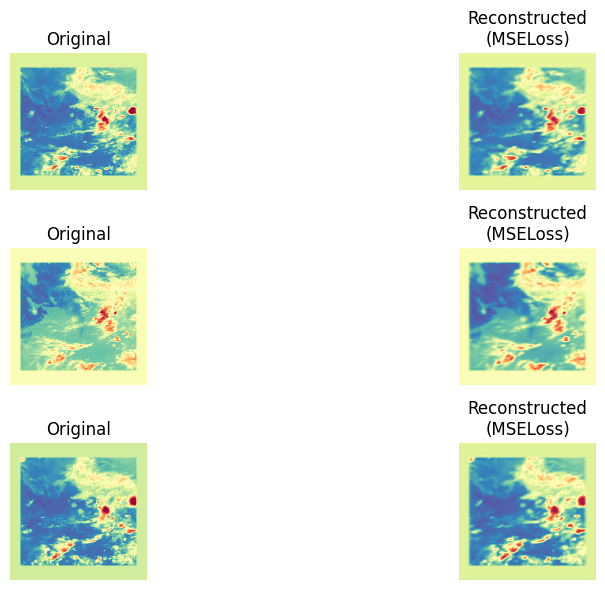

8/60: 100%|██████████| 13/13 [00:00<00:00, 15.07it/s]


Epoch : 8
Loss : 0.006546785696767843
✅ Epoch 8 Metrics → MAE: 0.046716, PSNR: 27.9935, SSIM: 0.8547



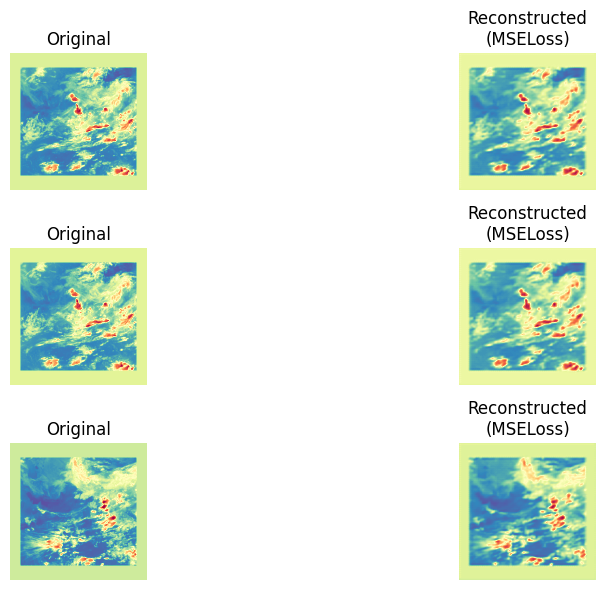

9/60: 100%|██████████| 13/13 [00:00<00:00, 15.01it/s]


Epoch : 9
Loss : 0.0062768148759809825
✅ Epoch 9 Metrics → MAE: 0.043431, PSNR: 28.3525, SSIM: 0.8607



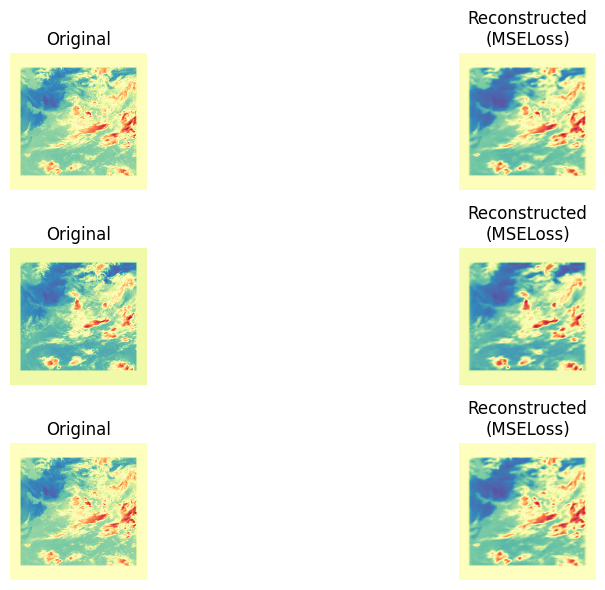

10/60: 100%|██████████| 13/13 [00:00<00:00, 15.01it/s]


Epoch : 10
Loss : 0.005833373834880499
✅ Epoch 10 Metrics → MAE: 0.042269, PSNR: 28.5563, SSIM: 0.8723



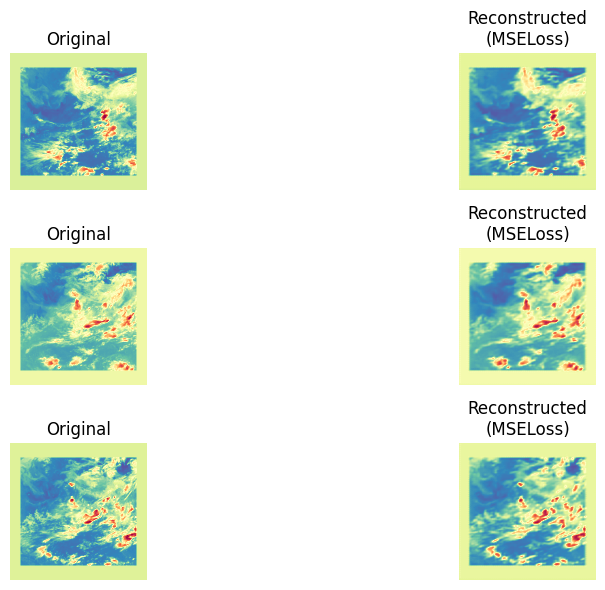

11/60: 100%|██████████| 13/13 [00:00<00:00, 14.76it/s]


Epoch : 11
Loss : 0.005577081599487708
✅ Epoch 11 Metrics → MAE: 0.040394, PSNR: 28.7992, SSIM: 0.8791



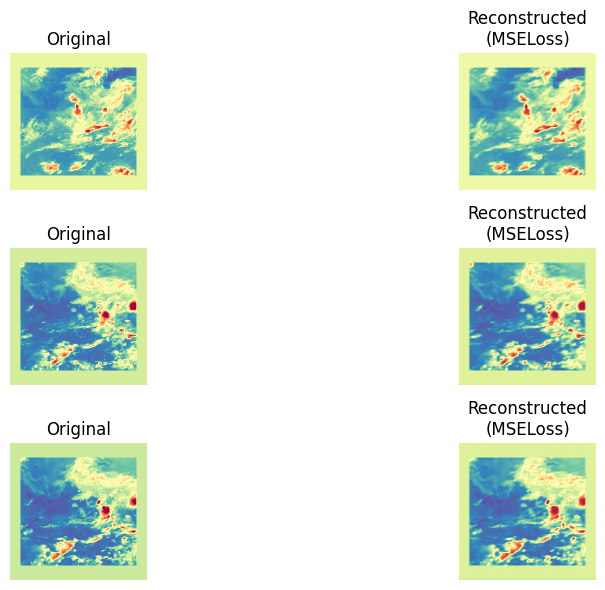

12/60: 100%|██████████| 13/13 [00:00<00:00, 14.90it/s]


Epoch : 12
Loss : 0.005305068782315805
✅ Epoch 12 Metrics → MAE: 0.040395, PSNR: 28.9217, SSIM: 0.8842



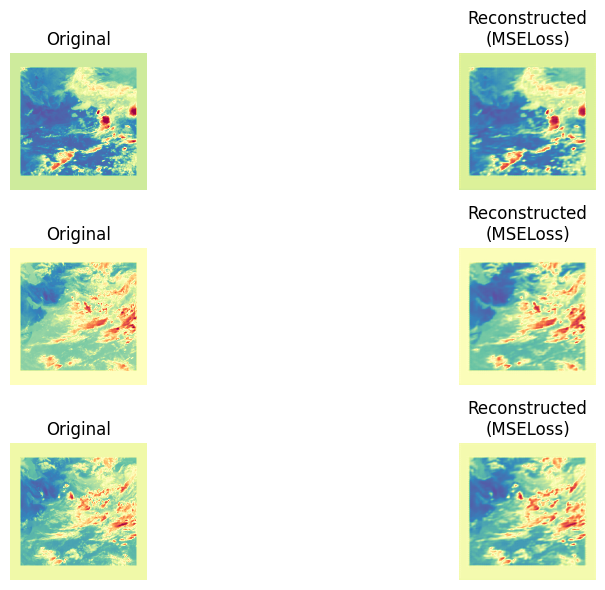

13/60: 100%|██████████| 13/13 [00:00<00:00, 14.89it/s]


Epoch : 13
Loss : 0.005148033181635233
✅ Epoch 13 Metrics → MAE: 0.038935, PSNR: 29.0771, SSIM: 0.8894



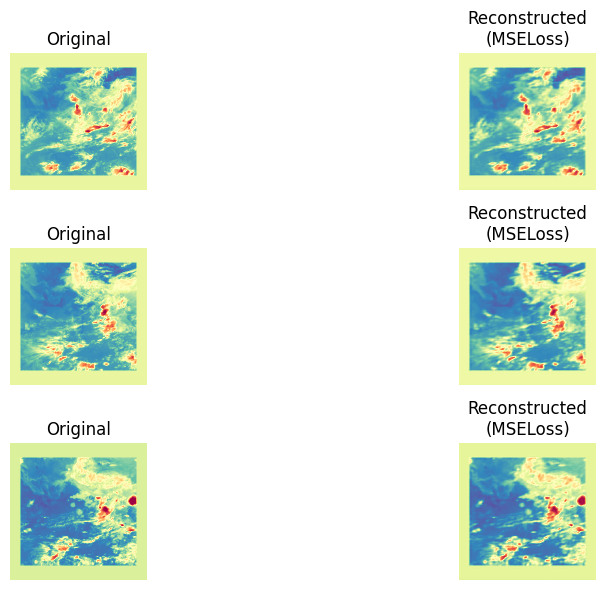

14/60: 100%|██████████| 13/13 [00:00<00:00, 14.84it/s]


Epoch : 14
Loss : 0.005006883293390274
✅ Epoch 14 Metrics → MAE: 0.038375, PSNR: 29.2149, SSIM: 0.8938



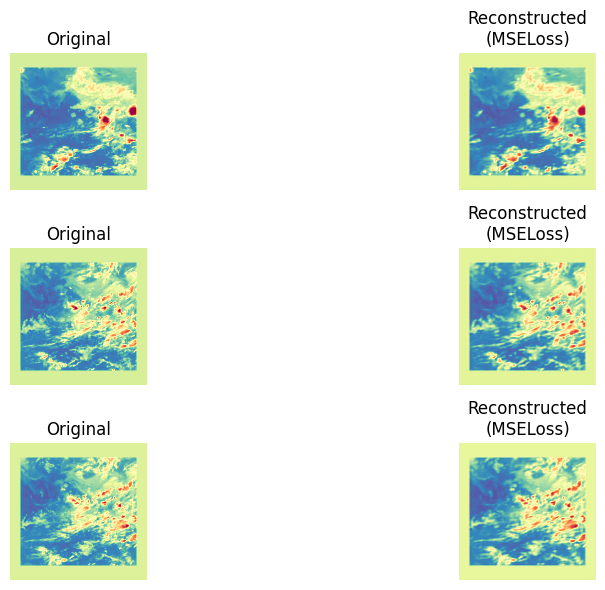

15/60: 100%|██████████| 13/13 [00:00<00:00, 14.73it/s]


Epoch : 15
Loss : 0.004824806327143541
✅ Epoch 15 Metrics → MAE: 0.037761, PSNR: 29.3059, SSIM: 0.8965



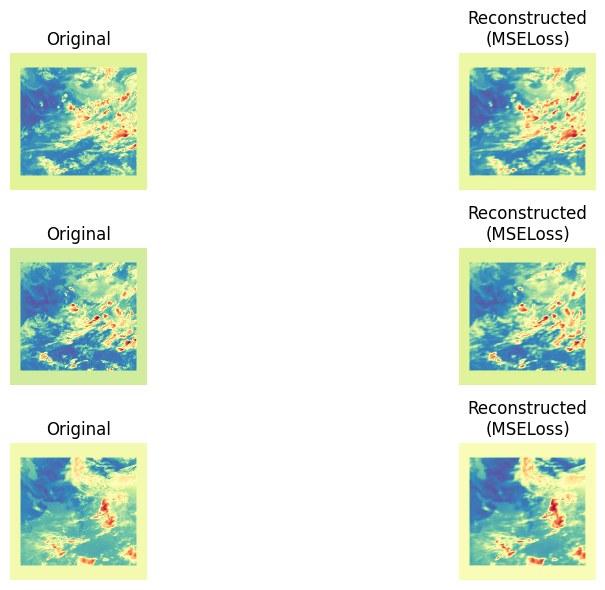

16/60: 100%|██████████| 13/13 [00:00<00:00, 14.84it/s]


Epoch : 16
Loss : 0.004743015859276056
✅ Epoch 16 Metrics → MAE: 0.038115, PSNR: 29.3650, SSIM: 0.8990



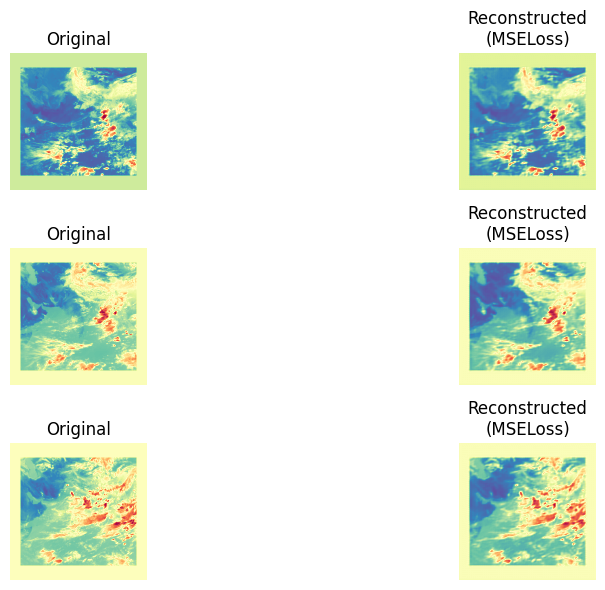

17/60: 100%|██████████| 13/13 [00:00<00:00, 14.81it/s]


Epoch : 17
Loss : 0.00466431466002877
✅ Epoch 17 Metrics → MAE: 0.038067, PSNR: 29.4348, SSIM: 0.9014



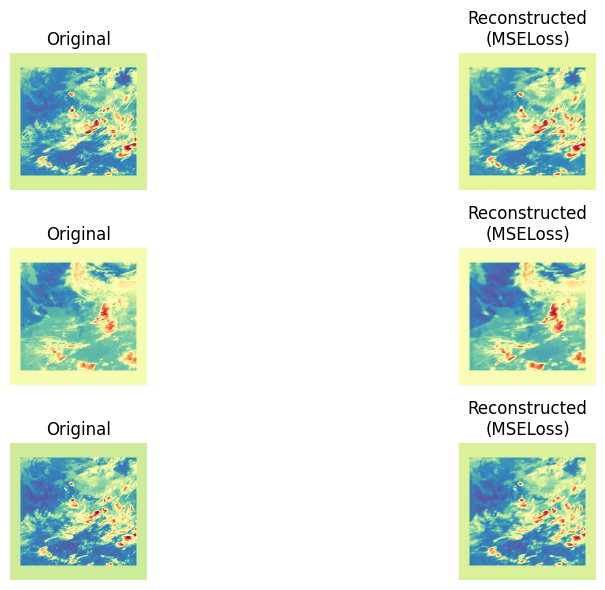

18/60: 100%|██████████| 13/13 [00:00<00:00, 14.71it/s]


Epoch : 18
Loss : 0.004552923357830598
✅ Epoch 18 Metrics → MAE: 0.037227, PSNR: 29.5009, SSIM: 0.9052



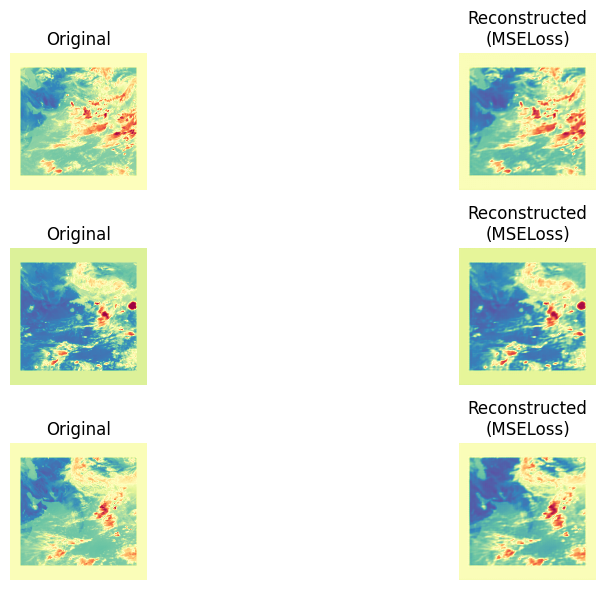

19/60: 100%|██████████| 13/13 [00:00<00:00, 14.72it/s]


Epoch : 19
Loss : 0.004490103859167833
✅ Epoch 19 Metrics → MAE: 0.036263, PSNR: 29.6373, SSIM: 0.9072



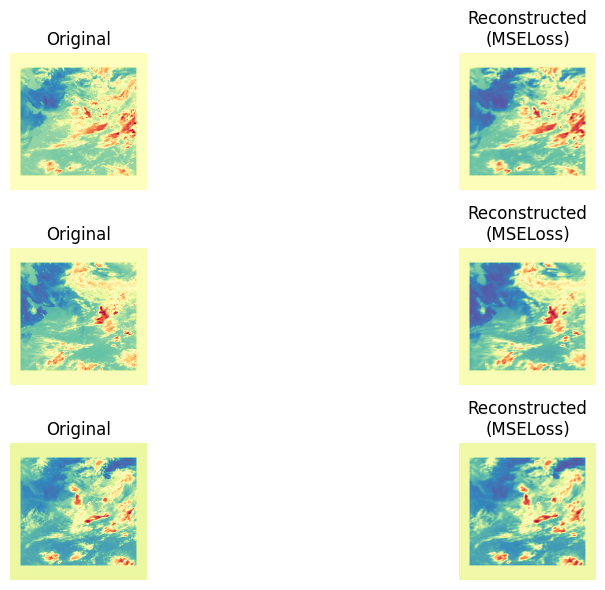

20/60: 100%|██████████| 13/13 [00:00<00:00, 14.68it/s]


Epoch : 20
Loss : 0.004404775296839384
✅ Epoch 20 Metrics → MAE: 0.036004, PSNR: 29.7561, SSIM: 0.9105



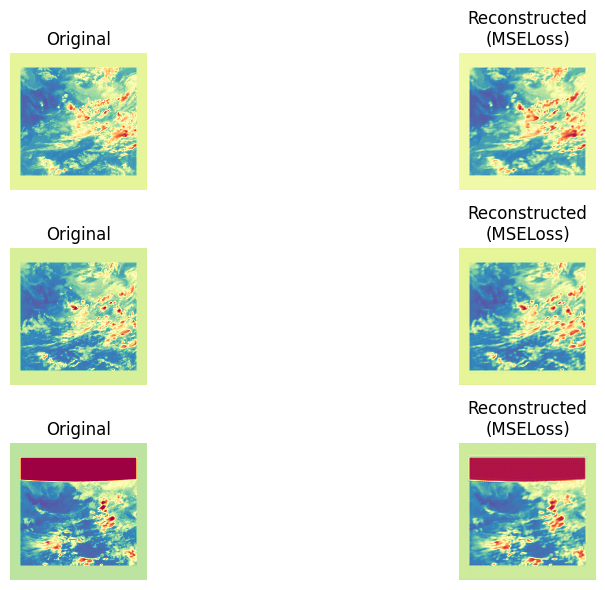

21/60: 100%|██████████| 13/13 [00:00<00:00, 14.80it/s]


Epoch : 21
Loss : 0.004304652138111683
✅ Epoch 21 Metrics → MAE: 0.035789, PSNR: 29.8253, SSIM: 0.9128



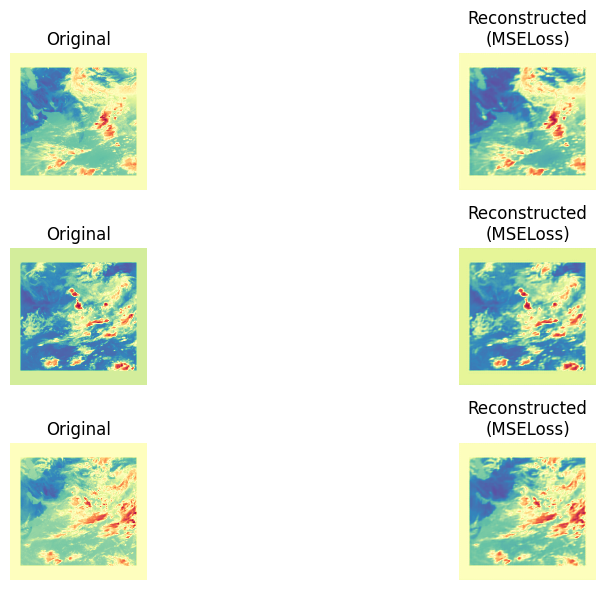

22/60: 100%|██████████| 13/13 [00:00<00:00, 14.72it/s]


Epoch : 22
Loss : 0.0042283872428994914
✅ Epoch 22 Metrics → MAE: 0.035002, PSNR: 29.9455, SSIM: 0.9153



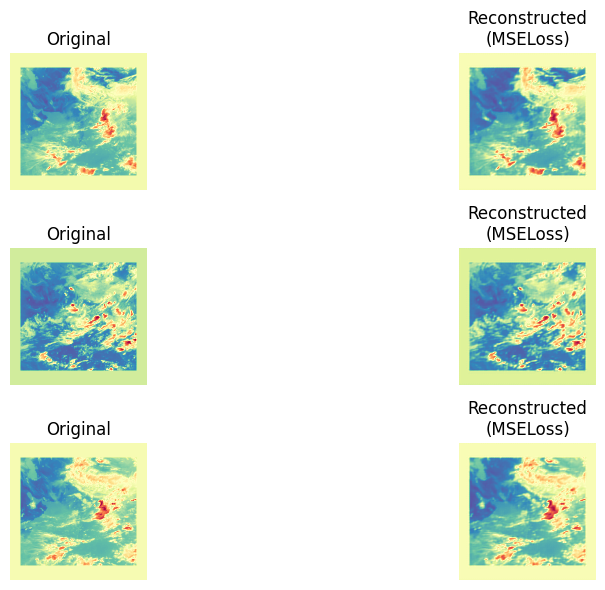

23/60: 100%|██████████| 13/13 [00:00<00:00, 14.68it/s]


Epoch : 23
Loss : 0.00414769072085619
✅ Epoch 23 Metrics → MAE: 0.036089, PSNR: 29.9695, SSIM: 0.9171



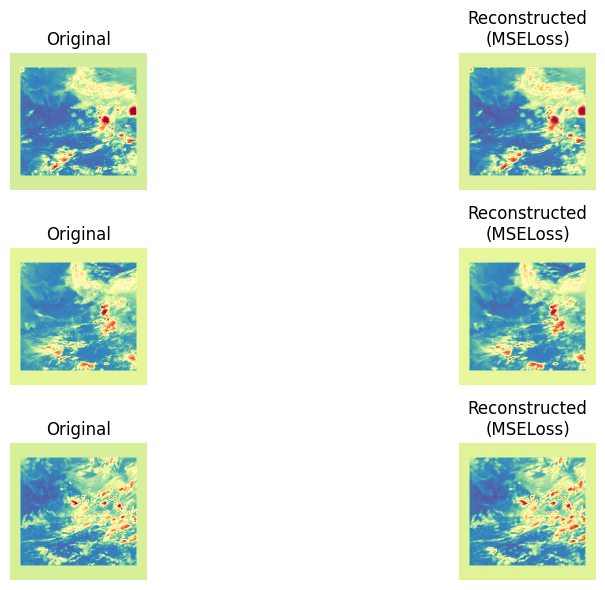

24/60: 100%|██████████| 13/13 [00:00<00:00, 14.72it/s]


Epoch : 24
Loss : 0.004075064986514358
✅ Epoch 24 Metrics → MAE: 0.034204, PSNR: 30.1088, SSIM: 0.9207



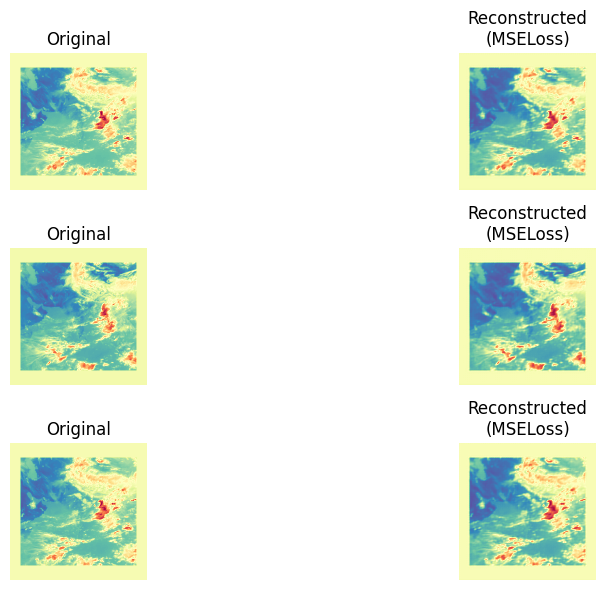

25/60: 100%|██████████| 13/13 [00:00<00:00, 14.81it/s]


Epoch : 25
Loss : 0.004003174799995927
✅ Epoch 25 Metrics → MAE: 0.034733, PSNR: 30.0863, SSIM: 0.9229



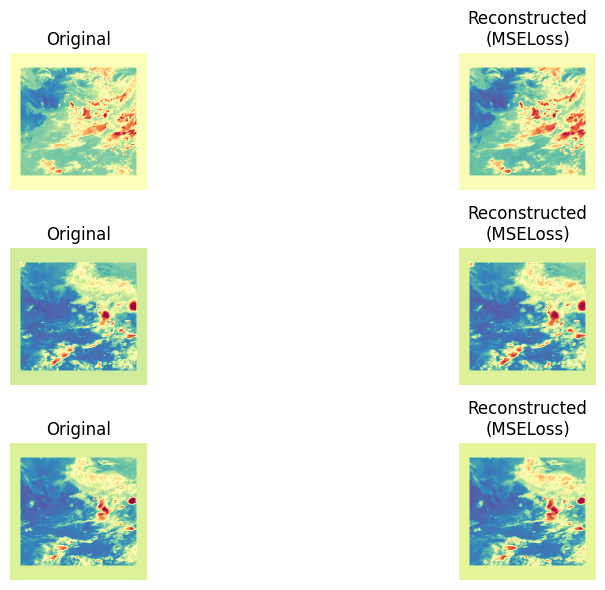

26/60: 100%|██████████| 13/13 [00:00<00:00, 14.82it/s]


Epoch : 26
Loss : 0.003945277412780202
✅ Epoch 26 Metrics → MAE: 0.035561, PSNR: 30.1771, SSIM: 0.9243



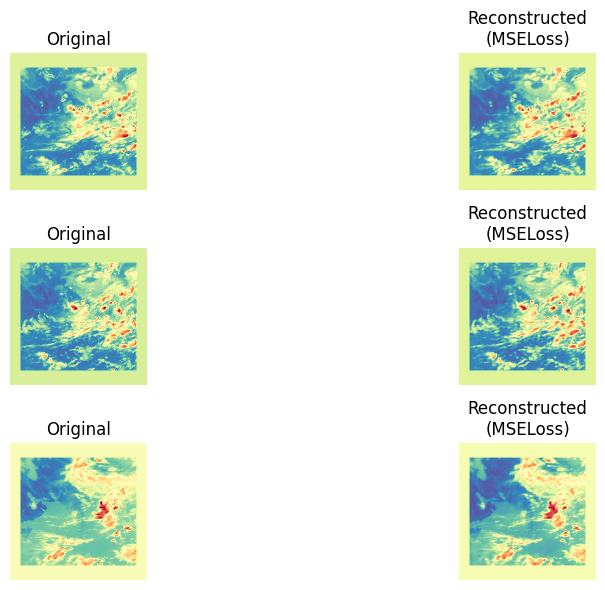

27/60: 100%|██████████| 13/13 [00:00<00:00, 14.91it/s]


Epoch : 27
Loss : 0.0038624446874914262
✅ Epoch 27 Metrics → MAE: 0.033435, PSNR: 30.2985, SSIM: 0.9260



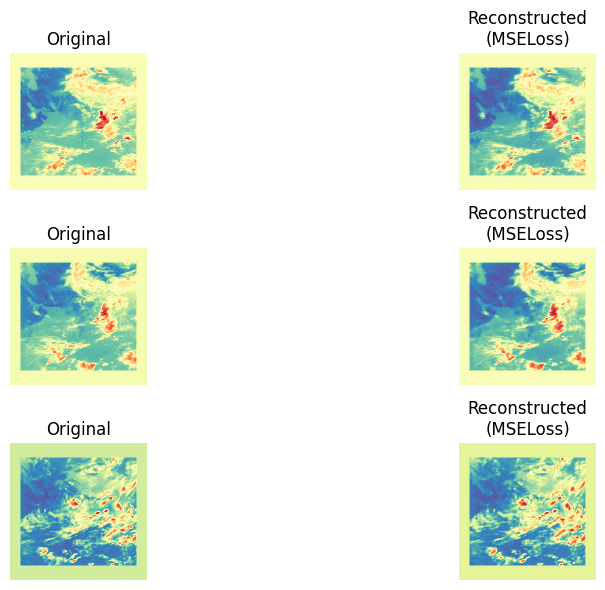

28/60: 100%|██████████| 13/13 [00:00<00:00, 14.77it/s]


Epoch : 28
Loss : 0.0037942205627377215
✅ Epoch 28 Metrics → MAE: 0.033116, PSNR: 30.4089, SSIM: 0.9278



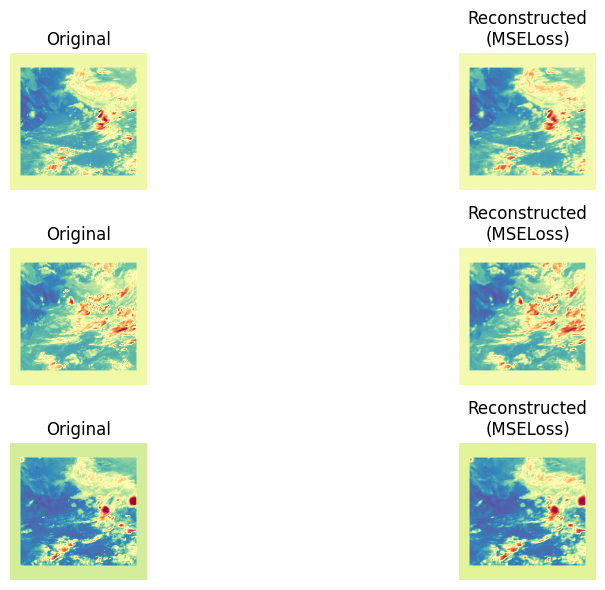

29/60: 100%|██████████| 13/13 [00:00<00:00, 14.82it/s]


Epoch : 29
Loss : 0.0037408807637313237
✅ Epoch 29 Metrics → MAE: 0.033454, PSNR: 30.3897, SSIM: 0.9279



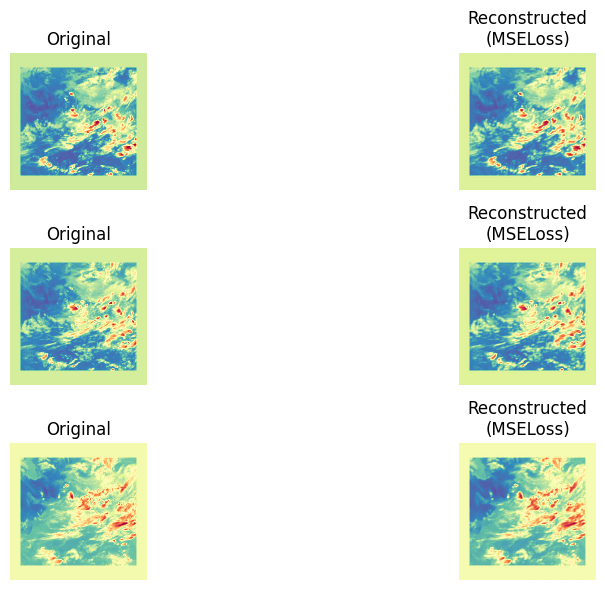

30/60: 100%|██████████| 13/13 [00:00<00:00, 14.81it/s]


Epoch : 30
Loss : 0.003748192971285719
✅ Epoch 30 Metrics → MAE: 0.033811, PSNR: 30.3592, SSIM: 0.9295



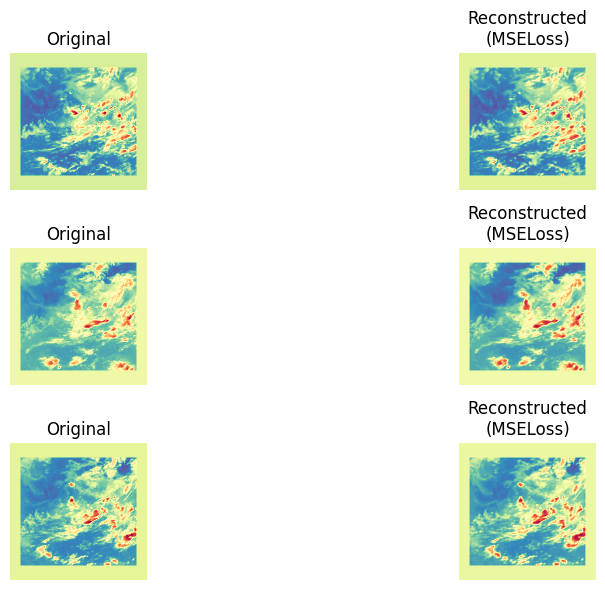

31/60: 100%|██████████| 13/13 [00:00<00:00, 14.81it/s]


Epoch : 31
Loss : 0.0036948763120632907
✅ Epoch 31 Metrics → MAE: 0.032647, PSNR: 30.4978, SSIM: 0.9308



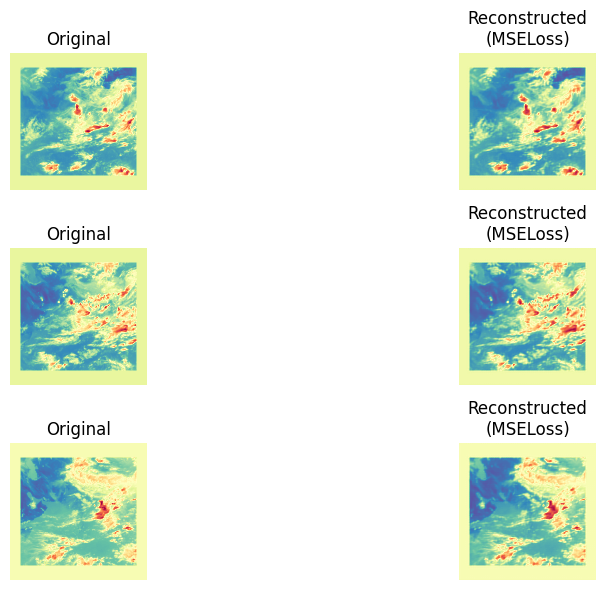

32/60: 100%|██████████| 13/13 [00:00<00:00, 14.85it/s]


Epoch : 32
Loss : 0.003705043990451556
✅ Epoch 32 Metrics → MAE: 0.032253, PSNR: 30.5356, SSIM: 0.9311



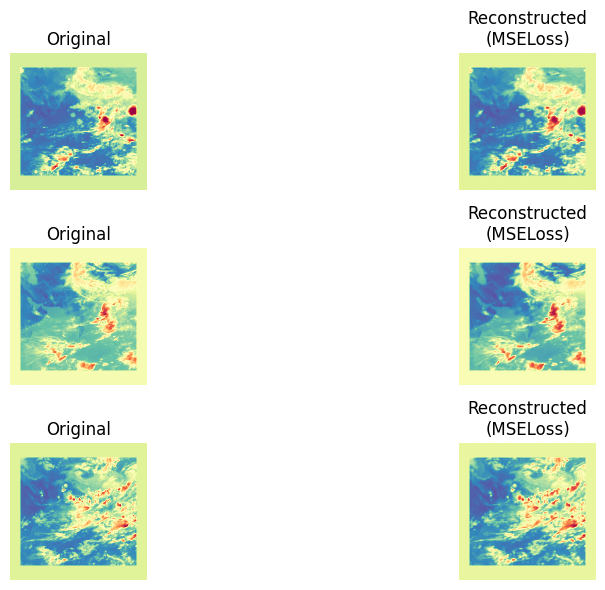

33/60: 100%|██████████| 13/13 [00:00<00:00, 14.92it/s]


Epoch : 33
Loss : 0.0036211412471647444
✅ Epoch 33 Metrics → MAE: 0.032808, PSNR: 30.5402, SSIM: 0.9316



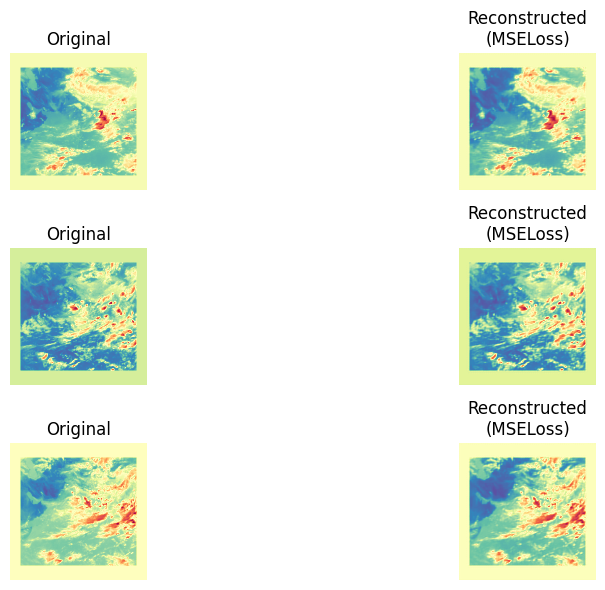

34/60: 100%|██████████| 13/13 [00:00<00:00, 14.92it/s]


Epoch : 34
Loss : 0.003625028784601734
✅ Epoch 34 Metrics → MAE: 0.034014, PSNR: 30.4640, SSIM: 0.9315



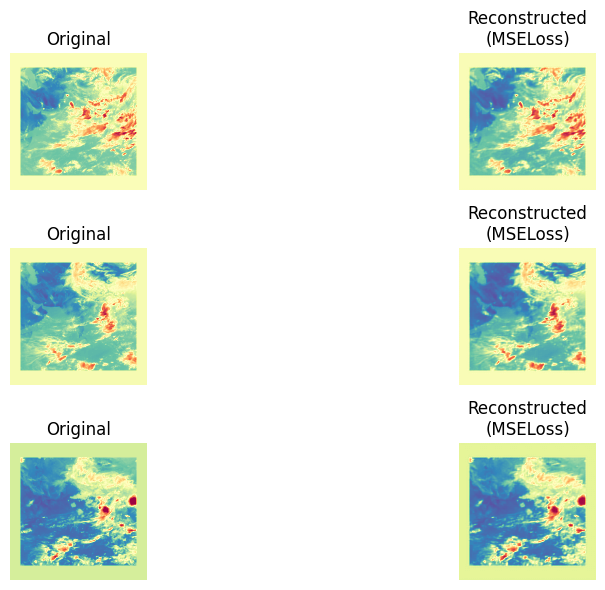

35/60: 100%|██████████| 13/13 [00:00<00:00, 15.00it/s]


Epoch : 35
Loss : 0.0036684346134559466
✅ Epoch 35 Metrics → MAE: 0.032516, PSNR: 30.5429, SSIM: 0.9319



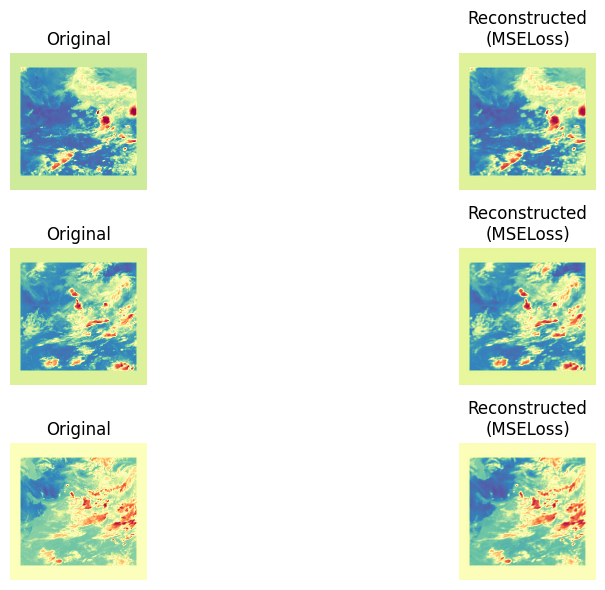

36/60: 100%|██████████| 13/13 [00:00<00:00, 15.04it/s]


Epoch : 36
Loss : 0.003656757476094824
✅ Epoch 36 Metrics → MAE: 0.032768, PSNR: 30.5506, SSIM: 0.9321



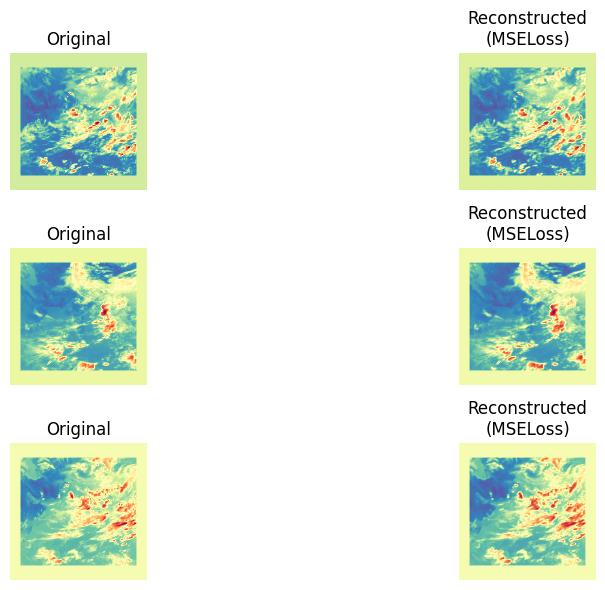

37/60: 100%|██████████| 13/13 [00:00<00:00, 14.97it/s]


Epoch : 37
Loss : 0.0036218948483180543
✅ Epoch 37 Metrics → MAE: 0.034011, PSNR: 30.4400, SSIM: 0.9330



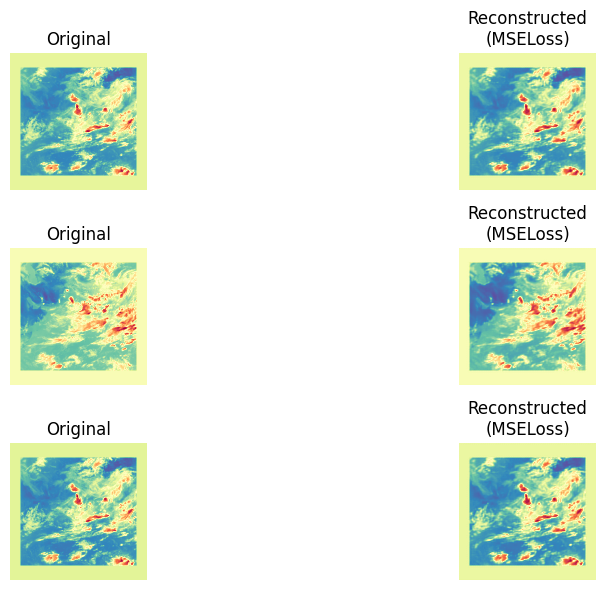

38/60: 100%|██████████| 13/13 [00:00<00:00, 14.80it/s]


Epoch : 38
Loss : 0.0036446341635802616
✅ Epoch 38 Metrics → MAE: 0.031973, PSNR: 30.6088, SSIM: 0.9329



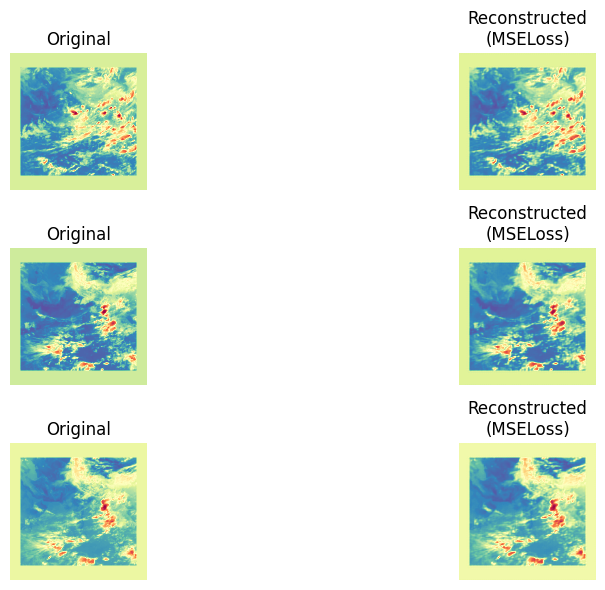

39/60: 100%|██████████| 13/13 [00:00<00:00, 14.89it/s]


Epoch : 39
Loss : 0.003599536891740102
✅ Epoch 39 Metrics → MAE: 0.032376, PSNR: 30.6030, SSIM: 0.9333



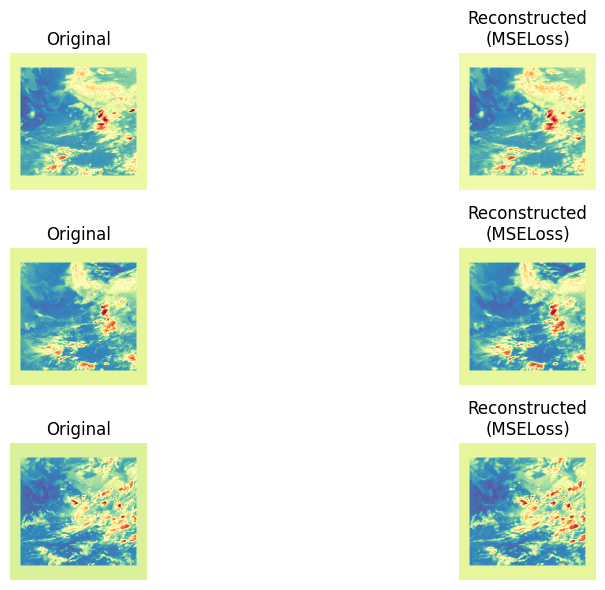

40/60: 100%|██████████| 13/13 [00:00<00:00, 15.02it/s]


Epoch : 40
Loss : 0.003570091212168336
✅ Epoch 40 Metrics → MAE: 0.032214, PSNR: 30.6206, SSIM: 0.9336



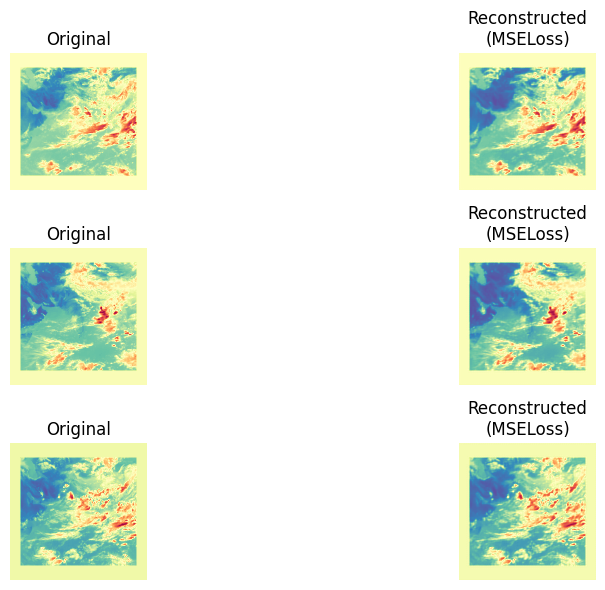

41/60: 100%|██████████| 13/13 [00:00<00:00, 15.03it/s]


Epoch : 41
Loss : 0.003562277272486916
✅ Epoch 41 Metrics → MAE: 0.031821, PSNR: 30.6177, SSIM: 0.9335



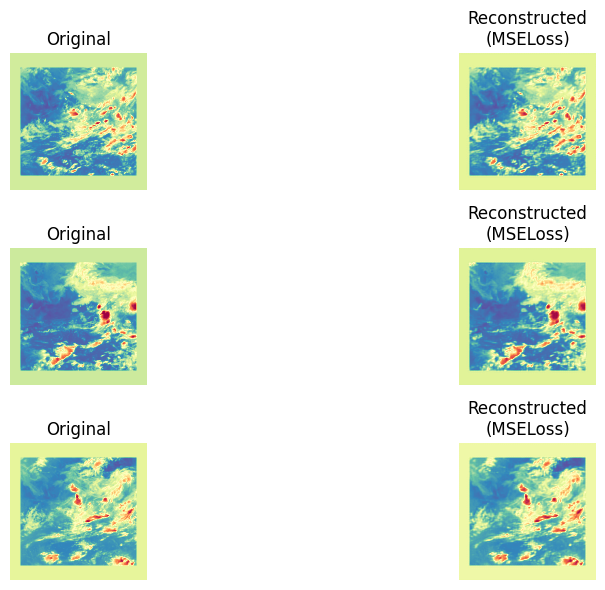

42/60: 100%|██████████| 13/13 [00:00<00:00, 15.00it/s]


Epoch : 42
Loss : 0.0035406591084140996
✅ Epoch 42 Metrics → MAE: 0.031981, PSNR: 30.6305, SSIM: 0.9335



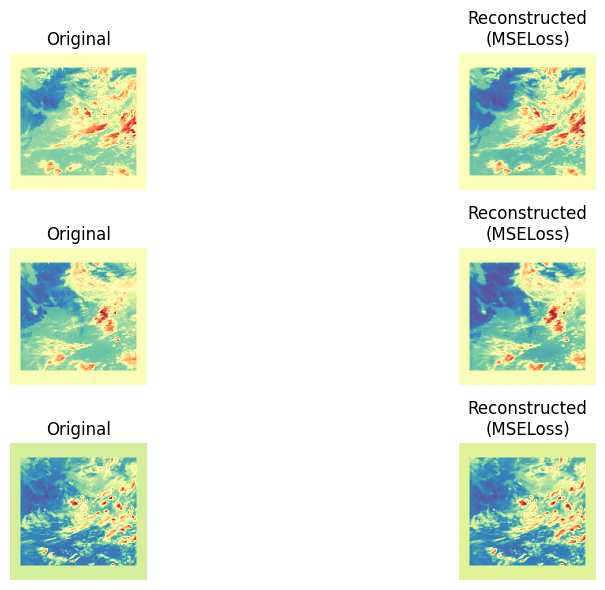

43/60: 100%|██████████| 13/13 [00:00<00:00, 15.03it/s]


Epoch : 43
Loss : 0.0035570622959102574
✅ Epoch 43 Metrics → MAE: 0.031805, PSNR: 30.6362, SSIM: 0.9338



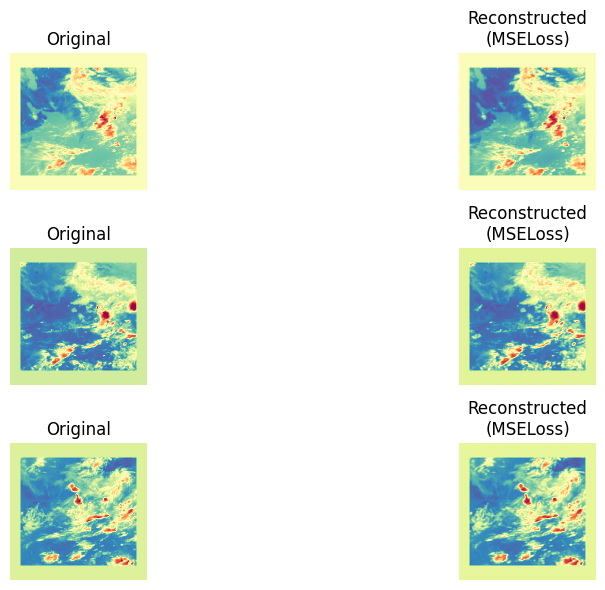

44/60: 100%|██████████| 13/13 [00:00<00:00, 15.05it/s]


Epoch : 44
Loss : 0.0035135823731812146
✅ Epoch 44 Metrics → MAE: 0.031777, PSNR: 30.6085, SSIM: 0.9338



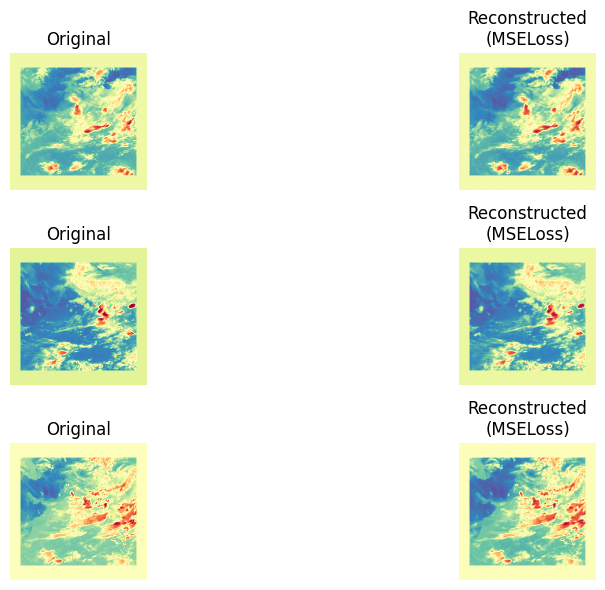

45/60: 100%|██████████| 13/13 [00:00<00:00, 15.02it/s]


Epoch : 45
Loss : 0.003574270217751081
✅ Epoch 45 Metrics → MAE: 0.032628, PSNR: 30.5966, SSIM: 0.9336



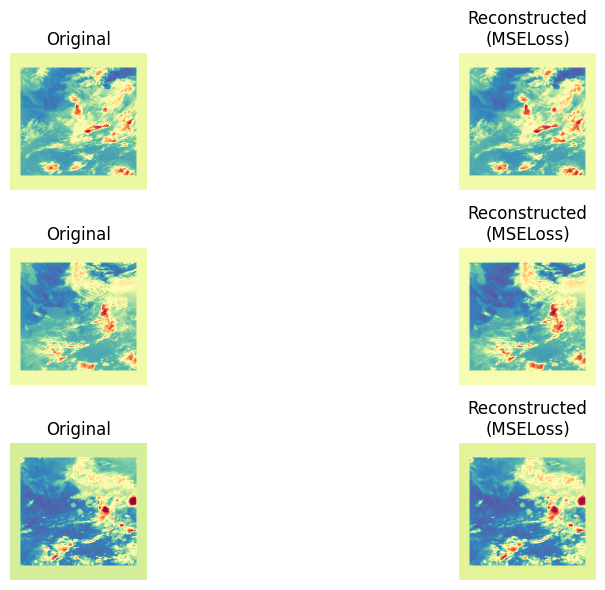

46/60: 100%|██████████| 13/13 [00:00<00:00, 14.95it/s]


Epoch : 46
Loss : 0.0035670198177775512
✅ Epoch 46 Metrics → MAE: 0.031509, PSNR: 30.6719, SSIM: 0.9342



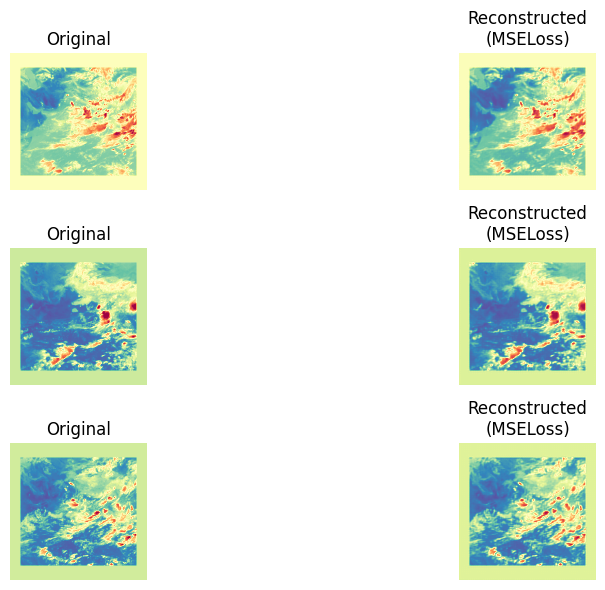

47/60: 100%|██████████| 13/13 [00:00<00:00, 15.00it/s]


Epoch : 47
Loss : 0.0035047134778533992
✅ Epoch 47 Metrics → MAE: 0.033077, PSNR: 30.5457, SSIM: 0.9346



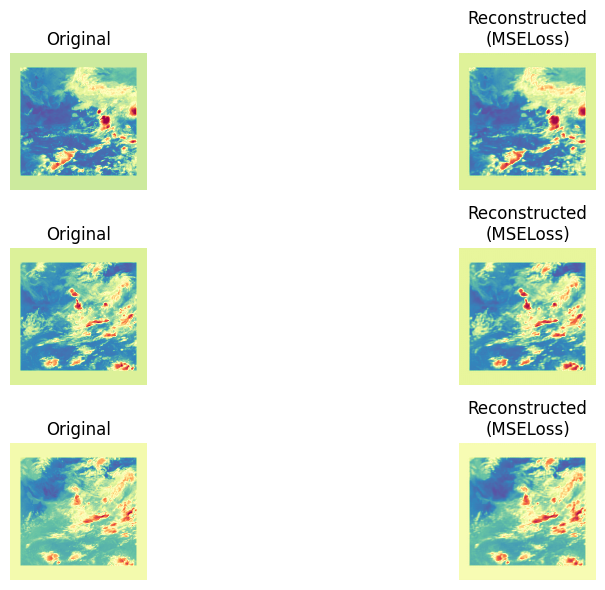

48/60: 100%|██████████| 13/13 [00:00<00:00, 15.02it/s]


Epoch : 48
Loss : 0.003533463763932769
✅ Epoch 48 Metrics → MAE: 0.031909, PSNR: 30.6584, SSIM: 0.9346



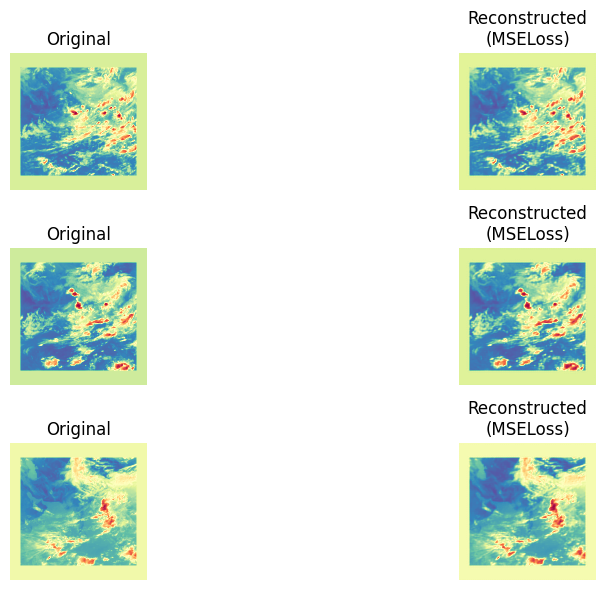

49/60: 100%|██████████| 13/13 [00:00<00:00, 14.92it/s]


Epoch : 49
Loss : 0.003520663988848145
✅ Epoch 49 Metrics → MAE: 0.031436, PSNR: 30.6908, SSIM: 0.9350



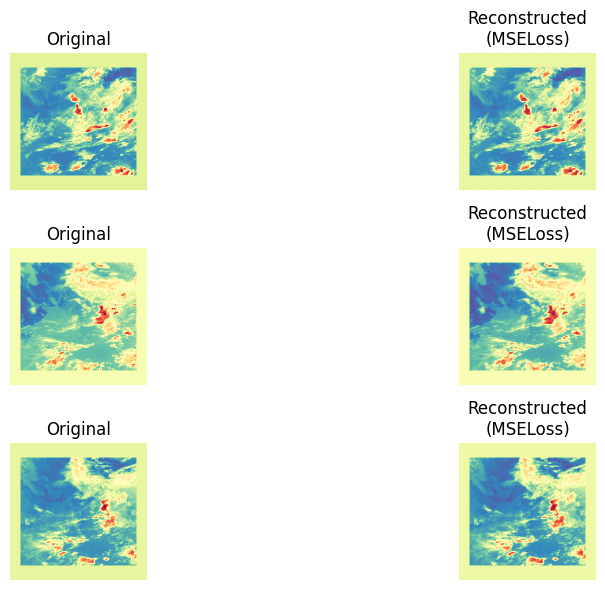

50/60: 100%|██████████| 13/13 [00:00<00:00, 15.10it/s]


Epoch : 50
Loss : 0.0035081275452214936
✅ Epoch 50 Metrics → MAE: 0.031794, PSNR: 30.6947, SSIM: 0.9353



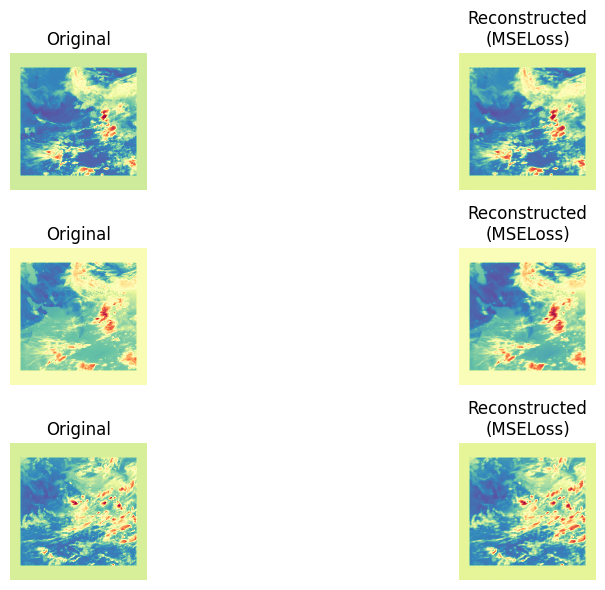

51/60: 100%|██████████| 13/13 [00:00<00:00, 15.05it/s]


Epoch : 51
Loss : 0.0034918562294198917
✅ Epoch 51 Metrics → MAE: 0.031476, PSNR: 30.7114, SSIM: 0.9351



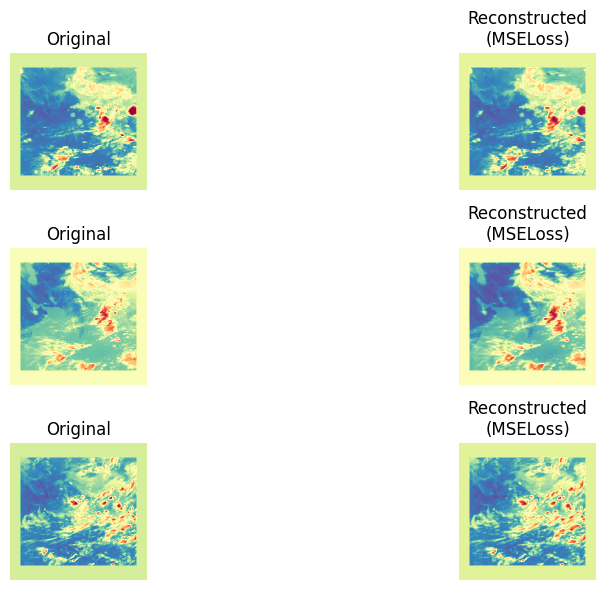

52/60: 100%|██████████| 13/13 [00:00<00:00, 15.06it/s]


Epoch : 52
Loss : 0.0035267890287706484
✅ Epoch 52 Metrics → MAE: 0.032115, PSNR: 30.6823, SSIM: 0.9349



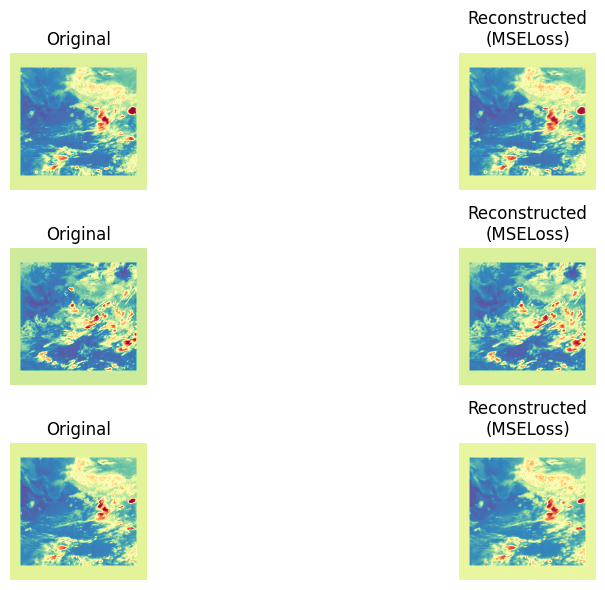

53/60: 100%|██████████| 13/13 [00:00<00:00, 15.07it/s]


Epoch : 53
Loss : 0.00350704389767578
✅ Epoch 53 Metrics → MAE: 0.033478, PSNR: 30.6067, SSIM: 0.9352



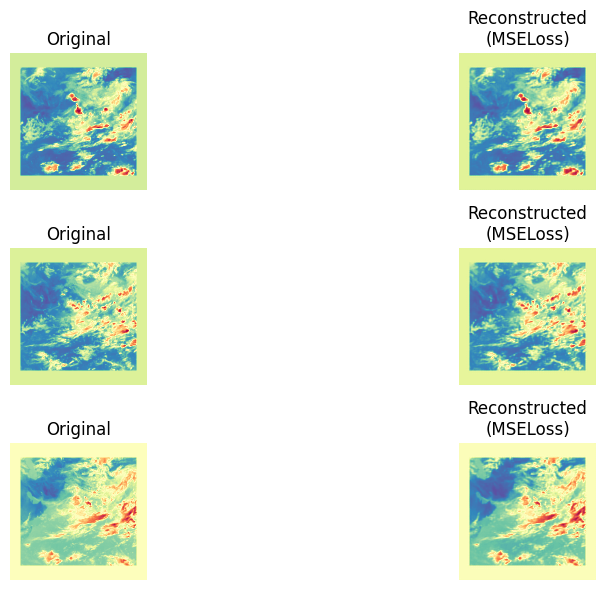

54/60: 100%|██████████| 13/13 [00:00<00:00, 15.07it/s]


Epoch : 54
Loss : 0.0035458640553630316
✅ Epoch 54 Metrics → MAE: 0.033583, PSNR: 30.6226, SSIM: 0.9353



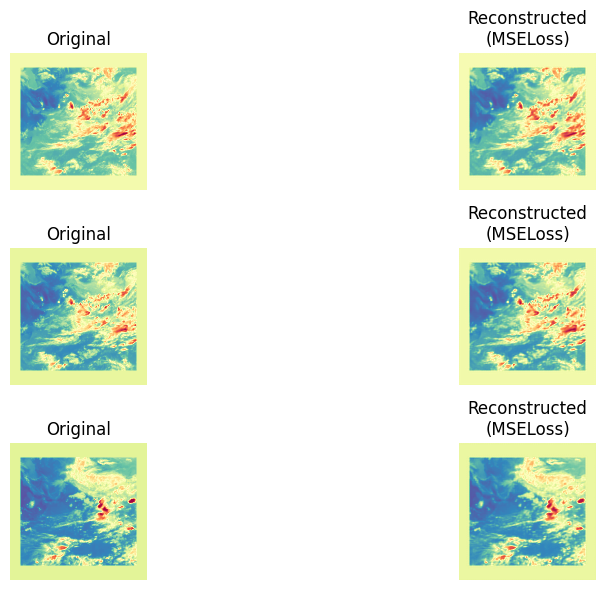

55/60: 100%|██████████| 13/13 [00:00<00:00, 15.03it/s]


Epoch : 55
Loss : 0.0035296864449404753
✅ Epoch 55 Metrics → MAE: 0.031265, PSNR: 30.7019, SSIM: 0.9356



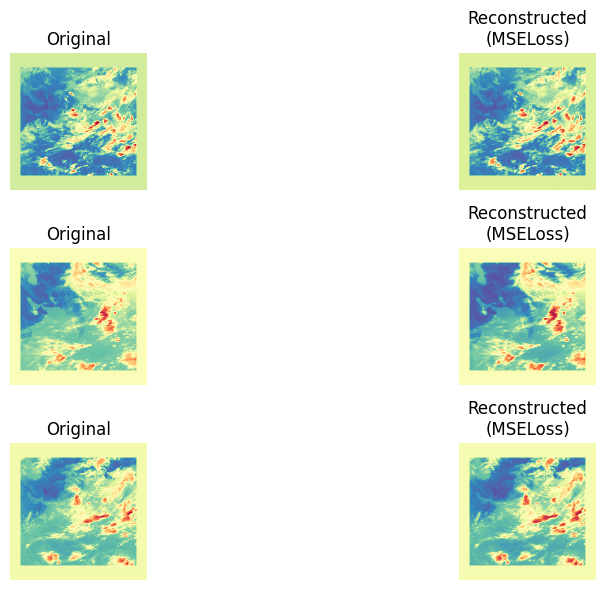

56/60: 100%|██████████| 13/13 [00:00<00:00, 14.95it/s]


Epoch : 56
Loss : 0.0034987000533594536
✅ Epoch 56 Metrics → MAE: 0.031907, PSNR: 30.6942, SSIM: 0.9359



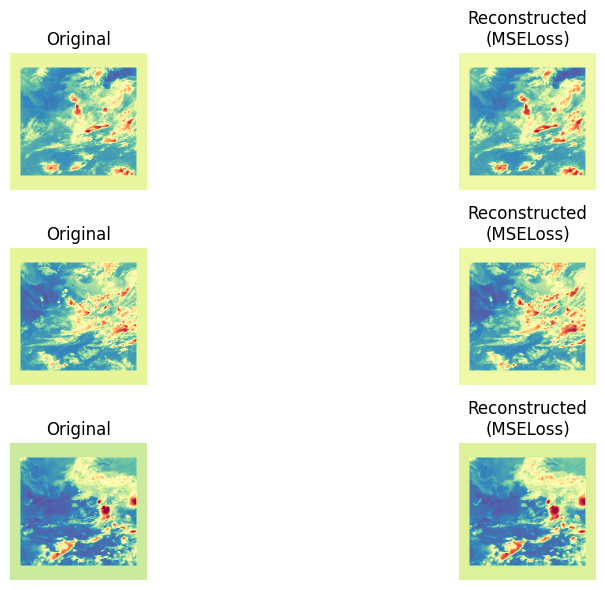

57/60: 100%|██████████| 13/13 [00:00<00:00, 15.00it/s]


Epoch : 57
Loss : 0.00356224263445116
✅ Epoch 57 Metrics → MAE: 0.031709, PSNR: 30.6436, SSIM: 0.9360



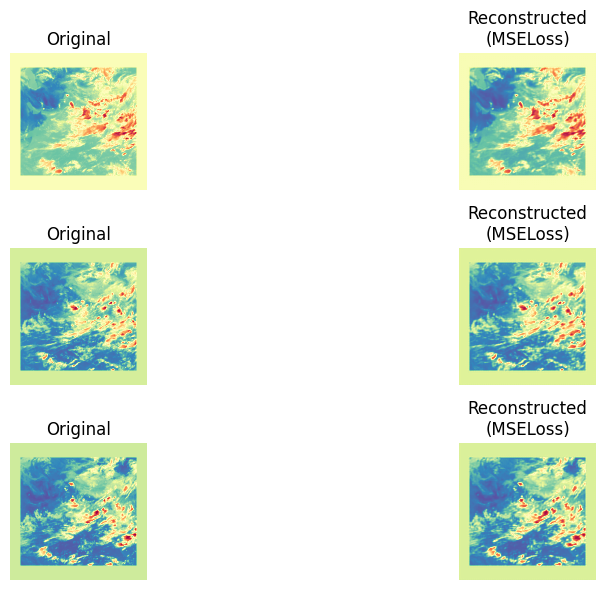

58/60: 100%|██████████| 13/13 [00:00<00:00, 14.93it/s]


Epoch : 58
Loss : 0.0035065450669767764
✅ Epoch 58 Metrics → MAE: 0.032488, PSNR: 30.6651, SSIM: 0.9362



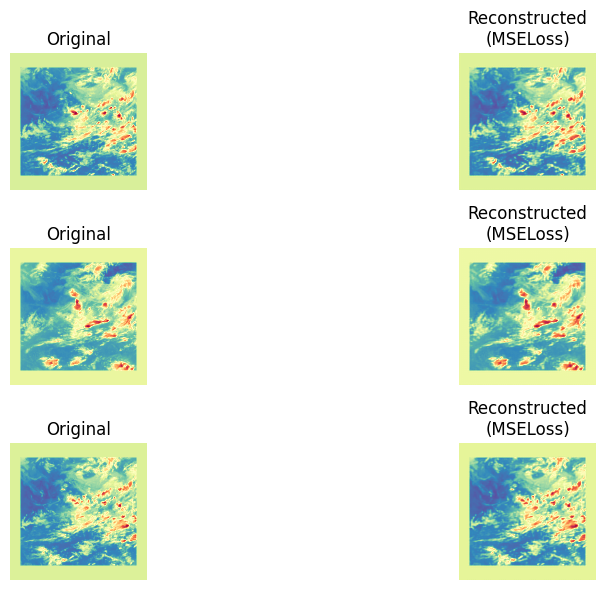

59/60: 100%|██████████| 13/13 [00:00<00:00, 14.90it/s]


Epoch : 59
Loss : 0.0035402446161382473
✅ Epoch 59 Metrics → MAE: 0.032475, PSNR: 30.7031, SSIM: 0.9356



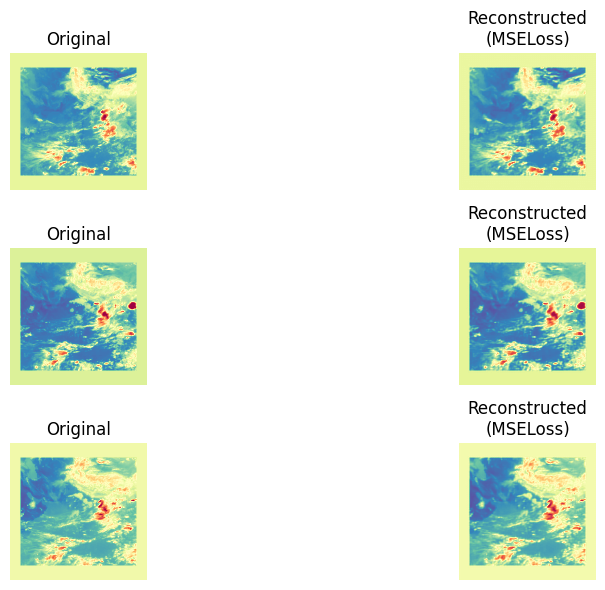

         MAE       PSNR      SSIM
0   0.123867  21.016429  0.533829
1   0.089902  23.779548  0.677168
2   0.071624  25.392540  0.729748
3   0.060500  25.958075  0.745528
4   0.055464  26.535664  0.768032
5   0.052063  26.996368  0.796860
6   0.048184  27.463654  0.822397
7   0.046982  27.797848  0.840956
8   0.046716  27.993461  0.854663
9   0.043431  28.352539  0.860728
10  0.042269  28.556342  0.872318
11  0.040394  28.799226  0.879087
12  0.040395  28.921720  0.884183
13  0.038935  29.077068  0.889425
14  0.038375  29.214891  0.893792
15  0.037761  29.305869  0.896466
16  0.038115  29.365015  0.899006
17  0.038067  29.434800  0.901427
18  0.037227  29.500938  0.905214
19  0.036263  29.637334  0.907179
20  0.036004  29.756106  0.910520
21  0.035789  29.825305  0.912785
22  0.035002  29.945527  0.915309
23  0.036089  29.969456  0.917112
24  0.034204  30.108751  0.920721
25  0.034733  30.086303  0.922907
26  0.035561  30.177120  0.924264
27  0.033435  30.298513  0.925970
28  0.033116  

In [32]:
losses = [
    (nn.MSELoss(), 1.0),
    #(nn.L1Loss(),1.0),
    # (CustomPerceptualLoss(), 0.1),
    # (PatchDiscriminatorLoss(), 0.01)
]

model, metrics_df = train(
    model_class=ConvAE,
    loader=loader,
    loss_fns=losses,
    h_params={'EPOCHS': 60, 'lr': 1e-3, 'weight_decay': 1e-4},
    save_loc = 'model_autoencoder.pth')



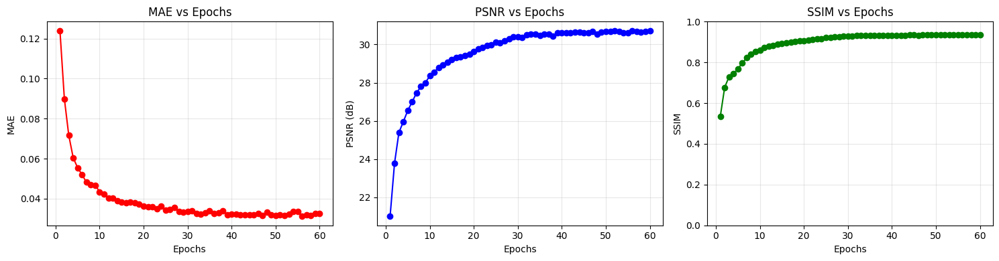

In [33]:
plot_metrics(metrics_df)

In [38]:
model

ConvAE(
  (encoder): Sequential(
    (0): EncoderBlock(
      (encoder): Sequential(
        (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (3): ReLU()
      )
    )
    (1): Conv2d(128, 4, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decoder): DecoderBlock(
    (decoder): Sequential(
      (0): ConvTranspose2d(4, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
      (1): ReLU()
      (2): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
      (3): ReLU()
      (4): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
      (5): Tanh()
    )
  )
)

In [39]:
import os
from IPython.display import FileLink

# Save model or tensor
torch.save(model, "model_autoencoder.pth")

# Generate download link
display(FileLink("model_autoencoder.pth"))


/kaggle/working/model_autoencoder.pth

## 5.2 Fusing Patched Discriminator // AE - GAN
<p style="font-size:21px;">
    1. Fusing Patch Disriminator in loss function would encourage the model to hold onto local features, thus improving the metrics
    <br>
    2. Just like in pix2pix architecture we will be setting up a discriminator acrchitecture, that will judge the real and fakes on patch level
    <br>
    3. Finally unlike encoder, the final will convolution will produce one channel only
</p>

In [ ]:
class PatchedDiscriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.discriminator = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size = 3, padding = 1, stride = 2),
            nn.LeakyReLU(0.2, inplace = True),

            nn.Conv2d(64, 128, kernel_size = 3, stride = 2, padding = 1),
            nn.BatchNorm2d(128), # Requires batched input**
            nn.LeakyReLU(0.2, inplace = True),

            # nn.Conv2d(128, 256, kernel_size = 3, stride = 2, padding = 1),
            # nn.BatchNorm2d(256),
            # nn.LeakyReLU(0.2, inplace = True),

            nn.Conv2d(128, 1, kernel_size = 3, stride = 1, padding = 1)            
        )
    def forward(self,x):
        return self.discriminator(x)

In [114]:
# Sanity Check
PatchedDiscriminator()(torch.randn(1,1,512,512)).shape

torch.Size([1, 1, 128, 128])

In [93]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
EPOCHS = 30

ae = ConvAE().to(device)
d = PatchedDiscriminator().to(device)

optim_ae = torch.optim.Adam(ae.parameters(),lr = 1e-3, weight_decay = 1e-4)
optim_d = torch.optim.Adam(d.parameters(),lr = 1e-3, weight_decay = 1e-4)

bce = nn.BCEWithLogitsLoss()
mse = nn.MSELoss()

lamda_rec,lamda_adv = 1.0,0.1 

metrics = ['Reconstruction Loss', 'PSNR', 'SSIM']
metrics_df = pd.DataFrame(columns = metrics)

for epoch in range(EPOCHS):
    tot_ae_loss = 0.0
    tot_d_loss = 0.0
    
    for X in tqdm(loader, desc = f'epoch / EPOCH'):
        X = X.to(device)
        
        with torch.no_grad():
            fake_images = ae(X)[0]
            
        real_pred = d(X)
        fake_pred = d(fake_images)
        
        d_loss_real = bce(real_pred, torch.ones_like(real_pred))
        d_loss_fake = bce(fake_pred, torch.zeros_like(fake_pred))

        d_loss_net = (d_loss_real + d_loss_fake) / 2.0 

        optim_d.zero_grad()
        d_loss_net.backward()
        optim_d.step()
        
        tot_d_loss += d_loss_net.item()

        fake_images = ae(X)[0]
        fake_pred = d(fake_images)

        ae_recon_loss = mse(fake_images, X)
        ae_adv_loss = bce(fake_pred, torch.ones_like(fake_pred))

        ae_net_loss = lamda_rec * ae_recon_loss + lamda_adv * ae_adv_loss

        optim_ae.zero_grad()
        ae_net_loss.backward()
        optim_ae.step()

        tot_ae_loss += ae_loss_net.item()
        

    print(f'Epoch : {epoch} || AE Loss : {tot_ae_loss / len(loader)} || Discriminator Loss : {tot_d_loss / len(loader)}')
    print(f' Metrics : ')
        
        
        

SyntaxError: f-string: expecting '}' (2051406846.py, line 54)

Epoch 1/30: 100%|██████████| 13/13 [00:04<00:00,  3.07it/s]


Epoch [1/30] | AE Loss: 0.1685 | D Loss: 0.5172 | PSNR: 19.26 | SSIM: 0.4289


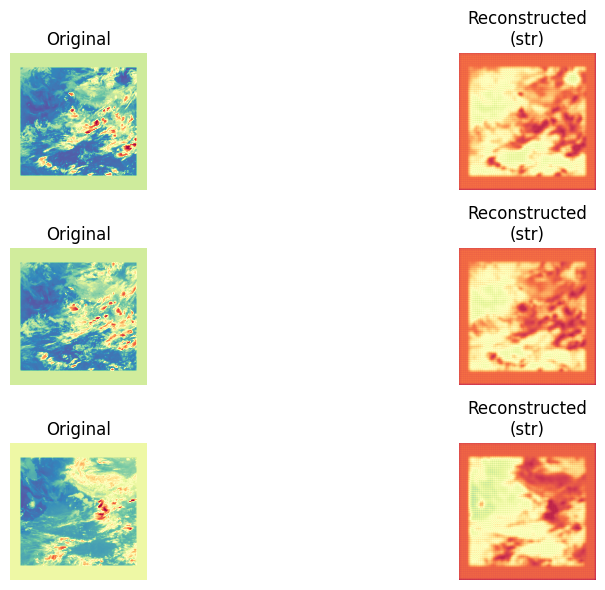

Epoch 2/30: 100%|██████████| 13/13 [00:04<00:00,  2.94it/s]


Epoch [2/30] | AE Loss: 0.0297 | D Loss: 0.3655 | PSNR: 23.06 | SSIM: 0.6615


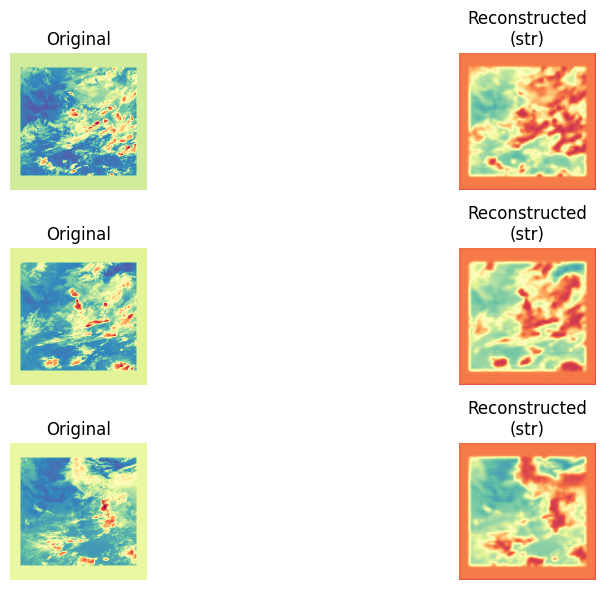

Epoch 3/30: 100%|██████████| 13/13 [00:04<00:00,  2.87it/s]


Epoch [3/30] | AE Loss: 0.0170 | D Loss: 0.2667 | PSNR: 24.82 | SSIM: 0.7208


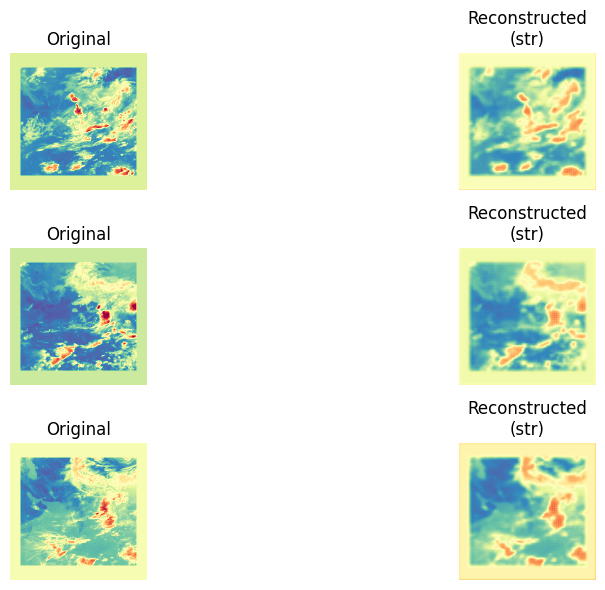

Epoch 4/30: 100%|██████████| 13/13 [00:04<00:00,  2.97it/s]


Epoch [4/30] | AE Loss: 0.0129 | D Loss: 0.4225 | PSNR: 25.40 | SSIM: 0.7345


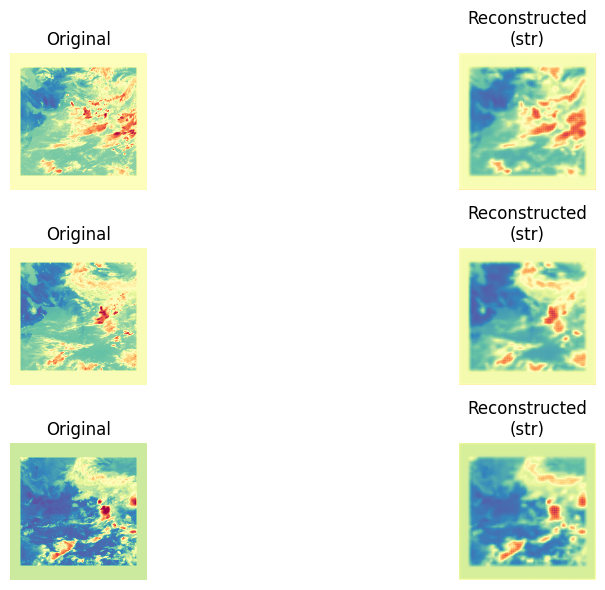

Epoch 5/30: 100%|██████████| 13/13 [00:04<00:00,  3.15it/s]


Epoch [5/30] | AE Loss: 0.0113 | D Loss: 0.3737 | PSNR: 25.81 | SSIM: 0.7498


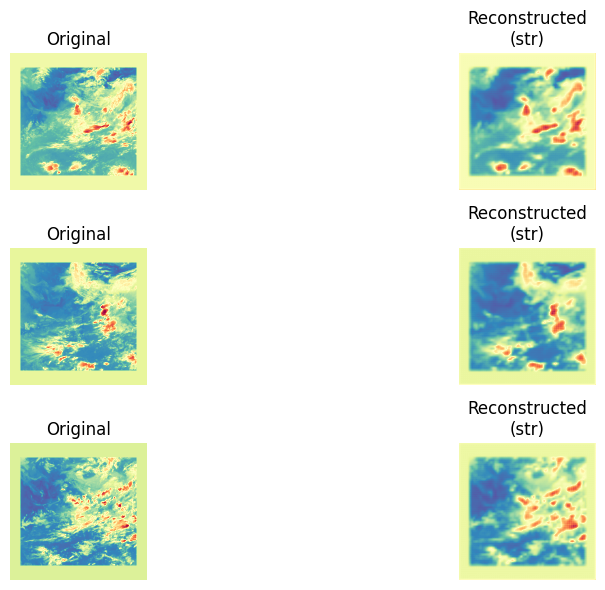

Epoch 6/30: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s]


Epoch [6/30] | AE Loss: 0.0104 | D Loss: 0.4931 | PSNR: 26.28 | SSIM: 0.7747


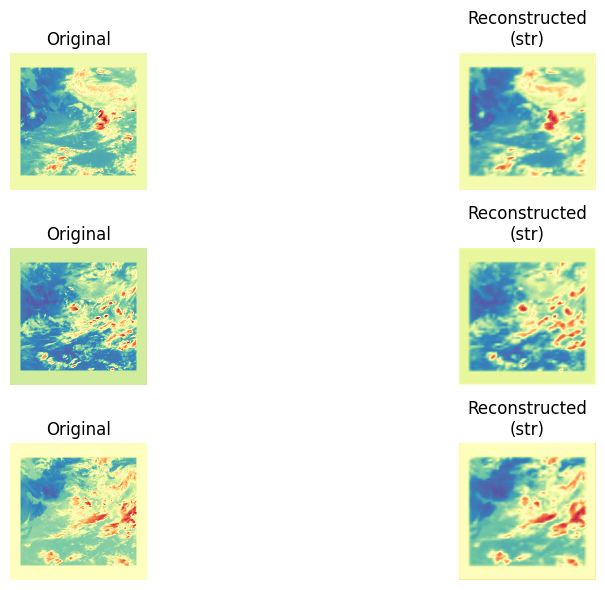

Epoch 7/30: 100%|██████████| 13/13 [00:03<00:00,  3.37it/s]


Epoch [7/30] | AE Loss: 0.0093 | D Loss: 0.3418 | PSNR: 26.64 | SSIM: 0.7990


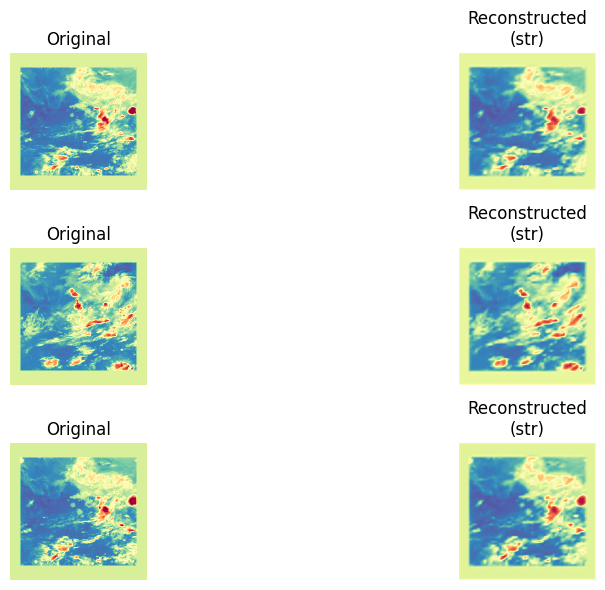

Epoch 8/30: 100%|██████████| 13/13 [00:03<00:00,  3.42it/s]


Epoch [8/30] | AE Loss: 0.0087 | D Loss: 0.1968 | PSNR: 26.97 | SSIM: 0.8156


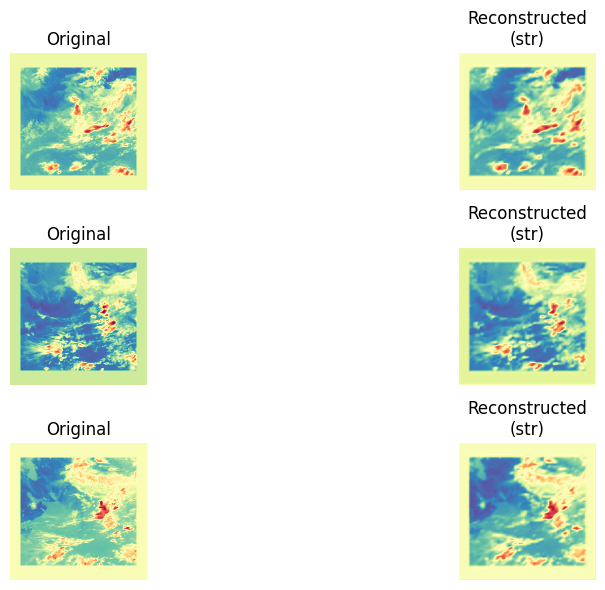

Epoch 9/30: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]


Epoch [9/30] | AE Loss: 0.0080 | D Loss: 0.1117 | PSNR: 27.49 | SSIM: 0.8372


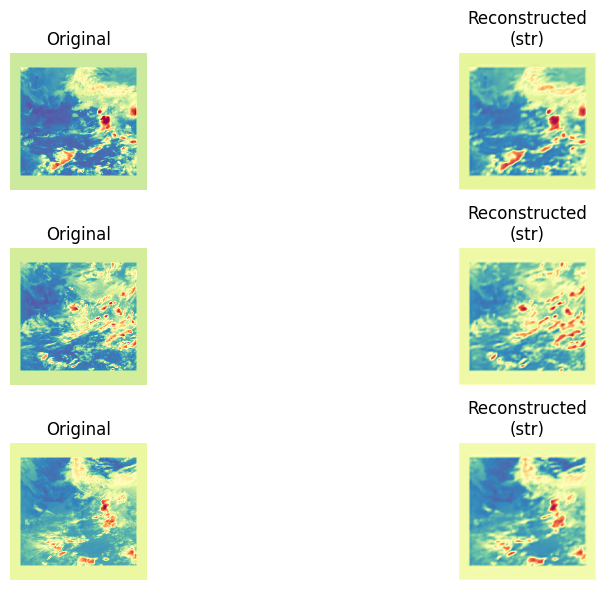

Epoch 10/30: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]


Epoch [10/30] | AE Loss: 0.0073 | D Loss: 0.0900 | PSNR: 27.80 | SSIM: 0.8514


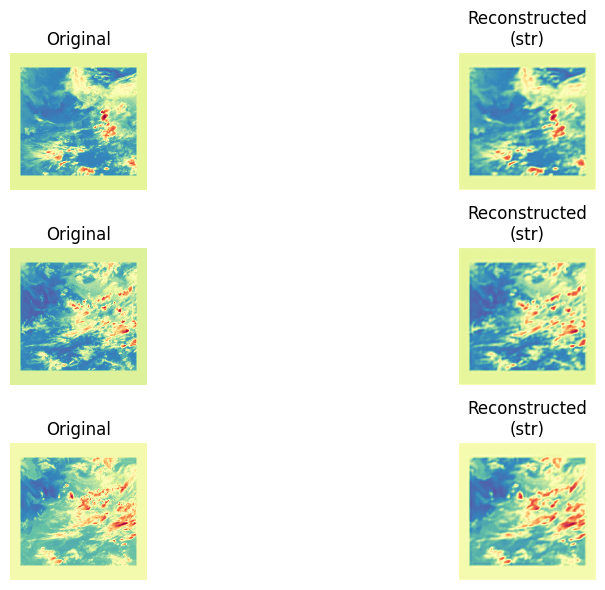

Epoch 11/30: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]


Epoch [11/30] | AE Loss: 0.0068 | D Loss: 0.0727 | PSNR: 28.08 | SSIM: 0.8615


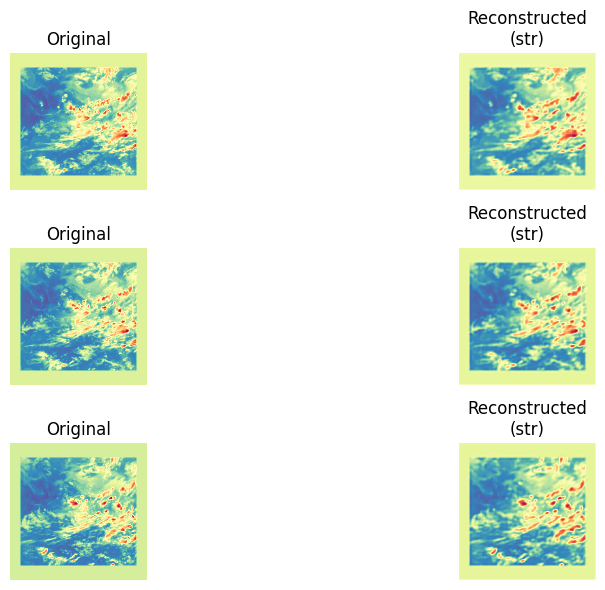

Epoch 12/30: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]


Epoch [12/30] | AE Loss: 0.0064 | D Loss: 0.1982 | PSNR: 28.33 | SSIM: 0.8693


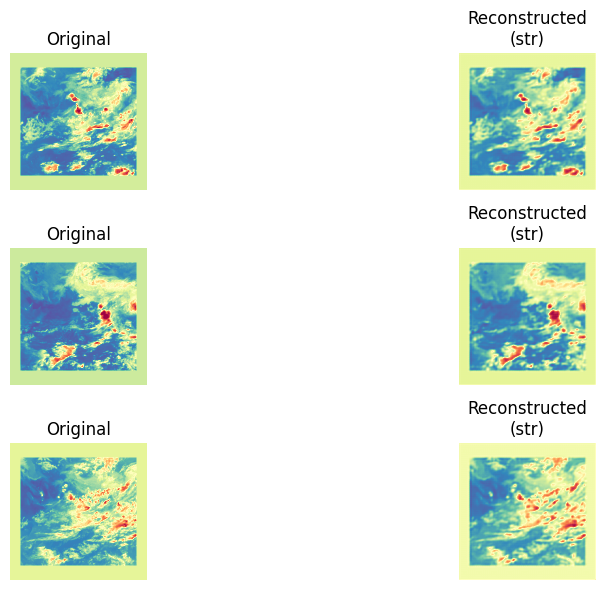

Epoch 13/30: 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]


Epoch [13/30] | AE Loss: 0.0061 | D Loss: 0.1195 | PSNR: 28.55 | SSIM: 0.8777


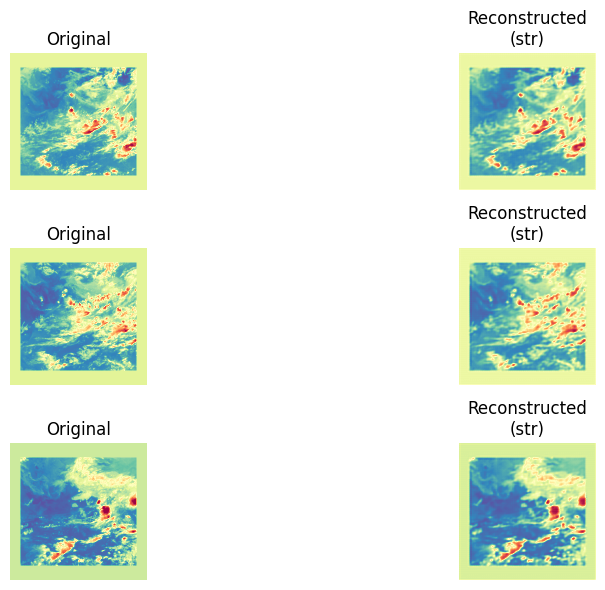

Epoch 14/30: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]


Epoch [14/30] | AE Loss: 0.0059 | D Loss: 0.1031 | PSNR: 28.75 | SSIM: 0.8843


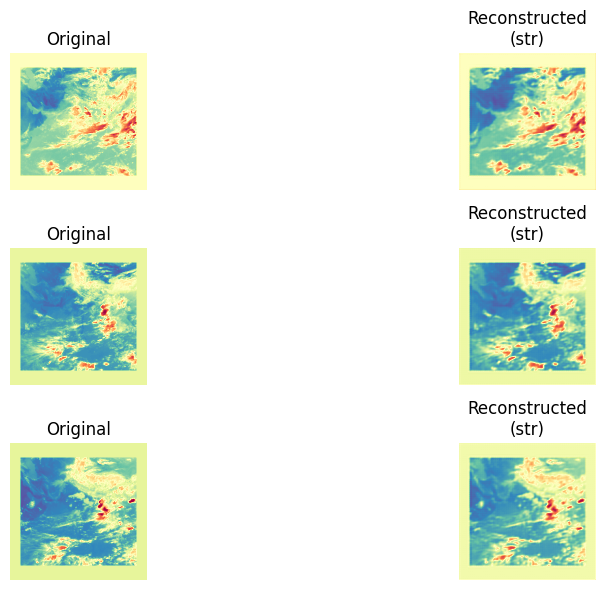

Epoch 15/30: 100%|██████████| 13/13 [00:03<00:00,  3.43it/s]


Epoch [15/30] | AE Loss: 0.0057 | D Loss: 0.0680 | PSNR: 28.91 | SSIM: 0.8892


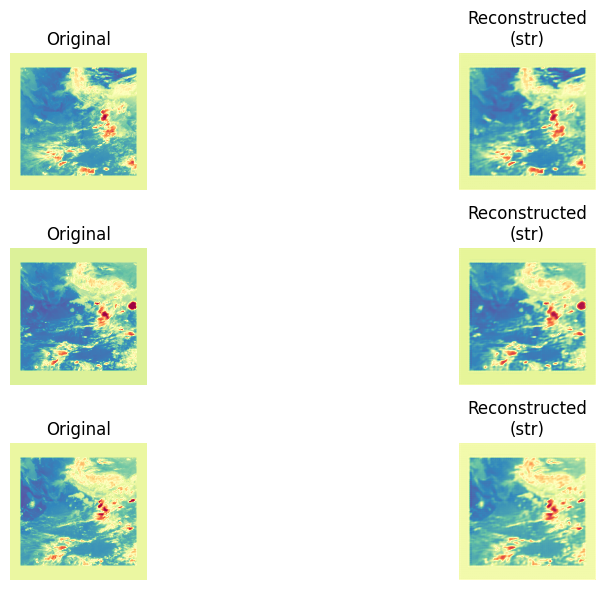

Epoch 16/30: 100%|██████████| 13/13 [00:03<00:00,  3.42it/s]


Epoch [16/30] | AE Loss: 0.0056 | D Loss: 0.0603 | PSNR: 28.94 | SSIM: 0.8935


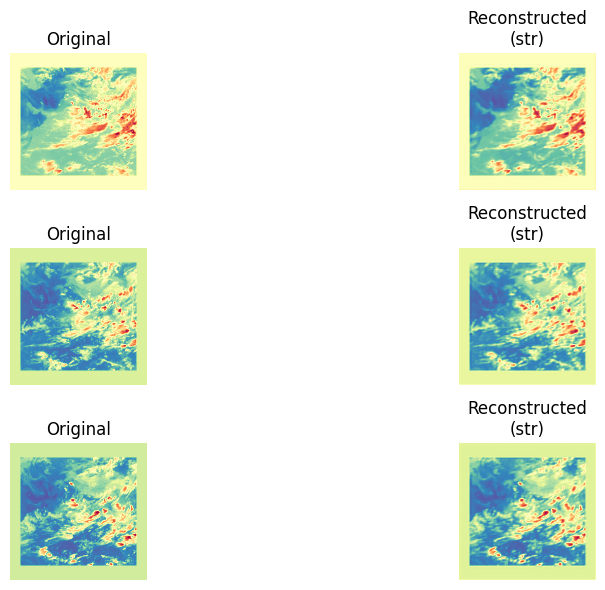

Epoch 17/30: 100%|██████████| 13/13 [00:03<00:00,  3.35it/s]


Epoch [17/30] | AE Loss: 0.0055 | D Loss: 0.0378 | PSNR: 29.12 | SSIM: 0.8970


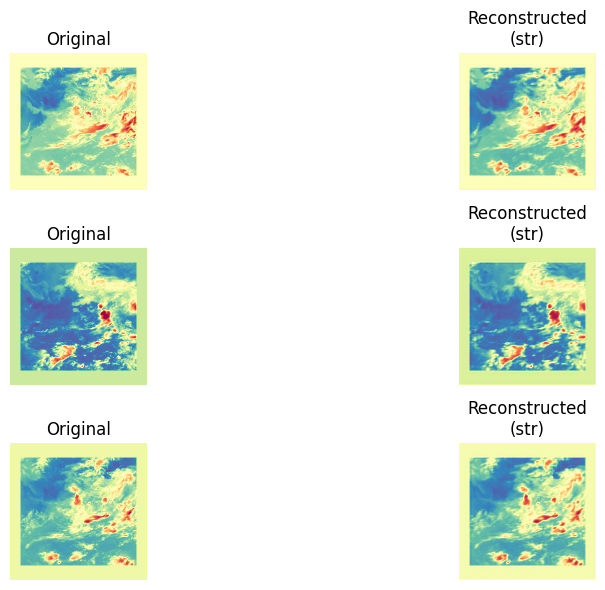

Epoch 18/30: 100%|██████████| 13/13 [00:03<00:00,  3.31it/s]


Epoch [18/30] | AE Loss: 0.0054 | D Loss: 0.0274 | PSNR: 29.19 | SSIM: 0.8984


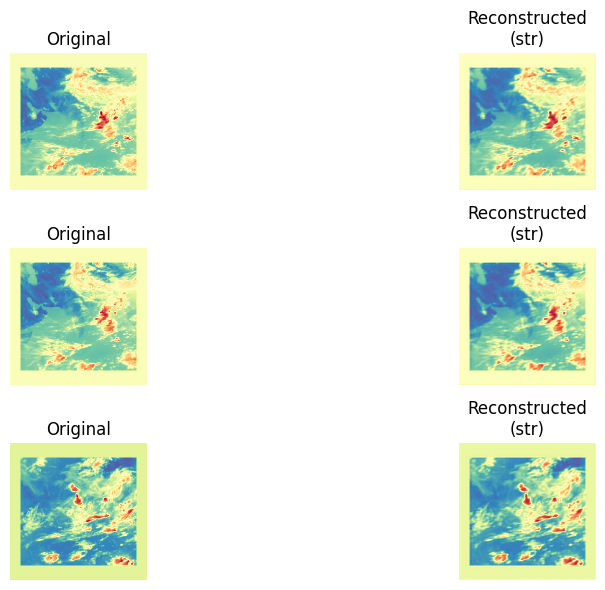

Epoch 19/30: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s]


Epoch [19/30] | AE Loss: 0.0053 | D Loss: 0.0249 | PSNR: 29.33 | SSIM: 0.9031


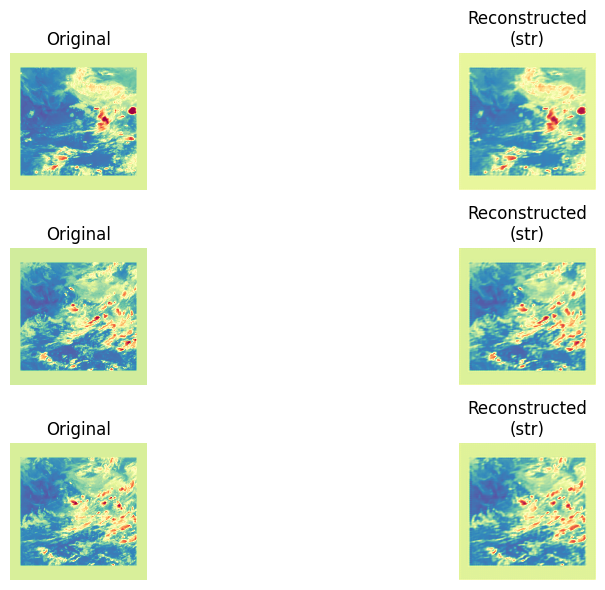

Epoch 20/30: 100%|██████████| 13/13 [00:03<00:00,  3.26it/s]


Epoch [20/30] | AE Loss: 0.0051 | D Loss: 0.0240 | PSNR: 29.41 | SSIM: 0.9064


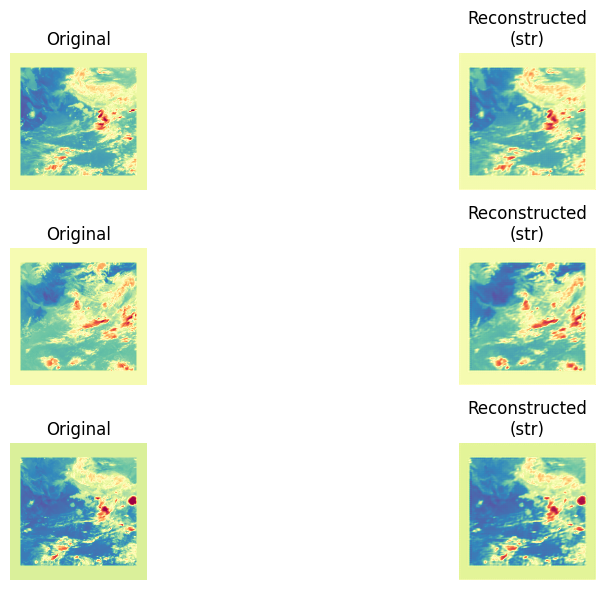

Epoch 21/30: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s]


Epoch [21/30] | AE Loss: 0.0051 | D Loss: 0.0270 | PSNR: 29.53 | SSIM: 0.9078


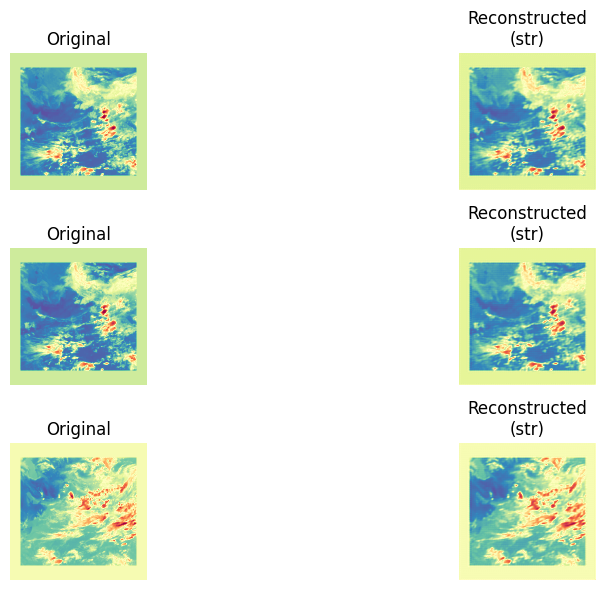

Epoch 22/30: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s]


Epoch [22/30] | AE Loss: 0.0049 | D Loss: 0.0236 | PSNR: 29.56 | SSIM: 0.9135


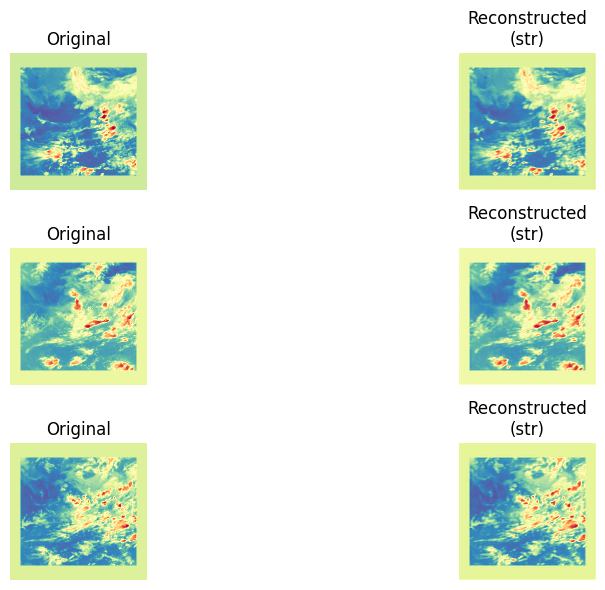

Epoch 23/30: 100%|██████████| 13/13 [00:03<00:00,  3.26it/s]


Epoch [23/30] | AE Loss: 0.0048 | D Loss: 0.4444 | PSNR: 29.78 | SSIM: 0.9162


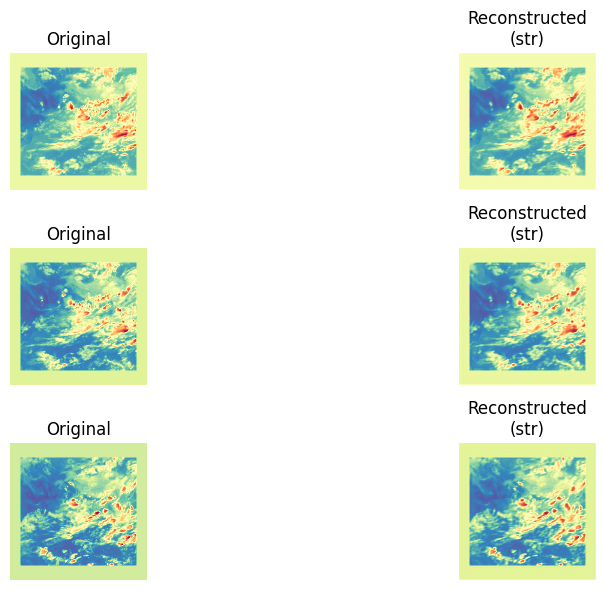

Epoch 24/30: 100%|██████████| 13/13 [00:03<00:00,  3.28it/s]


Epoch [24/30] | AE Loss: 0.0045 | D Loss: 0.4251 | PSNR: 29.88 | SSIM: 0.9184


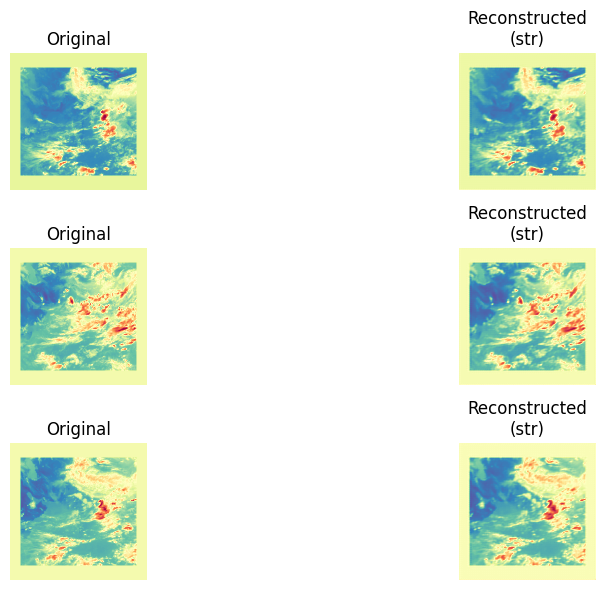

Epoch 25/30: 100%|██████████| 13/13 [00:03<00:00,  3.28it/s]


Epoch [25/30] | AE Loss: 0.0044 | D Loss: 0.2485 | PSNR: 29.96 | SSIM: 0.9191


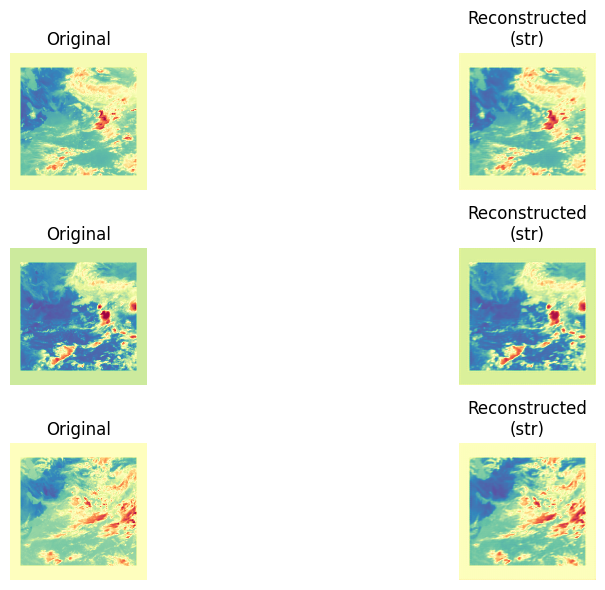

Epoch 26/30: 100%|██████████| 13/13 [00:03<00:00,  3.31it/s]


Epoch [26/30] | AE Loss: 0.0043 | D Loss: 0.1439 | PSNR: 30.06 | SSIM: 0.9217


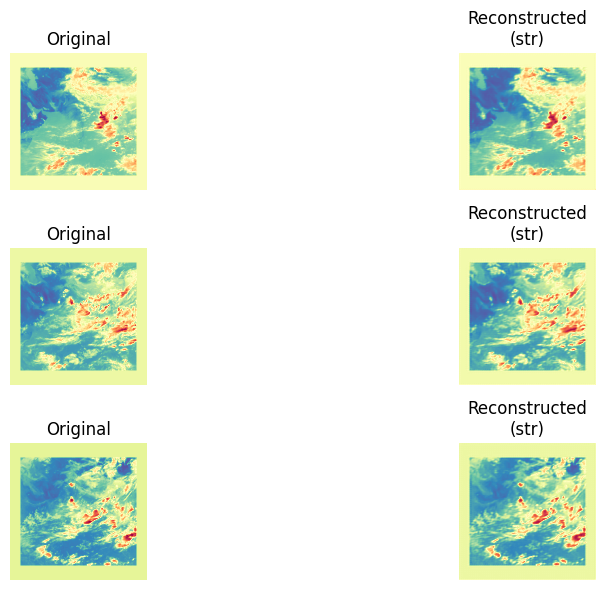

Epoch 27/30: 100%|██████████| 13/13 [00:03<00:00,  3.32it/s]


Epoch [27/30] | AE Loss: 0.0043 | D Loss: 0.0845 | PSNR: 30.09 | SSIM: 0.9225


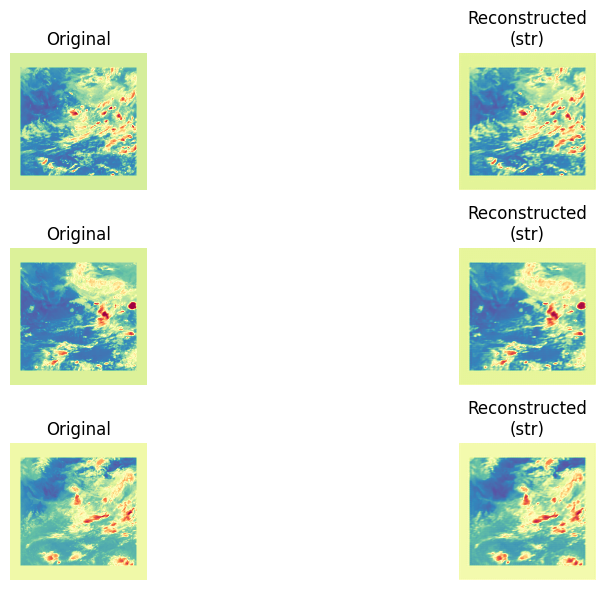

Epoch 28/30: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]


Epoch [28/30] | AE Loss: 0.0043 | D Loss: 0.0603 | PSNR: 30.11 | SSIM: 0.9238


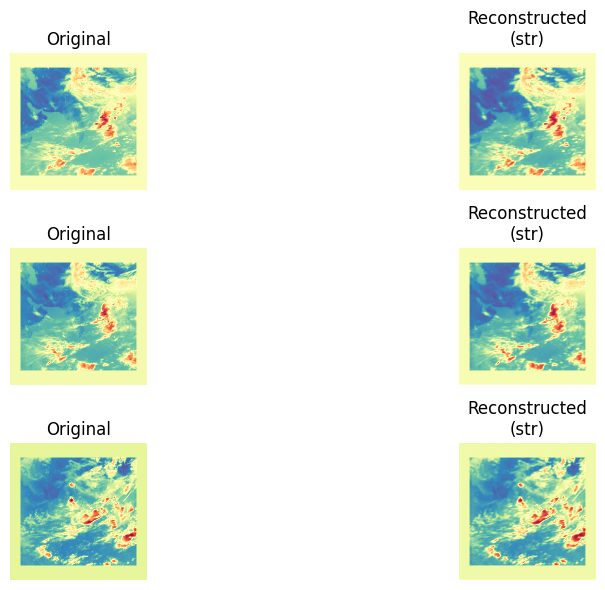

Epoch 29/30: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]


Epoch [29/30] | AE Loss: 0.0043 | D Loss: 0.0466 | PSNR: 30.16 | SSIM: 0.9247


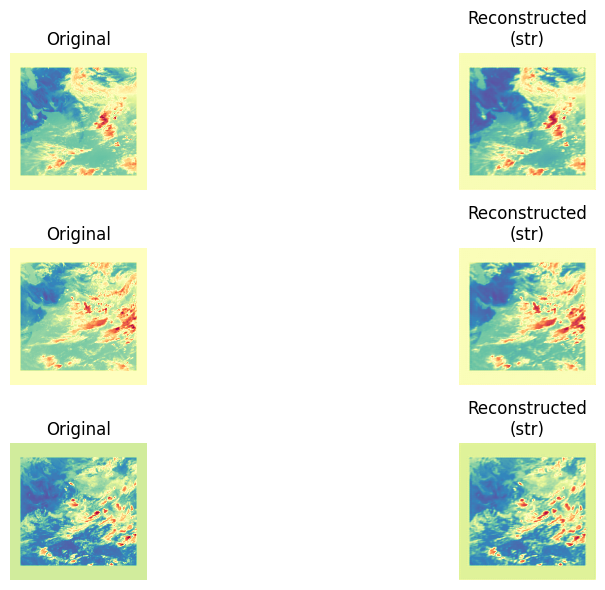

Epoch 30/30: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]


Epoch [30/30] | AE Loss: 0.0044 | D Loss: 0.0634 | PSNR: 29.96 | SSIM: 0.9255


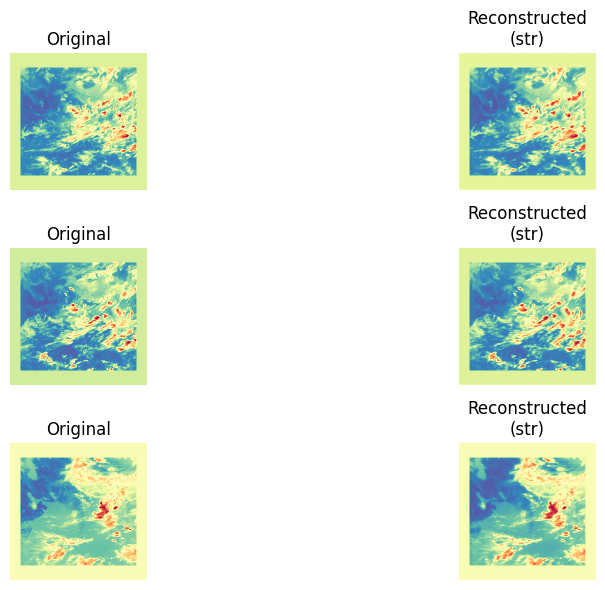

In [105]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
EPOCHS = 30

ae = ConvAE().to(device)
d = PatchedDiscriminator().to(device)

optim_ae = torch.optim.Adam(ae.parameters(), lr=1e-3, weight_decay=1e-4)
optim_d = torch.optim.Adam(d.parameters(), lr=1e-3, weight_decay=1e-4)

bce = nn.BCEWithLogitsLoss()
mse = nn.MSELoss()

lamda_rec, lamda_adv = 1.0, 0.0001

metrics = ['Reconstruction Loss', 'PSNR', 'SSIM']
metrics_df = pd.DataFrame(columns=metrics)

for epoch in range(EPOCHS):
    tot_ae_loss = 0.0
    tot_d_loss = 0.0
    tot_psnr = 0.0
    tot_ssim = 0.0
    
    ae.train()
    d.train()

    for X in tqdm(loader, desc=f'Epoch {epoch+1}/{EPOCHS}'):
        X = X.to(device)
        
        with torch.no_grad():
            fake_images = ae(X)[0]
        
        real_pred = d(X)
        fake_pred = d(fake_images.detach())

        d_loss_real = bce(real_pred, torch.ones_like(real_pred))
        d_loss_fake = bce(fake_pred, torch.zeros_like(fake_pred))
        d_loss_net = 0.5 * (d_loss_real + d_loss_fake)

        optim_d.zero_grad()
        d_loss_net.backward()
        optim_d.step()

        tot_d_loss += d_loss_net.item()
        
        fake_images = ae(X)[0]
        fake_pred = d(fake_images)

        ae_recon_loss = mse(fake_images, X)
        ae_adv_loss = bce(fake_pred, torch.ones_like(fake_pred))
        ae_net_loss = lamda_rec * ae_recon_loss + lamda_adv * ae_adv_loss

        optim_ae.zero_grad()
        ae_net_loss.backward()
        optim_ae.step()

        tot_ae_loss += ae_net_loss.item()
        
    mae_tot, psnr_tot, ssim_tot = 0, 0, 0
    
    with torch.no_grad():
        for X in loader:
            X = X.to(device)
            y_pred = ae(X)[0]

            y_pred_n = (y_pred + 1) / 2
            X_n = (X + 1) / 2
            
            psnr_tot += piq.psnr(y_pred_n, X_n, data_range=1.0).item()
            ssim_tot += piq.ssim(y_pred_n, X_n, data_range=1.0).item()


    avg_ae_loss = tot_ae_loss / len(loader)
    avg_d_loss = tot_d_loss / len(loader)
    avg_psnr = psnr_tot / len(loader)
    avg_ssim = ssim_tot / len(loader)

    print(f"Epoch [{epoch+1}/{EPOCHS}] "
          f"| AE Loss: {avg_ae_loss:.4f} "
          f"| D Loss: {avg_d_loss:.4f} "
          f"| PSNR: {avg_psnr:.2f} "
          f"| SSIM: {avg_ssim:.4f}")

    metrics_df.loc[epoch] = [avg_ae_loss, avg_psnr, avg_ssim]
    visualization(ae, loader, ['Reconstruction + Adversarial'], n_samples = 3)


In [104]:
metrics_df

,Reconstruction Loss,PSNR,SSIM
0,0.161454,20.550270,0.538947
1,0.029633,22.758812,0.666032
2,0.021069,24.002789,0.704696
3,0.017221,24.783285,0.720222
4,0.014587,25.322909,0.729740
5,0.012448,25.809689,0.754941
6,0.011207,26.404944,0.789567
7,0.010198,26.695515,0.815941
8,0.009636,26.960415,0.819715
9,0.009447,27.049446,0.817325


Epoch 1/50: 100%|██████████| 13/13 [00:01<00:00, 12.51it/s]


Epoch [1/50] | AE Loss: 0.1170 | D Loss: 0.0000 | PSNR: 21.04 | SSIM: 0.5416


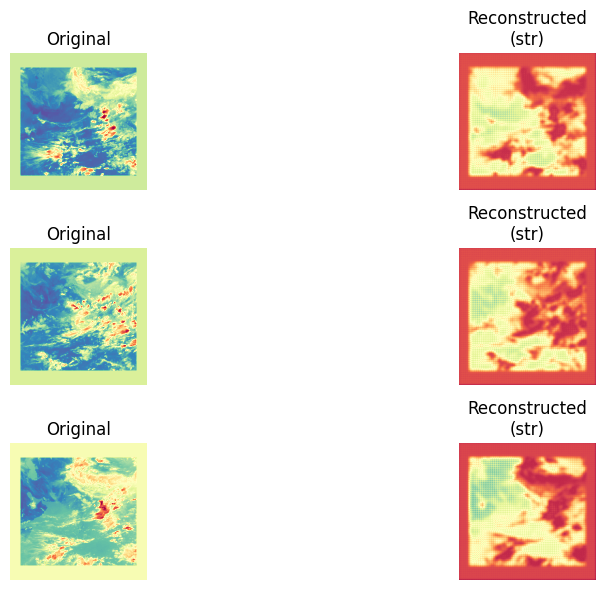

Epoch 2/50: 100%|██████████| 13/13 [00:00<00:00, 13.53it/s]


Epoch [2/50] | AE Loss: 0.0265 | D Loss: 0.0000 | PSNR: 22.96 | SSIM: 0.6807


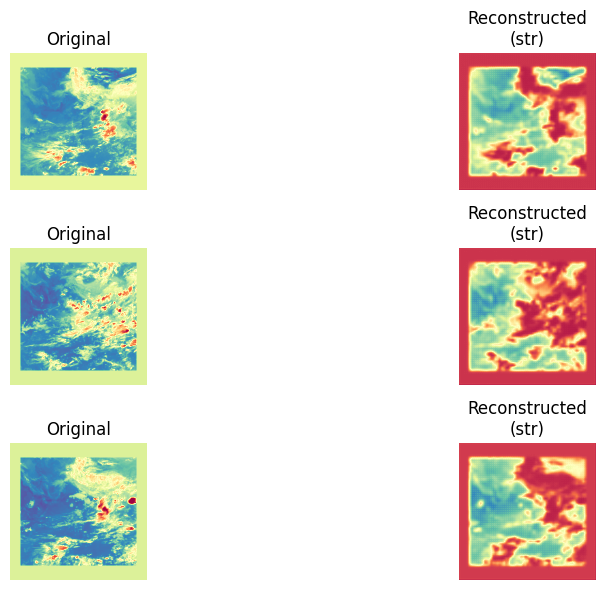

Epoch 3/50: 100%|██████████| 13/13 [00:00<00:00, 13.29it/s]


Epoch [3/50] | AE Loss: 0.0189 | D Loss: 0.0000 | PSNR: 24.06 | SSIM: 0.7078


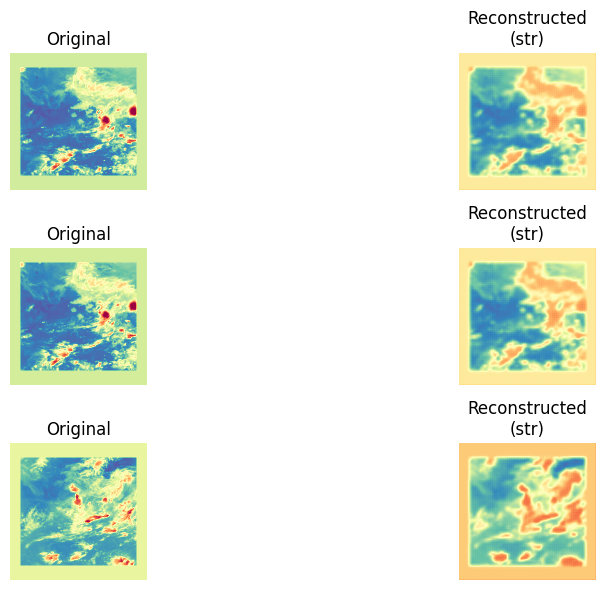

Epoch 4/50: 100%|██████████| 13/13 [00:00<00:00, 13.53it/s]


Epoch [4/50] | AE Loss: 0.0149 | D Loss: 0.0000 | PSNR: 24.82 | SSIM: 0.7255


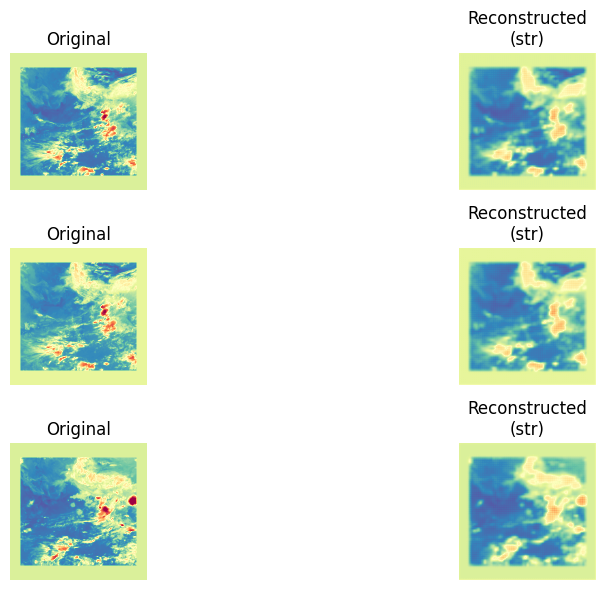

Epoch 5/50: 100%|██████████| 13/13 [00:00<00:00, 13.02it/s]


Epoch [5/50] | AE Loss: 0.0125 | D Loss: 0.0000 | PSNR: 25.66 | SSIM: 0.7495


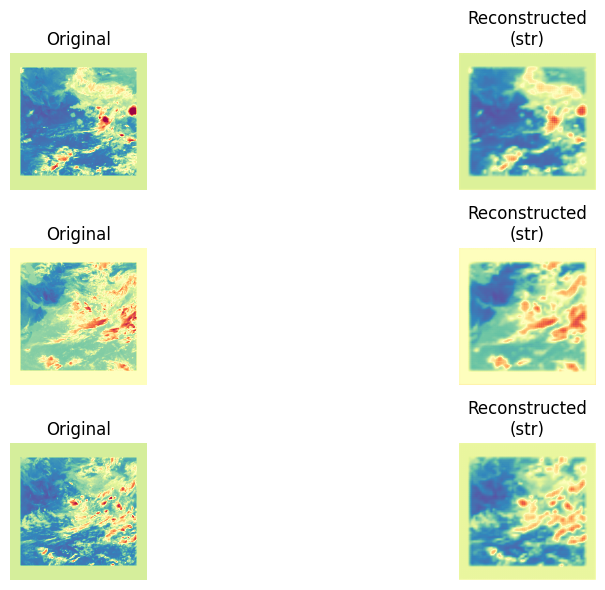

Epoch 6/50: 100%|██████████| 13/13 [00:00<00:00, 13.07it/s]


Epoch [6/50] | AE Loss: 0.0102 | D Loss: 0.0000 | PSNR: 26.44 | SSIM: 0.7855


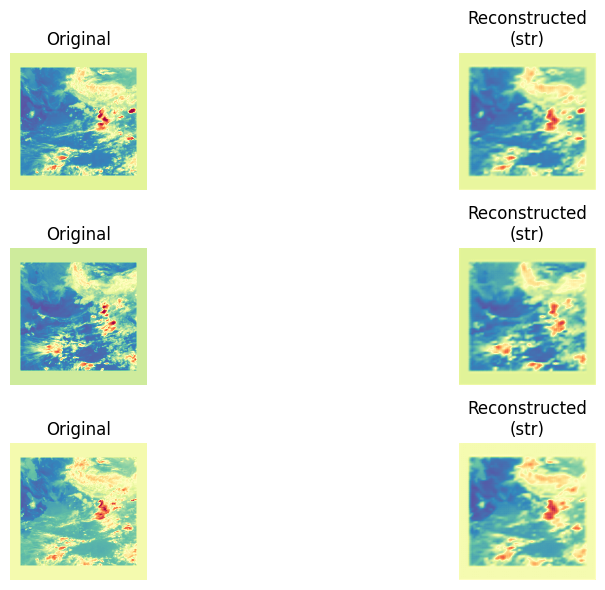

Epoch 7/50: 100%|██████████| 13/13 [00:01<00:00, 12.77it/s]


Epoch [7/50] | AE Loss: 0.0089 | D Loss: 0.0000 | PSNR: 26.80 | SSIM: 0.8041


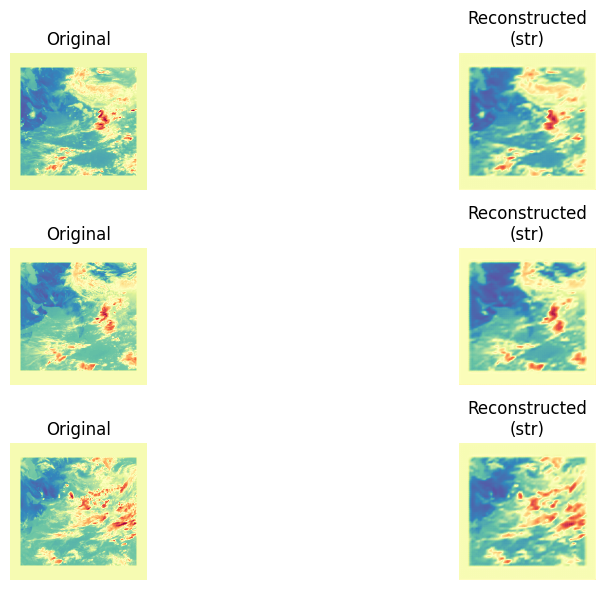

Epoch 8/50: 100%|██████████| 13/13 [00:01<00:00, 12.79it/s]


Epoch [8/50] | AE Loss: 0.0081 | D Loss: 0.0000 | PSNR: 27.20 | SSIM: 0.8209


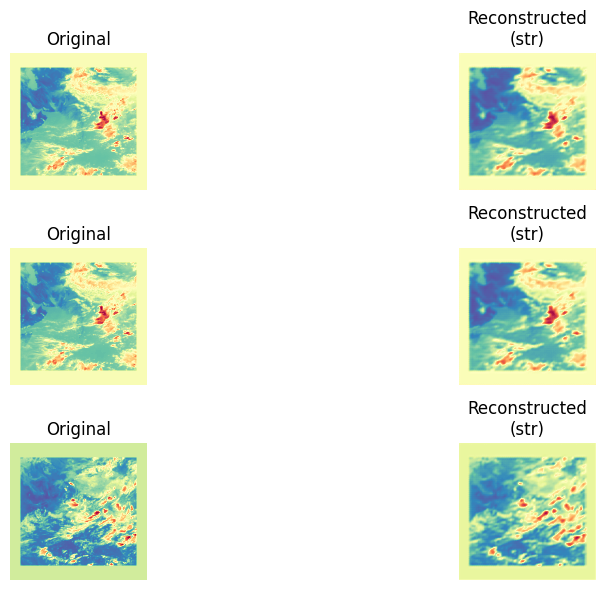

Epoch 9/50: 100%|██████████| 13/13 [00:01<00:00, 12.65it/s]


Epoch [9/50] | AE Loss: 0.0075 | D Loss: 0.0000 | PSNR: 27.54 | SSIM: 0.8354


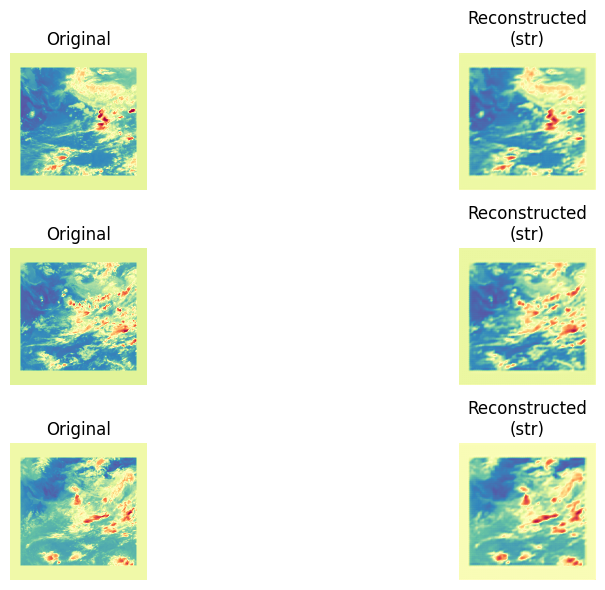

Epoch 10/50: 100%|██████████| 13/13 [00:01<00:00, 12.53it/s]


Epoch [10/50] | AE Loss: 0.0070 | D Loss: 0.0000 | PSNR: 27.81 | SSIM: 0.8457


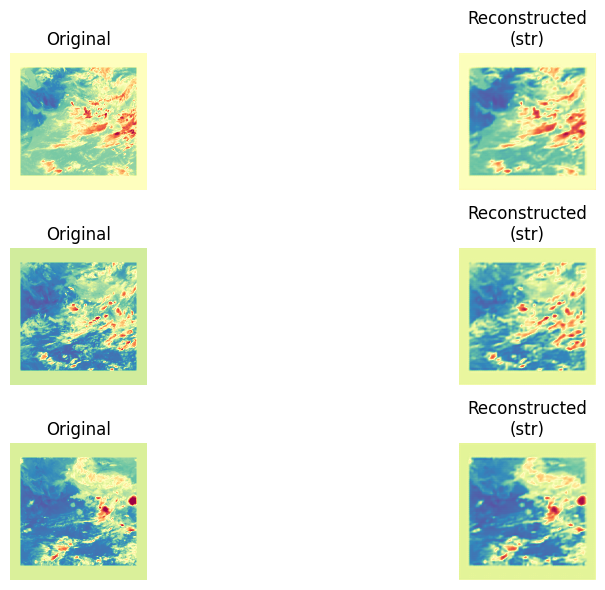

Epoch 11/50: 100%|██████████| 13/13 [00:01<00:00, 12.26it/s]


Epoch [11/50] | AE Loss: 0.0066 | D Loss: 0.0000 | PSNR: 28.05 | SSIM: 0.8558


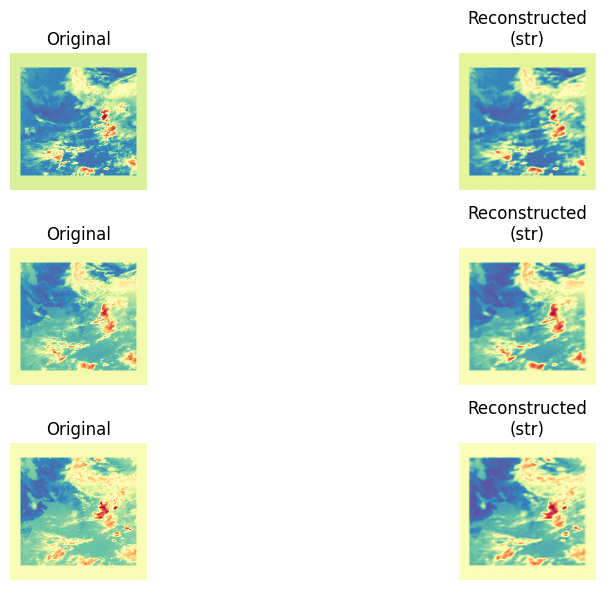

Epoch 12/50: 100%|██████████| 13/13 [00:01<00:00, 12.13it/s]


Epoch [12/50] | AE Loss: 0.0062 | D Loss: 0.0000 | PSNR: 28.34 | SSIM: 0.8660


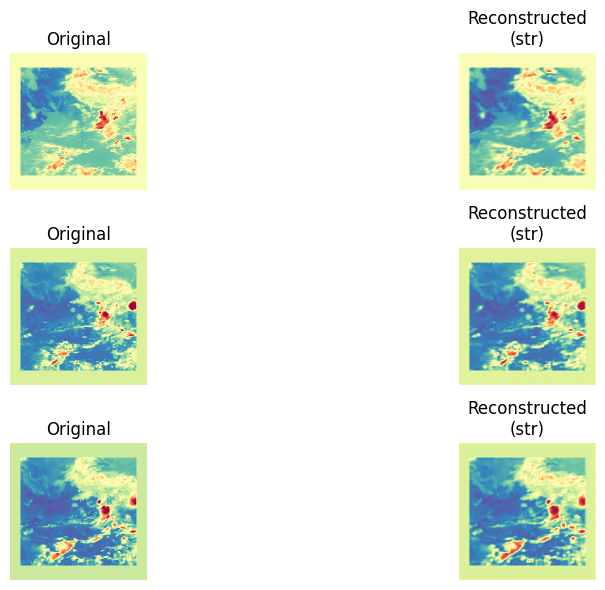

Epoch 13/50: 100%|██████████| 13/13 [00:01<00:00, 11.95it/s]


Epoch [13/50] | AE Loss: 0.0059 | D Loss: 0.0000 | PSNR: 28.46 | SSIM: 0.8741


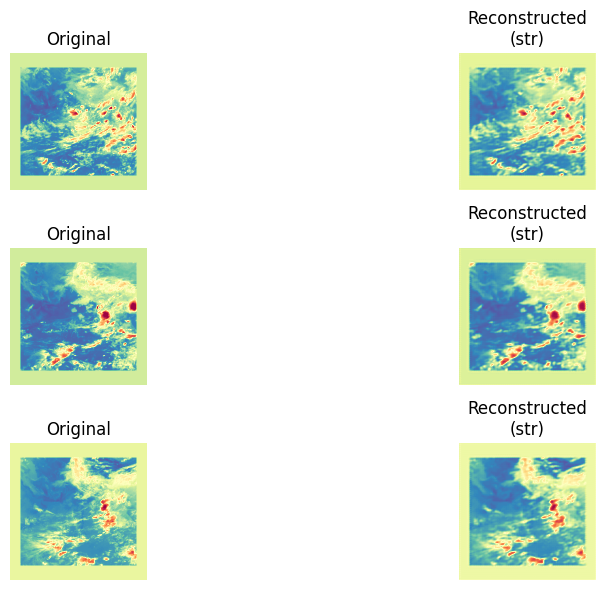

Epoch 14/50: 100%|██████████| 13/13 [00:01<00:00, 11.94it/s]


Epoch [14/50] | AE Loss: 0.0056 | D Loss: 0.0000 | PSNR: 28.72 | SSIM: 0.8819


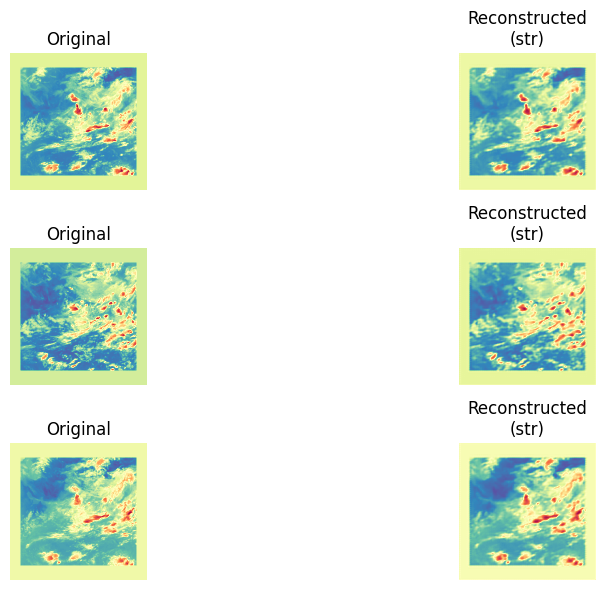

Epoch 15/50: 100%|██████████| 13/13 [00:01<00:00, 11.75it/s]


Epoch [15/50] | AE Loss: 0.0054 | D Loss: 0.0000 | PSNR: 28.92 | SSIM: 0.8876


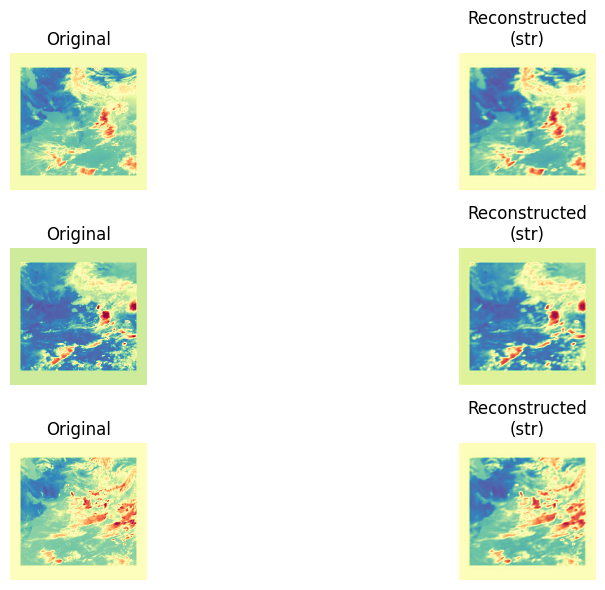

Epoch 16/50: 100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch [16/50] | AE Loss: 0.0059 | D Loss: 0.7038 | PSNR: 29.07 | SSIM: 0.8923


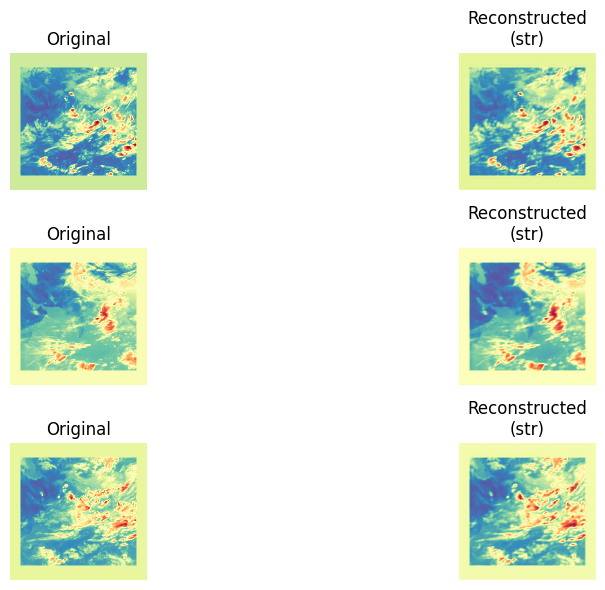

Epoch 17/50: 100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch [17/50] | AE Loss: 0.0057 | D Loss: 0.6925 | PSNR: 29.17 | SSIM: 0.8954


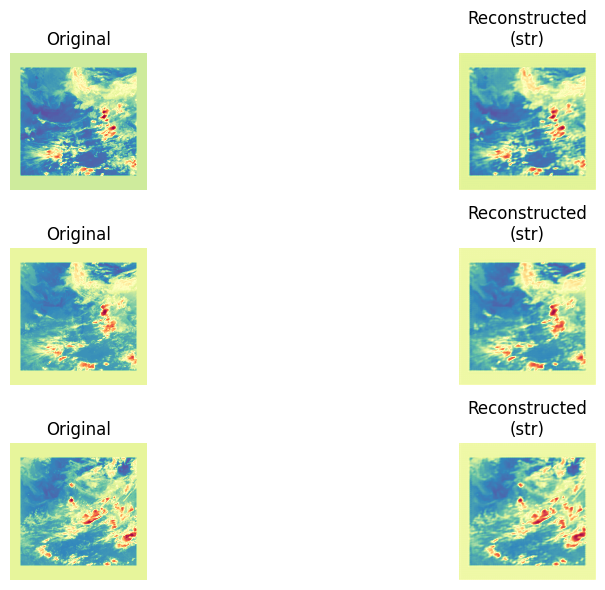

Epoch 18/50: 100%|██████████| 13/13 [00:03<00:00,  4.03it/s]


Epoch [18/50] | AE Loss: 0.0056 | D Loss: 0.6875 | PSNR: 29.03 | SSIM: 0.8986


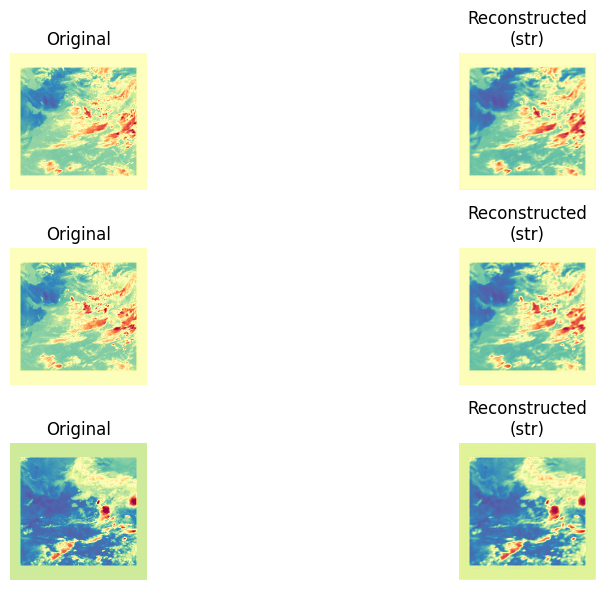

Epoch 19/50: 100%|██████████| 13/13 [00:03<00:00,  4.12it/s]


Epoch [19/50] | AE Loss: 0.0056 | D Loss: 0.6781 | PSNR: 29.37 | SSIM: 0.9007


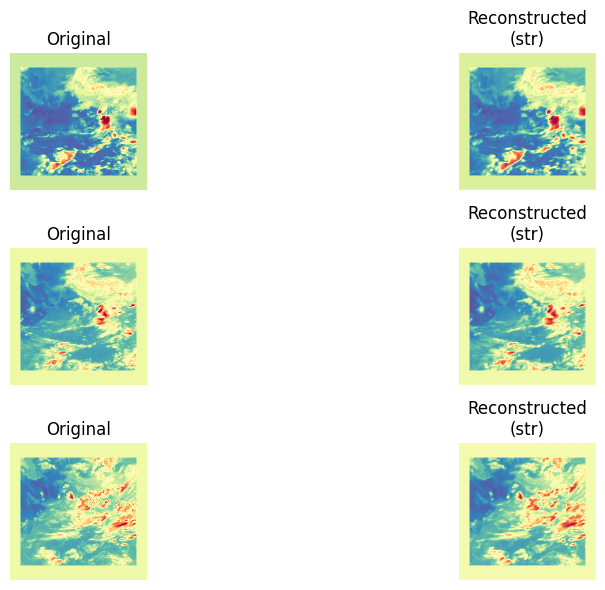

Epoch 20/50: 100%|██████████| 13/13 [00:03<00:00,  4.19it/s]


Epoch [20/50] | AE Loss: 0.0055 | D Loss: 0.6609 | PSNR: 29.39 | SSIM: 0.9025


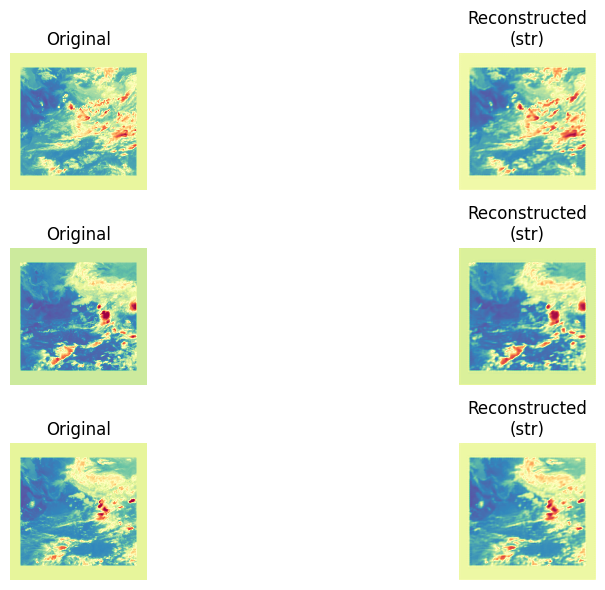

Epoch 21/50: 100%|██████████| 13/13 [00:03<00:00,  4.29it/s]


Epoch [21/50] | AE Loss: 0.0055 | D Loss: 0.6504 | PSNR: 29.43 | SSIM: 0.9039


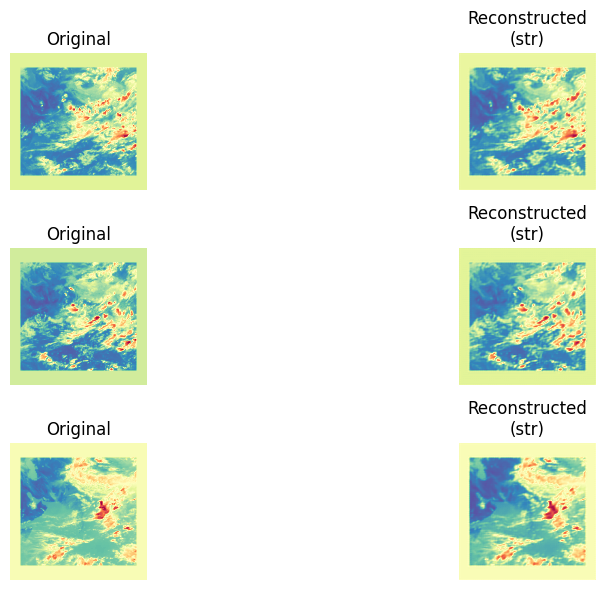

Epoch 22/50: 100%|██████████| 13/13 [00:02<00:00,  4.34it/s]


Epoch [22/50] | AE Loss: 0.0054 | D Loss: 0.6327 | PSNR: 29.43 | SSIM: 0.9046


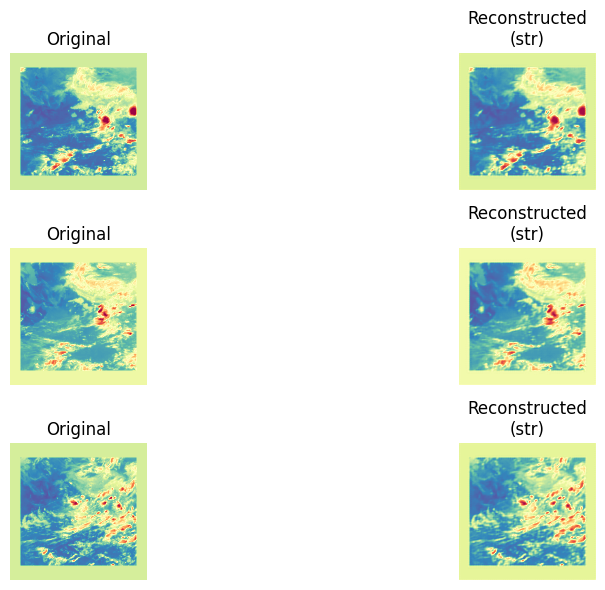

Epoch 23/50: 100%|██████████| 13/13 [00:02<00:00,  4.40it/s]


Epoch [23/50] | AE Loss: 0.0054 | D Loss: 0.6001 | PSNR: 29.52 | SSIM: 0.9057


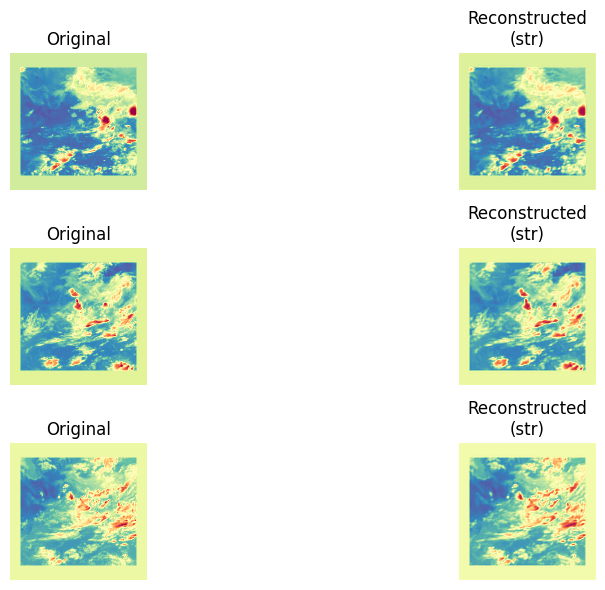

Epoch 24/50: 100%|██████████| 13/13 [00:02<00:00,  4.43it/s]


Epoch [24/50] | AE Loss: 0.0055 | D Loss: 0.5780 | PSNR: 29.45 | SSIM: 0.9059


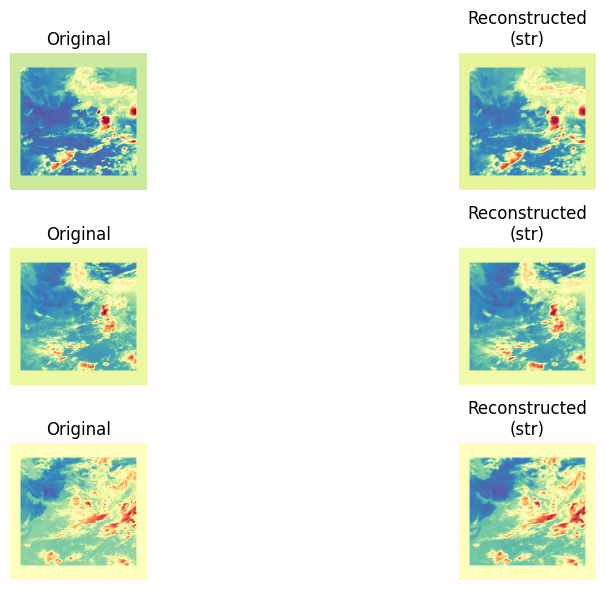

Epoch 25/50: 100%|██████████| 13/13 [00:02<00:00,  4.46it/s]


Epoch [25/50] | AE Loss: 0.0055 | D Loss: 0.5595 | PSNR: 29.51 | SSIM: 0.9067


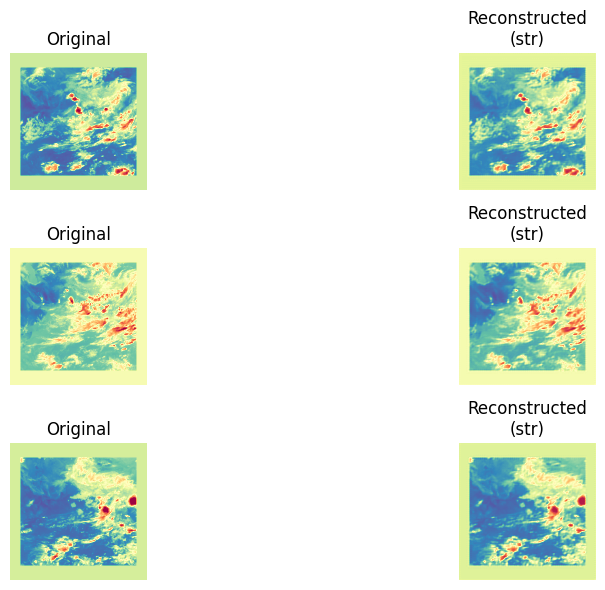

Epoch 26/50: 100%|██████████| 13/13 [00:02<00:00,  4.46it/s]


Epoch [26/50] | AE Loss: 0.0054 | D Loss: 0.5561 | PSNR: 29.59 | SSIM: 0.9066


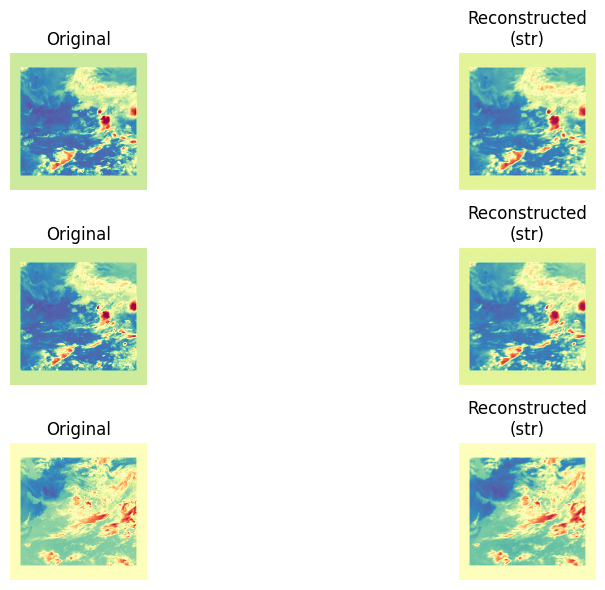

Epoch 27/50: 100%|██████████| 13/13 [00:02<00:00,  4.46it/s]


Epoch [27/50] | AE Loss: 0.0056 | D Loss: 0.5312 | PSNR: 29.47 | SSIM: 0.9065


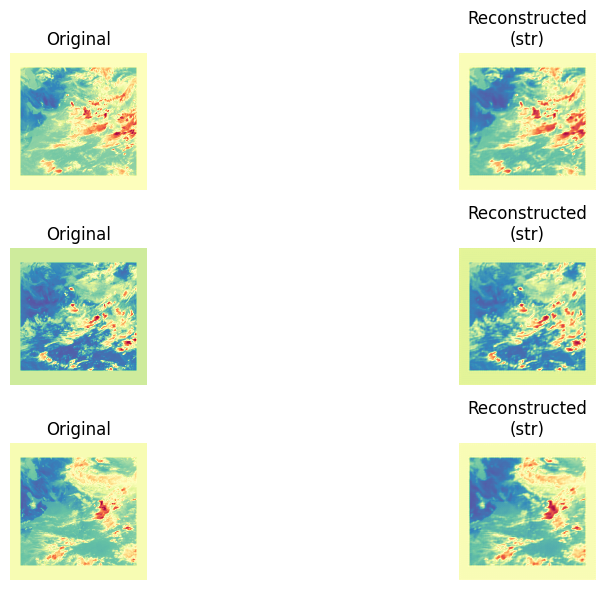

Epoch 28/50: 100%|██████████| 13/13 [00:02<00:00,  4.46it/s]


Epoch [28/50] | AE Loss: 0.0056 | D Loss: 0.5165 | PSNR: 29.46 | SSIM: 0.9054


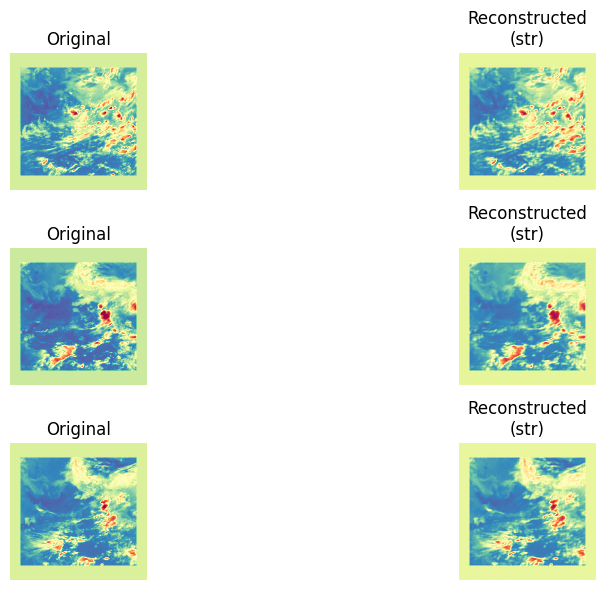

Epoch 29/50: 100%|██████████| 13/13 [00:02<00:00,  4.45it/s]


Epoch [29/50] | AE Loss: 0.0056 | D Loss: 0.4977 | PSNR: 29.60 | SSIM: 0.9075


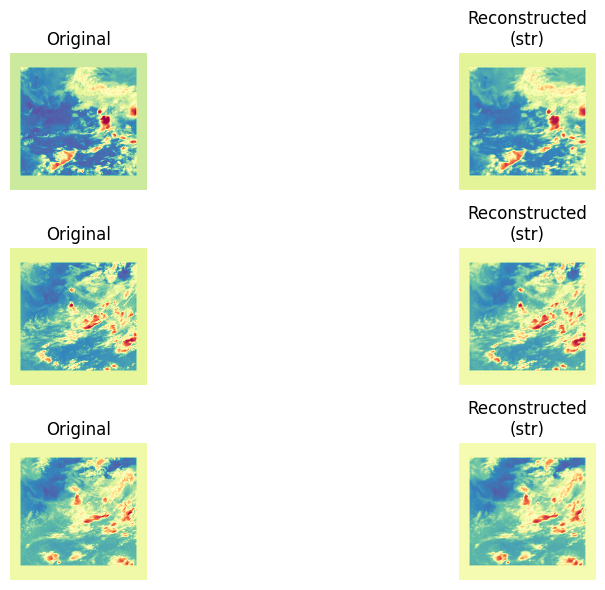

Epoch 30/50: 100%|██████████| 13/13 [00:02<00:00,  4.42it/s]


Epoch [30/50] | AE Loss: 0.0056 | D Loss: 0.4845 | PSNR: 29.50 | SSIM: 0.9051


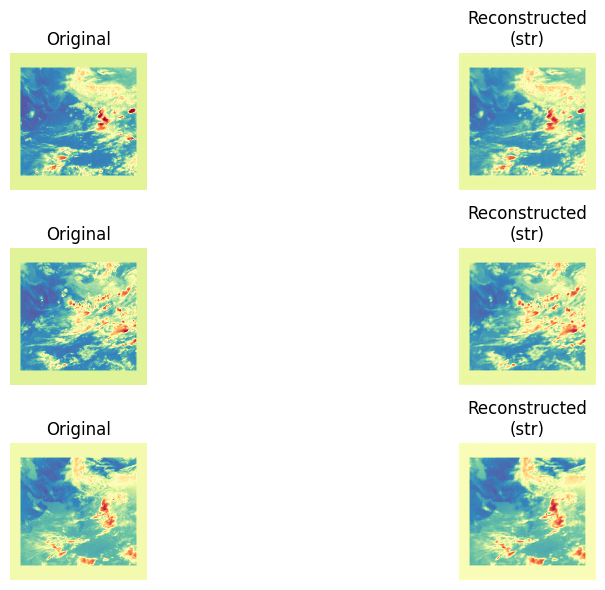

Epoch 31/50: 100%|██████████| 13/13 [00:02<00:00,  4.37it/s]


Epoch [31/50] | AE Loss: 0.0058 | D Loss: 0.4803 | PSNR: 29.27 | SSIM: 0.9028


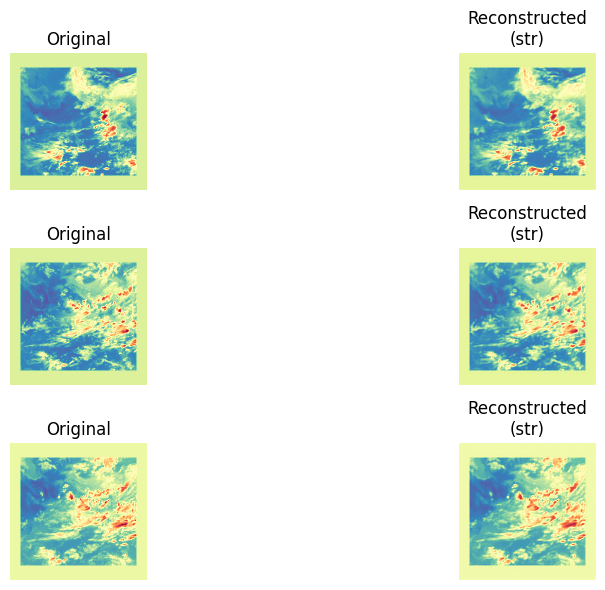

Epoch 32/50: 100%|██████████| 13/13 [00:02<00:00,  4.36it/s]


Epoch [32/50] | AE Loss: 0.0057 | D Loss: 0.4603 | PSNR: 29.52 | SSIM: 0.9039


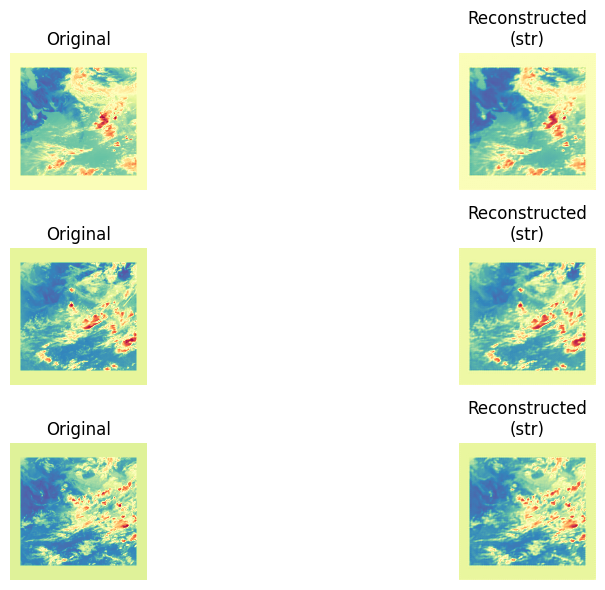

Epoch 33/50: 100%|██████████| 13/13 [00:02<00:00,  4.35it/s]


Epoch [33/50] | AE Loss: 0.0057 | D Loss: 0.4641 | PSNR: 29.53 | SSIM: 0.9086


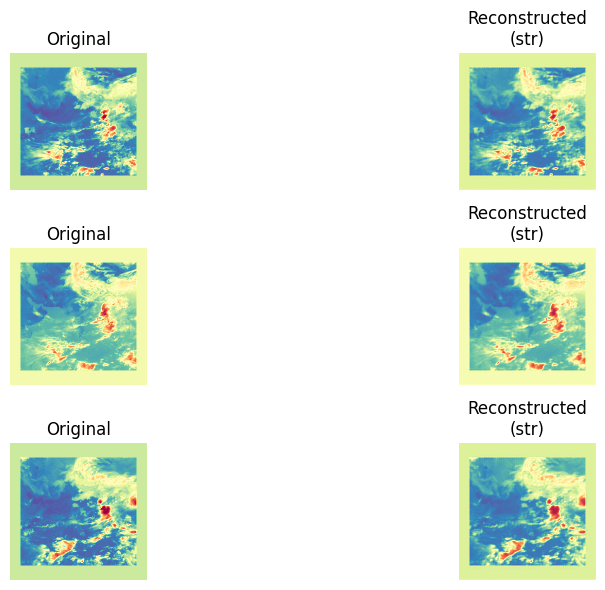

Epoch 34/50: 100%|██████████| 13/13 [00:03<00:00,  4.29it/s]


Epoch [34/50] | AE Loss: 0.0057 | D Loss: 0.4529 | PSNR: 29.47 | SSIM: 0.9069


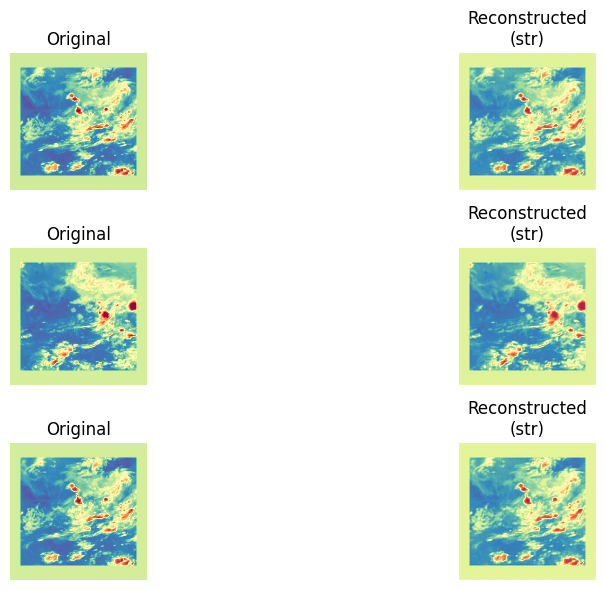

Epoch 35/50: 100%|██████████| 13/13 [00:03<00:00,  4.27it/s]


Epoch [35/50] | AE Loss: 0.0058 | D Loss: 0.4473 | PSNR: 29.43 | SSIM: 0.9059


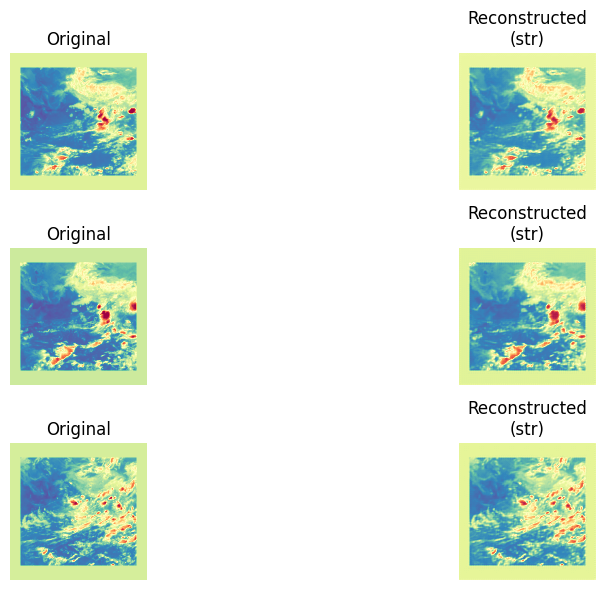

Epoch 36/50: 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]


Epoch [36/50] | AE Loss: 0.0058 | D Loss: 0.4335 | PSNR: 29.47 | SSIM: 0.9142


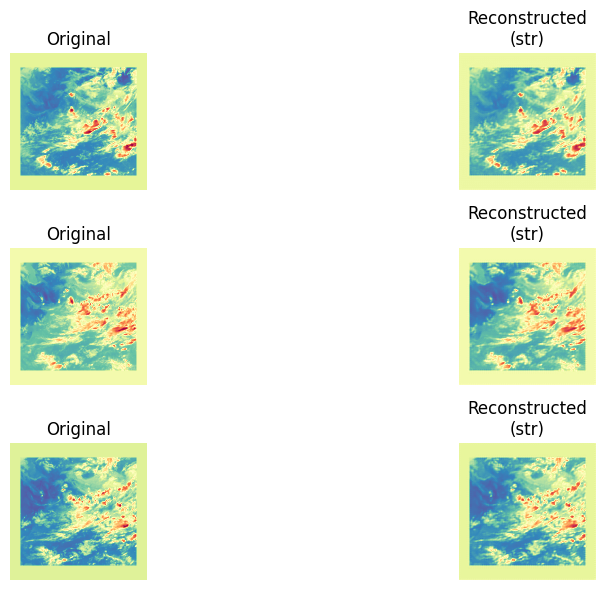

Epoch 37/50: 100%|██████████| 13/13 [00:03<00:00,  4.27it/s]


Epoch [37/50] | AE Loss: 0.0057 | D Loss: 0.4560 | PSNR: 29.59 | SSIM: 0.9142


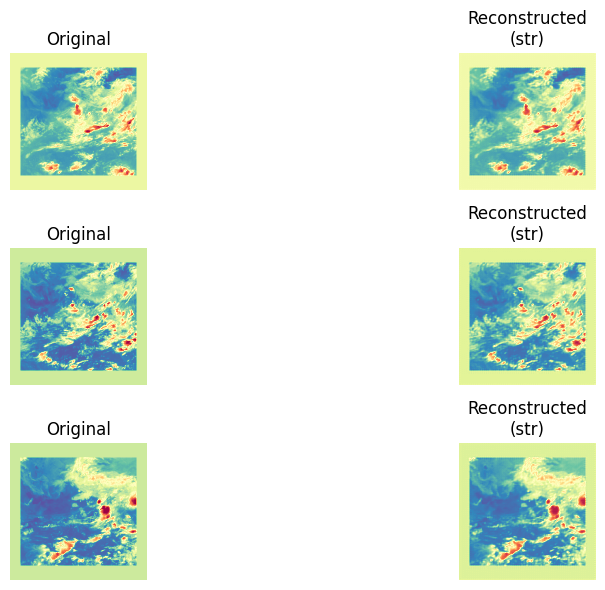

Epoch 38/50: 100%|██████████| 13/13 [00:03<00:00,  4.23it/s]


Epoch [38/50] | AE Loss: 0.0057 | D Loss: 0.4315 | PSNR: 29.56 | SSIM: 0.9156


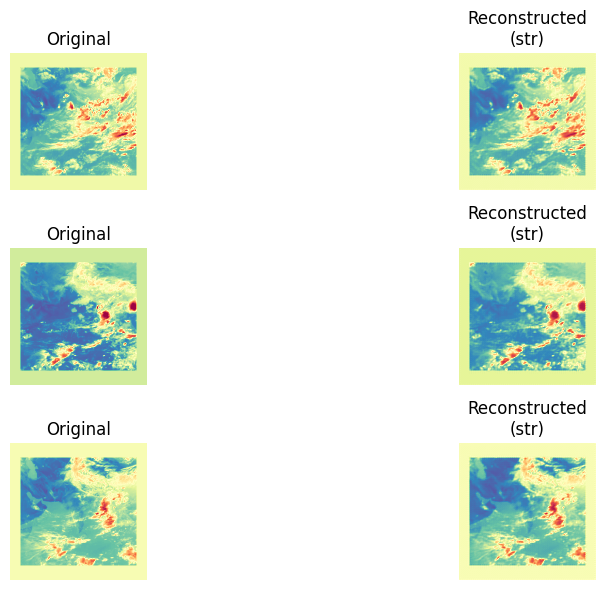

Epoch 39/50: 100%|██████████| 13/13 [00:03<00:00,  4.23it/s]


Epoch [39/50] | AE Loss: 0.0058 | D Loss: 0.4599 | PSNR: 29.29 | SSIM: 0.9084


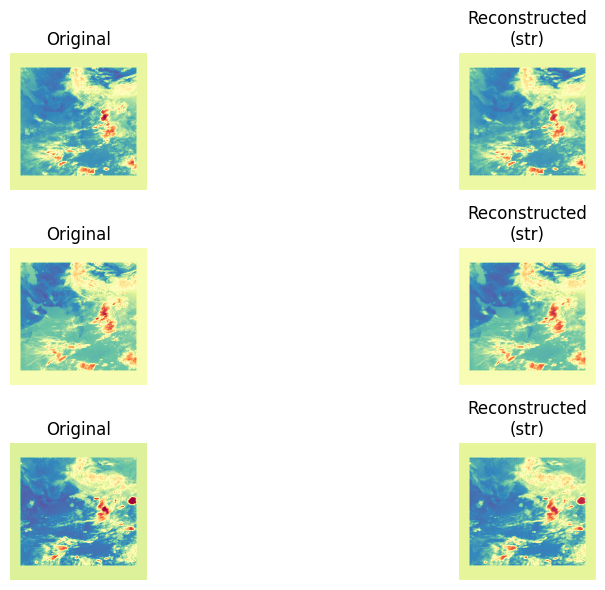

Epoch 40/50: 100%|██████████| 13/13 [00:03<00:00,  4.22it/s]


Epoch [40/50] | AE Loss: 0.0058 | D Loss: 0.4386 | PSNR: 29.71 | SSIM: 0.9179


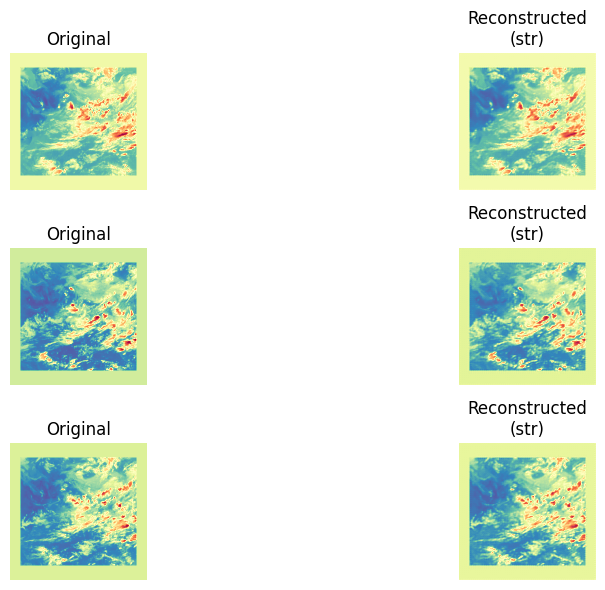

Epoch 41/50: 100%|██████████| 13/13 [00:03<00:00,  4.21it/s]


Epoch [41/50] | AE Loss: 0.0056 | D Loss: 0.4486 | PSNR: 29.55 | SSIM: 0.9185


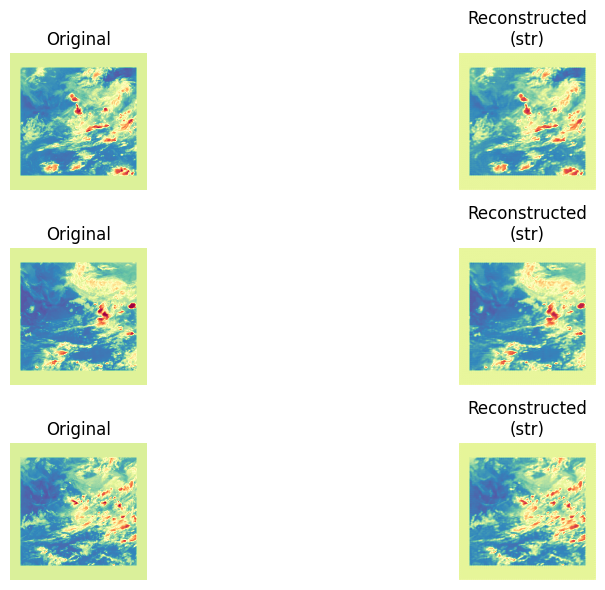

Epoch 42/50: 100%|██████████| 13/13 [00:03<00:00,  4.22it/s]


Epoch [42/50] | AE Loss: 0.0058 | D Loss: 0.4388 | PSNR: 29.61 | SSIM: 0.9177


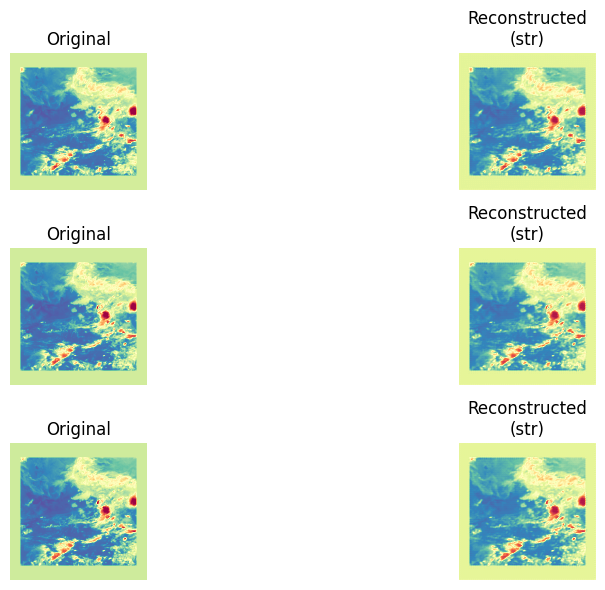

Epoch 43/50: 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]


Epoch [43/50] | AE Loss: 0.0056 | D Loss: 0.4437 | PSNR: 29.54 | SSIM: 0.9160


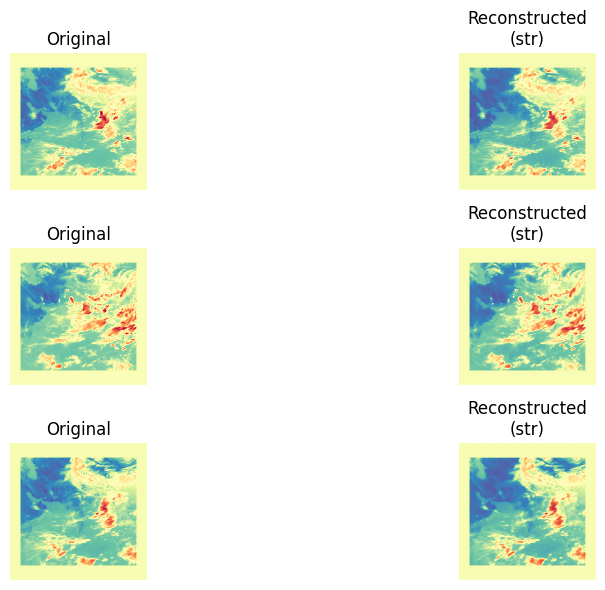

Epoch 44/50: 100%|██████████| 13/13 [00:03<00:00,  4.27it/s]


Epoch [44/50] | AE Loss: 0.0058 | D Loss: 0.4662 | PSNR: 29.37 | SSIM: 0.9124


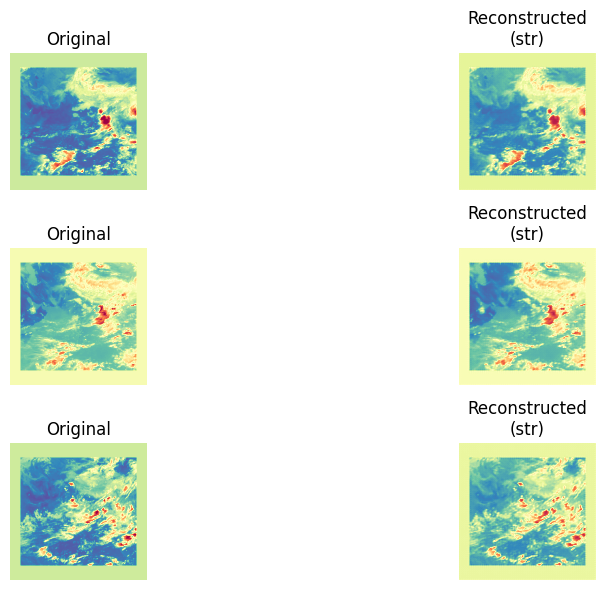

Epoch 45/50: 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]


Epoch [45/50] | AE Loss: 0.0058 | D Loss: 0.4609 | PSNR: 29.49 | SSIM: 0.9122


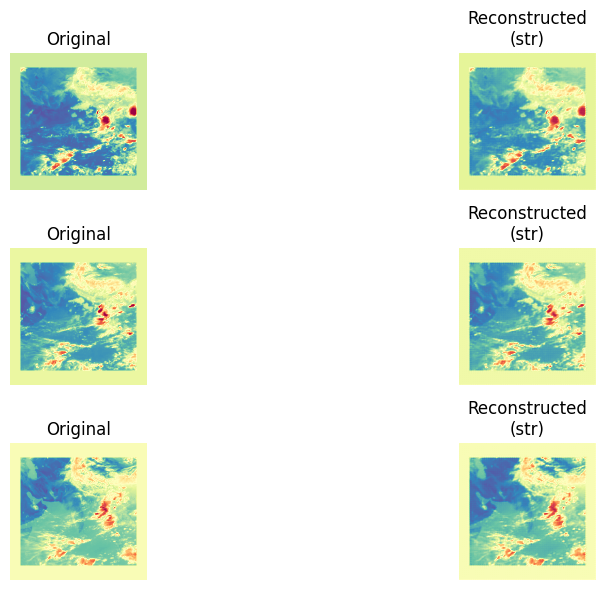

Epoch 46/50: 100%|██████████| 13/13 [00:03<00:00,  4.28it/s]


Epoch [46/50] | AE Loss: 0.0057 | D Loss: 0.4886 | PSNR: 29.51 | SSIM: 0.9173


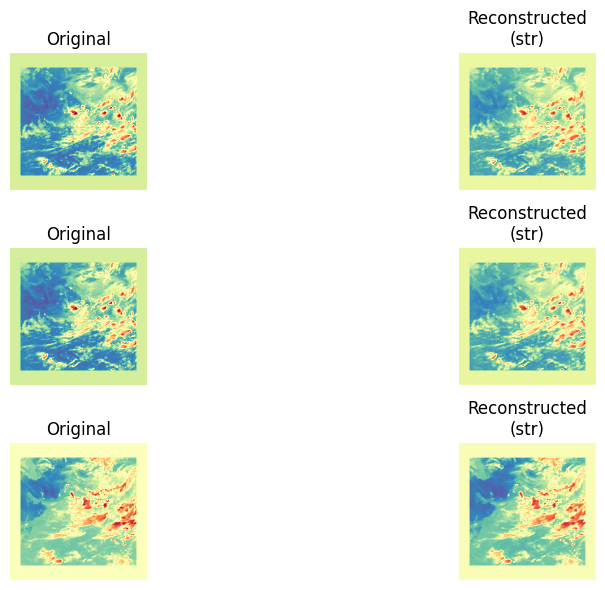

Epoch 47/50: 100%|██████████| 13/13 [00:03<00:00,  4.29it/s]


Epoch [47/50] | AE Loss: 0.0058 | D Loss: 0.4498 | PSNR: 29.53 | SSIM: 0.9122


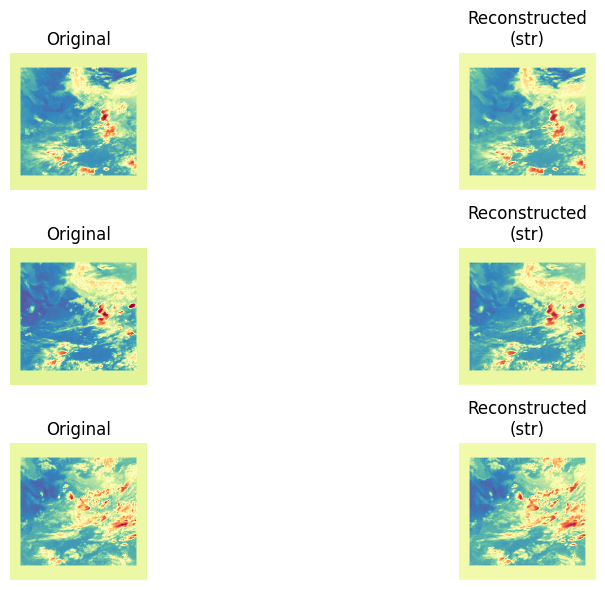

Epoch 48/50: 100%|██████████| 13/13 [00:03<00:00,  4.27it/s]


Epoch [48/50] | AE Loss: 0.0059 | D Loss: 0.4822 | PSNR: 29.42 | SSIM: 0.9163


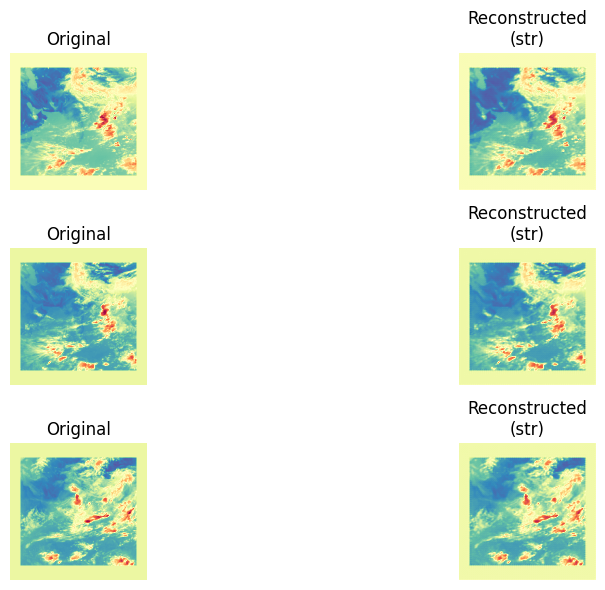

Epoch 49/50: 100%|██████████| 13/13 [00:03<00:00,  4.29it/s]


Epoch [49/50] | AE Loss: 0.0060 | D Loss: 0.5216 | PSNR: 29.24 | SSIM: 0.8979


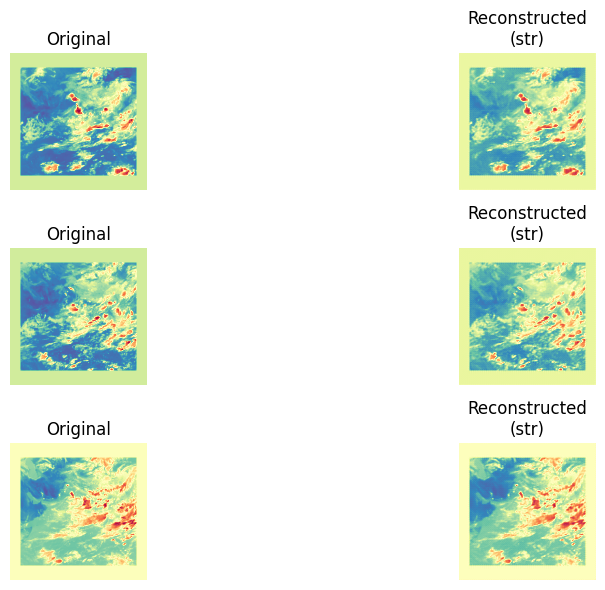

Epoch 50/50: 100%|██████████| 13/13 [00:03<00:00,  4.30it/s]


Epoch [50/50] | AE Loss: 0.0058 | D Loss: 0.4991 | PSNR: 29.60 | SSIM: 0.9107


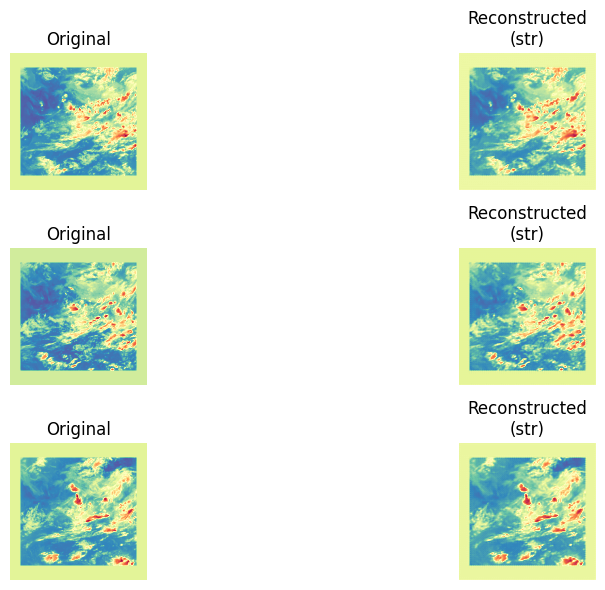

In [115]:
WARMUP_EPOCHS = 15
lamda_rec = 1.0
lamda_adv_full = 0.001

device = 'cuda' if torch.cuda.is_available() else 'cpu'
EPOCHS = 50

ae = ConvAE().to(device)
d = PatchedDiscriminator().to(device)

optim_ae = torch.optim.Adam(ae.parameters(),lr = 1e-3, weight_decay = 1e-4)
optim_d = torch.optim.Adam(d.parameters(),lr = 1e-3, weight_decay = 1e-4)

bce = nn.BCEWithLogitsLoss()
mse = nn.MSELoss()

metrics = ['Reconstruction Loss', 'PSNR', 'SSIM']
metrics_df = pd.DataFrame(columns = metrics)


for epoch in range(EPOCHS):
    tot_ae_loss = 0.0
    tot_d_loss = 0.0
    tot_psnr = 0.0
    tot_ssim = 0.0

    lamda_adv = 0.0 if epoch < WARMUP_EPOCHS else lamda_adv_full

    ae.train()
    d.train()

    for X in tqdm(loader, desc=f'Epoch {epoch+1}/{EPOCHS}'):
        X = X.to(device)

        if epoch >= WARMUP_EPOCHS:
            with torch.no_grad():
                fake_images = ae(X)[0]

            real_pred = d(X)
            fake_pred = d(fake_images.detach())

            d_loss_real = bce(real_pred, torch.ones_like(real_pred))
            d_loss_fake = bce(fake_pred, torch.zeros_like(fake_pred))
            d_loss_net = 0.5 * (d_loss_real + d_loss_fake)

            optim_d.zero_grad()
            d_loss_net.backward()
            optim_d.step()

            tot_d_loss += d_loss_net.item()

        fake_images = ae(X)[0]

        ae_recon_loss = mse(fake_images, X)
        ae_adv_loss = 0.0

        if epoch >= WARMUP_EPOCHS:
            fake_pred = d(fake_images)
            ae_adv_loss = bce(fake_pred, torch.ones_like(fake_pred))

        ae_net_loss = lamda_rec * ae_recon_loss + lamda_adv * ae_adv_loss

        optim_ae.zero_grad()
        ae_net_loss.backward()
        optim_ae.step()

        tot_ae_loss += ae_net_loss.item()


    psnr_tot, ssim_tot = 0, 0
    with torch.no_grad():
        for X in loader:
            X = X.to(device)
            y_pred = ae(X)[0]

            y_pred_n = (y_pred + 1) / 2
            X_n = (X + 1) / 2

            psnr_tot += piq.psnr(y_pred_n, X_n, data_range=1.0).item()
            ssim_tot += piq.ssim(y_pred_n, X_n, data_range=1.0).item()

    avg_ae_loss = tot_ae_loss / len(loader)
    avg_d_loss = tot_d_loss / len(loader) if epoch >= WARMUP_EPOCHS else 0.0
    avg_psnr = psnr_tot / len(loader)
    avg_ssim = ssim_tot / len(loader)

    print(f"Epoch [{epoch+1}/{EPOCHS}] "
          f"| AE Loss: {avg_ae_loss:.4f} "
          f"| D Loss: {avg_d_loss:.4f} "
          f"| PSNR: {avg_psnr:.2f} "
          f"| SSIM: {avg_ssim:.4f}")

    metrics_df.loc[epoch] = [avg_ae_loss, avg_psnr, avg_ssim]
    visualization(ae, loader, ['Reconstruction + Adversarial'], n_samples=3)


## 5.3 VAE
- Variational Auto Encoder is a type of generative model where the overall architecture of auto encoder remains intact with slight modification
- Instead of leaning a fixed deterministic latent representation for a given image, encoder tries to learn a distribution
- In other words for a given image, encoder spits out parameters of distribution
- Decoder then samples from this distribution using reparameterization technique

In [ ]:
class VAE(nn.Module):
    def __init__(self, latent_ch : int = 4):
        super().__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1,64, kernel_size = 3, padding = 1, stride = 2), # 8 x 1 x 512 x 512 -> 8 x 64 x 256 x 256
            nn.ReLU(),
           
            nn.Conv2d(64,128,kernel_size = 3, padding = 1, stride = 2), # 8 x 64 x 256 x 256 -> 8 x 128 x 128 x 128
            nn.ReLU(),
        )
        
        # Latent
        self.mu = nn.Conv2d(128, latent_ch, kernel_size = 3, padding = 1, stride = 2) # 8 x 128 x 128 x 128 -> 8 x 4 x 64 x 64
        
        self.log_var = nn.Conv2d(128, latent_ch, kernel_size = 3, padding = 1, stride = 2) # 8 x 128 x 128 x 128 -> 8 x 4 x 64 x 64

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 128,kernel_size = 3, stride = 2, padding = 1, output_padding = 1),# 8 x 4 x 64 x 64 -> 8 x 128 x 128 x 128
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, kernel_size = 3, stride = 2, padding = 1, output_padding = 1), # 8 x 128 x 128 x 128 -> 8 x 64 x 256 x 256
            nn.ReLU(),

            nn.ConvTranspose2d(64, 1, kernel_size = 3, stride = 2, padding =1, output_padding = 1), # 8 x 64 x 256 x 256 -> 8 x 1 x 512 x 512
            nn.Tanh(),
        )
        
    def encode(self,x):
        h = self.encoder(x)
        return self.mu(h), self.log_var(h)

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5*log_var)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self,x):
        mu,log_var = self.encode(x)
        z = self.reparameterize(mu,log_var)
        return self.decoder(z), mu, log_var
        

In [ ]:
# Sanity Check
recon, mu, log_var = VAE()(torch.randn(1, 512, 512))
recon.shape, mu.shape, log_var.shape

## VAE + Patched Discriminator

## VQ-VAE

# 6. Visualization

In [ ]:
def visualization(model, loader, loss_fns, n_samples=8):
    model.eval()
    device = next(model.parameters()).device
    
    loss_names = " + ".join([lf[0].__class__.__name__ for lf in loss_fns])
    
    fig, axs = plt.subplots(n_samples, 2, figsize=(12, n_samples * 2))
    axs = axs if n_samples > 1 else [axs]
    
    shown = 0
    with torch.no_grad():
        for X in loader:
            X = X.to(device)  # X shape: (B, C, H, W)
            output = model(X)
            y_pred = output[0]
            for i in range(X.size(0)):
                if shown >= n_samples:
                    break
                    
                orig = X[i].detach().cpu().numpy()
                recon = y_pred[i].detach().cpu().numpy()
                
                # Convert (C, H, W) -> (H, W) for grayscale
                if orig.ndim == 3 and orig.shape[0] == 1:
                    orig = orig[0]
                if recon.ndim == 3 and recon.shape[0] == 1:
                    recon = recon[0]
                
                # Original image
                axs[shown][0].imshow(orig, cmap="Spectral")  # Changed to Spectral to match your data
                axs[shown][0].set_title("Original")
                axs[shown][0].axis("off")
                
                # Reconstructed image
                axs[shown][1].imshow(recon, cmap="Spectral")  # Changed to Spectral to match your data
                axs[shown][1].set_title(f"Reconstructed\n({loss_names})")
                axs[shown][1].axis("off")
                
                shown += 1
                
            if shown >= n_samples:
                break
    
    plt.tight_layout()
    plt.show()

In [ ]:
# Sanity Check
loss_fns = [
    (nn.MSELoss(), 1.0),
    (nn.L1Loss(), 0.5)
]

visualization(ConvAE(), loader, loss_fns=loss_fns, n_samples=2)


# Defining Training Function

In [ ]:
losses = [
    #(nn.MSELoss(), 1.0),
    (nn.L1Loss(),1.0),
    # (CustomPerceptualLoss(), 0.1),
    # (PatchDiscriminatorLoss(), 0.01)
]

trained_model = train(
    model_class=ConvAE,
    loader=loader,
    loss_fns=losses,
    h_params={'EPOCHS': 5, 'lr': 1e-3, 'weight_decay': 1e-4}
)


## Latent Channels - 6

In [ ]:
losses = [
    #(nn.MSELoss(), 1.0),
    (nn.L1Loss(),1.0),
    # (CustomPerceptualLoss(), 0.1),
    # (PatchDiscriminatorLoss(), 0.01)
]

model, metrics_df = train(
    model_class=ConvAE2,
    loader=loader,
    loss_fns=losses,
    h_params={'EPOCHS': 150, 'lr': 1e-3, 'weight_decay': 1e-4}
)


In [ ]:
losses = [
    #(nn.MSELoss(), 1.0),
    (nn.L1Loss(),1.0),
    # (CustomPerceptualLoss(), 0.1),
    # (PatchDiscriminatorLoss(), 0.01)
]

model, metrics_df = train(
    model_class=VAE,
    loader=loader,
    loss_fns=losses,
    h_params={'EPOCHS': 150, 'lr': 1e-3, 'weight_decay': 1e-4}
)


# Metrics Plotting

In [33]:
def plot_metrics(metric_df):
    epochs = metric_df.index + 1

    plt.figure(figsize=(15, 4))

    # ---- MAE ----
    plt.subplot(1, 3, 1)
    plt.plot(epochs, metric_df['MAE'], color='red', marker='o', linewidth=1.5)
    plt.title('MAE vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('MAE')
    plt.grid(True, alpha=0.3)

    # ---- PSNR ----
    plt.subplot(1, 3, 2)
    plt.plot(epochs, metric_df['PSNR'], color='blue', marker='o', linewidth=1.5)
    plt.title('PSNR vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('PSNR (dB)')
    plt.grid(True, alpha=0.3)

    # ---- SSIM ----
    plt.subplot(1, 3, 3)
    plt.plot(epochs, metric_df['SSIM'], color='green', marker='o', linewidth=1.5)
    plt.title('SSIM vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('SSIM')
    plt.ylim(0, 1.0)  # SSIM always in [0,1]
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()


In [35]:

plot_metrics(model_df)


NameError: name 'model_df' is not defined